<a href="https://colab.research.google.com/github/daothauvin/universal_adversarial_perturbations/blob/main/Universal_adversarial_perturbations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Universal adversarial perturbations

Code by Dao THAUVIN and Youssef KADHI. \\
Reproduction of the paper [Universal Adversial Perturbations](https://arxiv.org/abs/1610.08401)(by Seyed-Mohsen Moosavi-Dezfooli, Alhussein Fawzi, Omar Fawzi, Pascal Frossard published at IEEE Conference on Computer Vision and Pattern Recognition (CVPR), 2017) with VGG on ImageNet and MobileNet on CIFAR10.


## Imports

In [ ]:
import torchvision
from torchvision import transforms, models
from torch.utils.data import DataLoader
import torch.nn as nn
import torch
import json
import time 
import datetime
import copy
import numpy as np
import random
from torch.utils.tensorboard import SummaryWriter
from PIL import Image
import matplotlib.pyplot as plt
import os
import warnings
from contextlib import contextmanager
import os
import shutil
import tempfile
from typing import Any, Dict, List, Iterator, Optional, Tuple
from torchvision.datasets import ImageFolder
from torchvision.datasets.utils import check_integrity, extract_archive, verify_str_arg
from torchvision.datasets import CIFAR10
from sklearn.model_selection import train_test_split
from torch.autograd import Variable
from tqdm import tqdm
import networkx as nx
save_path = ""
print(torch.cuda.get_device_name(0))

Tesla P100-PCIE-16GB


In [ ]:
# to save in drive
from google.colab import drive
drive.mount('/content/gdrive') 
save_path = "gdrive/MyDrive/IAR/universal_permutations" # should exist

Mounted at /content/gdrive


## Datasets and Models Set Up

### ImageNet

In [ ]:
!mkdir image_net
!wget -P image_net https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json
%cd '/content/image_net'
!gdown --id 1RoiM9rmQe39jwZA40yujEgQZ6NhfLbV8
!gdown --id 1gQ7UojAYK7M9z5vMAxezuZ4TfZH097QR
!gdown --id 1_uSd5FQw45e0rIhgT6zGFpKbfIh-L8PP
%cd ..
# !gdown --id 16ZxGZr8__DZQDyvkgibXy0cqWQq_BIEr

--2022-01-11 11:04:14--  https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.176.93
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.176.93|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 35363 (35K) [application/octet-stream]
Saving to: ‘image_net/imagenet_class_index.json’

imagenet_class_inde 100%[===================>]  34.53K  --.-KB/s    in 0.06s   

2022-01-11 11:04:14 (553 KB/s) - ‘image_net/imagenet_class_index.json’ saved [35363/35363]

/content/image_net
Downloading...
From: https://drive.google.com/uc?id=1RoiM9rmQe39jwZA40yujEgQZ6NhfLbV8
To: /content/image_net/ILSVRC2012_img_val.tar
100% 6.74G/6.74G [01:11<00:00, 94.2MB/s]
Downloading...
From: https://drive.google.com/uc?id=1gQ7UojAYK7M9z5vMAxezuZ4TfZH097QR
To: /content/image_net/ILSVRC2012_img_train.tar
100% 1.15G/1.15G [00:11<00:00, 103MB/s] 
Downloading...
From: https://drive.google.com/uc?id=1_uSd5FQ

In [ ]:
ARCHIVE_META = {
    'train': ('ILSVRC2012_img_train.tar', '1d675b47d978889d74fa0da5fadfb00e'),
    'val': ('ILSVRC2012_img_val.tar', '29b22e2961454d5413ddabcf34fc5622'),
    'devkit': ('ILSVRC2012_devkit_t12.tar.gz', 'fa75699e90414af021442c21a62c3abf')
}

META_FILE = "meta.bin"



class ImageNet(ImageFolder):
    """`ImageNet <http://image-net.org/>`_ 2012 Classification Dataset.

    Args:
        root (string): Root directory of the ImageNet Dataset.
        split (string, optional): The dataset split, supports ``train``, or ``val``.
        transform (callable, optional): A function/transform that  takes in an PIL image
            and returns a transformed version. E.g, ``transforms.RandomCrop``
        target_transform (callable, optional): A function/transform that takes in the
            target and transforms it.
        loader (callable, optional): A function to load an image given its path.

     Attributes:
        classes (list): List of the class name tuples.
        class_to_idx (dict): Dict with items (class_name, class_index).
        wnids (list): List of the WordNet IDs.
        wnid_to_idx (dict): Dict with items (wordnet_id, class_index).
        imgs (list): List of (image path, class_index) tuples
        targets (list): The class_index value for each image in the dataset
    """

    def __init__(self, root: str, split: str = 'train', download: Optional[str] = None, **kwargs: Any) -> None:
        if download is True:
            msg = ("The dataset is no longer publicly accessible. You need to "
                   "download the archives externally and place them in the root "
                   "directory.")
            raise RuntimeError(msg)
        elif download is False:
            msg = ("The use of the download flag is deprecated, since the dataset "
                   "is no longer publicly accessible.")
            warnings.warn(msg, RuntimeWarning)

        root = self.root = os.path.expanduser(root)
        self.split = verify_str_arg(split, "split", ("train", "val"))

        self.parse_archives()
        wnid_to_classes = load_meta_file(self.root)[0]

        super(ImageNet, self).__init__(self.split_folder, **kwargs)
        self.root = root

        self.wnids = self.classes
        self.wnid_to_idx = self.class_to_idx
        self.classes = [wnid_to_classes[wnid] for wnid in self.wnids]
        self.class_to_idx = {cls: idx
                             for idx, clss in enumerate(self.classes)
                             for cls in clss}

    def parse_archives(self) -> None:
        if not check_integrity(os.path.join(self.root, META_FILE)):
            parse_devkit_archive(self.root)

        if not os.path.isdir(self.split_folder):
            if self.split == 'train':
                parse_train_archive(self.root)
            elif self.split == 'val':
                parse_val_archive(self.root)

    @property
    def split_folder(self) -> str:
        return os.path.join(self.root, self.split)

    def extra_repr(self) -> str:
        return "Split: {split}".format(**self.__dict__)



def load_meta_file(root: str, file: Optional[str] = None) -> Tuple[Dict[str, str], List[str]]:
    if file is None:
        file = META_FILE
    file = os.path.join(root, file)

    if check_integrity(file):
        return torch.load(file)
    else:
        msg = ("The meta file {} is not present in the root directory or is corrupted. "
               "This file is automatically created by the ImageNet dataset.")
        raise RuntimeError(msg.format(file, root))


def _verify_archive(root: str, file: str, md5: str) -> None:
    if not check_integrity(os.path.join(root, file), md5):
        msg = ("The archive {} is not present in the root directory or is corrupted. "
               "You need to download it externally and place it in {}.")
        raise RuntimeError(msg.format(file, root))


def parse_devkit_archive(root: str, file: Optional[str] = None) -> None:
    """Parse the devkit archive of the ImageNet2012 classification dataset and save
    the meta information in a binary file.

    Args:
        root (str): Root directory containing the devkit archive
        file (str, optional): Name of devkit archive. Defaults to
            'ILSVRC2012_devkit_t12.tar.gz'
    """
    import scipy.io as sio

    def parse_meta_mat(devkit_root: str) -> Tuple[Dict[int, str], Dict[str, str]]:
        metafile = os.path.join(devkit_root, "data", "meta.mat")
        meta = sio.loadmat(metafile, squeeze_me=True)['synsets']
        nums_children = list(zip(*meta))[4]
        meta = [meta[idx] for idx, num_children in enumerate(nums_children)
                if num_children == 0]
        idcs, wnids, classes = list(zip(*meta))[:3]
        classes = [tuple(clss.split(', ')) for clss in classes]
        idx_to_wnid = {idx: wnid for idx, wnid in zip(idcs, wnids)}
        wnid_to_classes = {wnid: clss for wnid, clss in zip(wnids, classes)}
        return idx_to_wnid, wnid_to_classes

    def parse_val_groundtruth_txt(devkit_root: str) -> List[int]:
        file = os.path.join(devkit_root, "data",
                            "ILSVRC2012_validation_ground_truth.txt")
        with open(file, 'r') as txtfh:
            val_idcs = txtfh.readlines()
        return [int(val_idx) for val_idx in val_idcs]

    @contextmanager
    def get_tmp_dir() -> Iterator[str]:
        tmp_dir = tempfile.mkdtemp()
        try:
            yield tmp_dir
        finally:
            shutil.rmtree(tmp_dir)

    archive_meta = ARCHIVE_META["devkit"]
    if file is None:
        file = archive_meta[0]
    md5 = archive_meta[1]

    _verify_archive(root, file, md5)

    with get_tmp_dir() as tmp_dir:
        extract_archive(os.path.join(root, file), tmp_dir)

        devkit_root = os.path.join(tmp_dir, "ILSVRC2012_devkit_t12")
        idx_to_wnid, wnid_to_classes = parse_meta_mat(devkit_root)
        val_idcs = parse_val_groundtruth_txt(devkit_root)
        val_wnids = [idx_to_wnid[idx] for idx in val_idcs]

        torch.save((wnid_to_classes, val_wnids), os.path.join(root, META_FILE))


def parse_train_archive(root: str, file: Optional[str] = None, folder: str = "train") -> None:
    """Parse the train images archive of the ImageNet2012 classification dataset and
    prepare it for usage with the ImageNet dataset.

    Args:
        root (str): Root directory containing the train images archive
        file (str, optional): Name of train images archive. Defaults to
            'ILSVRC2012_img_train.tar'
        folder (str, optional): Optional name for train images folder. Defaults to
            'train'
    """
    archive_meta = ARCHIVE_META["train"]
    if file is None:
        file = archive_meta[0]
    md5 = archive_meta[1]

    # _verify_archive(root, file, md5)

    train_root = os.path.join(root, folder)
    extract_archive(os.path.join(root, file), train_root)

    archives = [os.path.join(train_root, archive) for archive in os.listdir(train_root)]
    for archive in archives:
        extract_archive(archive, os.path.splitext(archive)[0], remove_finished=True)


def parse_val_archive(
    root: str, file: Optional[str] = None, wnids: Optional[List[str]] = None, folder: str = "val"
) -> None:
    """Parse the validation images archive of the ImageNet2012 classification dataset
    and prepare it for usage with the ImageNet dataset.

    Args:
        root (str): Root directory containing the validation images archive
        file (str, optional): Name of validation images archive. Defaults to
            'ILSVRC2012_img_val.tar'
        wnids (list, optional): List of WordNet IDs of the validation images. If None
            is given, the IDs are loaded from the meta file in the root directory
        folder (str, optional): Optional name for validation images folder. Defaults to
            'val'
    """
    archive_meta = ARCHIVE_META["val"]
    if file is None:
        file = archive_meta[0]
    md5 = archive_meta[1]
    if wnids is None:
        wnids = load_meta_file(root)[1]

    # _verify_archive(root, file, md5)

    val_root = os.path.join(root, folder)
    extract_archive(os.path.join(root, file), val_root)

    images = sorted([os.path.join(val_root, image) for image in os.listdir(val_root)])

    for wnid in set(wnids):
        os.mkdir(os.path.join(val_root, wnid))

    for wnid, img_file in zip(wnids, images):
        shutil.move(img_file, os.path.join(val_root, wnid, os.path.basename(img_file)))

class Normalize(nn.Module):

    def __init__(self, mean, std):
        super(Normalize, self).__init__()
        self.mean = mean
        self.std = std

    def forward(self, input):
        size = input.size()
        x = input.clone()
        for i in range(size[1]):
            x[:, i] = (x[:, i] - self.mean[i]) / self.std[i]

        return x

torch.manual_seed(1)
random.seed(1)
np.random.seed(1)
permutation = torch.randperm(50000)

def set_up_IMAGENET(train_size = 10000, test_size = 10000, demonstration_size = 10, batch_size = 1, transform = None, model_class = models.vgg16):
  if transform is None:
    train_transform = transforms.Compose([
      transforms.Resize(256),
      transforms.CenterCrop(224),
      transforms.ToTensor()
    ])
  else:
    train_transform = transform

  mean=[0.485, 0.456, 0.406]
  std=[0.229, 0.224, 0.225]
  model = torch.nn.Sequential(Normalize(mean, std),model_class(pretrained=True))
  model.eval()

  dataset_train = ImageNet('image_net/',split= 'train',transform=train_transform)
  dataset_test = ImageNet('image_net/',split= 'val',transform=train_transform)
  images_test = [dataset_test[i] for i in random.sample(range(len(dataset_test)),demonstration_size)]

  list_random = random.sample(range(len(dataset_train)), train_size)
  dataset_train = torch.utils.data.Subset(dataset_train, list_random)
  dataloader_train = torch.utils.data.DataLoader(dataset_train,
                                                batch_size=batch_size,
                                                shuffle=True,pin_memory=True)
  
  list_random2 = permutation[:test_size]
  dataset_test = torch.utils.data.Subset(dataset_test, list_random2)

  dataloader_test = torch.utils.data.DataLoader(dataset_test,
                                          batch_size=batch_size,
                                          shuffle=True,pin_memory=True)
  


  return model, dataloader_train, dataloader_test, images_test




### CIFAR-10

In [ ]:
!git clone https://github.com/huyvnphan/PyTorch_CIFAR10 cifar10_mobile_net/
%cd cifar10_mobile_net/
!gdown --id 17fmN8eQdLpq2jIMQ_X0IXDPXfI9oVWgq
!unzip state_dicts.zip
!mv state_dicts cifar10_models/
%cd ..

Cloning into 'cifar10_mobile_net'...
remote: Enumerating objects: 643, done.
remote: Counting objects: 100% (91/91), done.
remote: Compressing objects: 100% (69/69), done.
remote: Total 643 (delta 43), reused 51 (delta 22), pack-reused 552
Receiving objects: 100% (643/643), 6.59 MiB | 14.20 MiB/s, done.
Resolving deltas: 100% (226/226), done.
/content/cifar10_mobile_net
Downloading...
From: https://drive.google.com/uc?id=17fmN8eQdLpq2jIMQ_X0IXDPXfI9oVWgq
To: /content/cifar10_mobile_net/state_dicts.zip
100% 979M/979M [00:12<00:00, 80.7MB/s]
Archive:  state_dicts.zip
   creating: state_dicts/
  inflating: state_dicts/googlenet.pt  
  inflating: state_dicts/vgg11_bn.pt  
  inflating: state_dicts/vgg13_bn.pt  
  inflating: state_dicts/resnet18.pt  
  inflating: state_dicts/vgg19_bn.pt  
  inflating: state_dicts/vgg16_bn.pt  
  inflating: state_dicts/mobilenet_v2.pt  
  inflating: state_dicts/inception_v3.pt  
  inflating: state_dicts/densenet121.pt  
  inflating: state_dicts/resnet34.pt  


In [ ]:
from cifar10_mobile_net.cifar10_models.mobilenetv2 import mobilenet_v2

class Normalize(nn.Module):

    def __init__(self, mean, std):
        super(Normalize, self).__init__()
        self.mean = mean
        self.std = std

    def forward(self, input):
        size = input.size()
        x = input.clone()
        for i in range(size[1]):
            x[:, i] = (x[:, i] - self.mean[i]) / self.std[i]

        return x

def set_up_CIFAR10(train_size = 10000, test_size = 10000, demonstration_size = 10, batch_size = 1,  download = True, transform = None):

  model = mobilenet_v2(pretrained=True)
  mean=[0.4914, 0.4822, 0.4465]
  std=[0.2471, 0.2435, 0.2616]
  model = torch.nn.Sequential(Normalize(mean, std),model)
  model.eval()

  if transform is None:
    train_transform = transforms.Compose([         
                                  transforms.ToTensor()]
                                  )
  else:
    train_transform = transform
  dataset_train = CIFAR10(root="./cifar10", train=True, download = download, transform=train_transform)

  if train_size < len(dataset_train):
    # Split the indices in a stratified way
    indices = np.arange(len(dataset_train))
    train_indices, _ = train_test_split(indices, train_size=train_size)
    dataset_train = torch.utils.data.Subset(dataset_train,train_indices)

  # Warp into Subsets and DataLoaders

  dataloader_train = DataLoader(
      dataset_train,
      batch_size=batch_size,
      num_workers=0,
      drop_last=True,
      pin_memory=True,
      shuffle=True,
  )

  if transform is None:
    test_transform = transforms.Compose([
                                  transforms.ToTensor()
                                  ])
  else:
    test_transform = transform

  dataset_test = CIFAR10(root="./cifar10", train=False, download = download, transform=test_transform)

  images_test = [dataset_test[i] for i in random.sample(range(len(dataset_test)),demonstration_size)]

  if test_size < len(dataset_test):
    # Split the indices in a stratified way
    indices = np.arange(len(dataset_test))
    train_indices, _ = train_test_split(indices, train_size=test_size)
    dataset_test = torch.utils.data.Subset(dataset_test,train_indices)
    
  dataloader_test = DataLoader(
      dataset_test,
      batch_size=batch_size,
      num_workers=0,
      drop_last=True,
      pin_memory=True,
      shuffle=True,
  )

  return model, dataloader_train, dataloader_test, images_test


## Implementation

### Universal Perturbation

In [ ]:
'''

      DATA VISUALISATION

'''
def plot_histo(values,title = "", start = 0, end = 10, axis = None, k_best = 10, min = False):
  '''
   Plot one histogram
  '''
  index = torch.arange(start - 0.5, end, 1)
  if axis is None:
    plt.title(title)
    plt.plot( list(index), [0]+list(values) , '-', drawstyle='steps')
    plt.show()
    if min:
      indices = torch.unique(torch.cat((values.argsort()[:k_best],torch.tensor([start,end]))), sorted=True, return_inverse=True)[0]
    else:      
      indices = torch.unique(torch.cat((values.argsort()[-k_best:],torch.tensor([start,end]))), sorted=True, return_inverse=True)[0]
    plt.xticks(indices)
  else:
    
    axis.set_title(title)
    axis.plot( list(index), [0]+list(values) , '-', drawstyle='steps')
    if min:
      indices = torch.unique(torch.cat((values.argsort()[:k_best],torch.tensor([start,end]))), sorted=True, return_inverse=True)[0]
    else:      
      indices = torch.unique(torch.cat((values.argsort()[-k_best:],torch.tensor([start,end]))), sorted=True, return_inverse=True)[0]
    axis.set_xticks(indices)
    plt.setp(axis.get_xticklabels(), rotation=70, horizontalalignment='right')


def plot(plot_data,title,total_class):
  '''
   Plot all histograms
  '''
  labels,labels_hat,labels_fool,labels_percent = plot_data
  fig, axs = plt.subplots(2, 2,figsize=(30,10))
  plot_histo(labels,"Original Predicted Labels",axis = axs[0, 0], end = total_class)
  plot_histo(labels_hat,"New Predicted Labels",axis = axs[0, 1], end = total_class)
  plot_histo(labels_fool[:-1],"New Predicted Labels with only fooled elements",axis = axs[1, 0], end = total_class)
  normalize = torch.sum(labels_percent,axis = 1)
  normalize[normalize == 0.] = 1.
  plot_histo(labels_percent[:,0]/normalize,"Percentage Fooled Labels",axis = axs[1, 1], end = total_class, min = True)
  fig.suptitle(title)
  fig.tight_layout()
  plt.show()

def init_plot_data(total_class):
  '''
   init plot data
  '''
  labels_hat = torch.zeros(total_class)
  labels = torch.zeros(total_class)
  labels_percent = torch.zeros((total_class,2))
  labels_fool = torch.zeros(total_class+1)
  return (labels,labels_hat,labels_fool,labels_percent)

def update_plot_data(plot_data,c,c_hat):
  '''
   Update Plot data
  '''
  labels,labels_hat,labels_fool,labels_percent = plot_data
  # calculate graphics
  values, count = torch.unique(c.to(torch.long),return_counts = True)
  labels[values] = labels[values] + count

  values, count = torch.unique(c_hat.to(torch.long),return_counts = True)
  labels_hat[values] = labels_hat[values] + count

  values, count = torch.unique(torch.where(c_hat!=c,c_hat,len(labels_fool) - 1).to(torch.long),return_counts = True)
  labels_fool[values] = labels_fool[values] + count

  values = torch.where(c_hat!=c,0,1).to(torch.long)
  for y,value in zip(c,values):
    labels_percent[y][value] += 1
  return (labels,labels_hat,labels_fool,labels_percent)
  


'''

      UNIVERSAL PERTURBATION

'''


def zero_gradients(x):
    if isinstance(x, torch.Tensor):
        if x.grad is not None:
            x.grad.detach_()
            x.grad.zero_()
    elif isinstance(x, collections.abc.Iterable):
        for elem in x:
            zero_gradients(elem)

def deepfool(image, net, device, num_classes=10, overshoot=0.02, max_iter=50):

    """
       :param image: Image of size HxWx3
       :param net: network (input: images, output: values of activation **BEFORE** softmax).
       :param num_classes: num_classes (limits the number of classes to test against, by default = 10)
       :param overshoot: used as a termination criterion to prevent vanishing updates (default = 0.02).
       :param max_iter: maximum number of iterations for deepfool (default = 50)
       :return: minimal perturbation that fools the classifier, number of iterations that it required, new estimated_label and perturbed image
    """
    image = image.to(device)
    net = net.to(device)

    f_image = net.forward(image.unsqueeze(0)).detach().cpu().numpy().flatten()
    I = (np.array(f_image)).flatten().argsort()[::-1]

    I = I[0:num_classes]
    label = I[0]

    input_shape = image.shape
    pert_image = image

    w = np.zeros(input_shape)
    r_tot = np.zeros(input_shape)

    loop_i = 0

    x = pert_image.unsqueeze(0)
    x.requires_grad_()

    fs = net.forward(x)
    fs_list = [fs[0,I[k]] for k in range(num_classes)]
    k_i = label

    while k_i == label and loop_i < max_iter:

        pert = np.inf
        fs[0, I[0]].backward(retain_graph=True)
        grad_orig = x.grad.data.cpu().numpy().copy()
        for k in range(1, num_classes):
            zero_gradients(x)

            fs[0, I[k]].backward(retain_graph=True)
            cur_grad = x.grad.data.cpu().numpy().copy()

            # set new w_k and new f_k
            w_k = cur_grad - grad_orig
            
            f_k = (fs[0, I[k]] - fs[0, I[0]]).data.cpu().numpy()

            pert_k = abs(f_k)/np.linalg.norm(w_k.flatten())

            # determine which w_k to use
            if pert_k < pert:
                pert = pert_k
                w = w_k

        # compute r_i and r_tot
        r_i =  pert * w / np.linalg.norm(w)
        r_tot = np.float32(r_tot + r_i)

        pert_image = image + (1+overshoot)*torch.from_numpy(r_tot).to(device)

        x = pert_image
        x.requires_grad_()
        fs=net.forward(x)
        k_i = np.argmax(fs.data.cpu().numpy().flatten())

        loop_i += 1

    r_tot = (1+overshoot)*r_tot

    return r_tot, loop_i, label, k_i, pert_image

        
def project_lp(v, xi, p): # works properly with input v (3,32,32)

    if p==2:
        v = v * torch.minimum(torch.tensor(1.),xi/torch.linalg.norm(v.flatten()))
    elif p == np.inf:
        v=torch.sign(v)*torch.where(torch.abs(v) < xi, torch.abs(v), torch.tensor(xi,dtype = torch.float))
    else:
        raise ValueError("Values of a different from 2 and Inf are currently not surpported...")

    return v


def generate(dataloader_train,dataloader_test, model, writer, device, delta=0.2, max_iter_uni=np.inf, xi=10, p=np.inf, num_classes=10, overshoot=0.02, max_iter_df=20, image_size = [3,32,32], total_class = 10, plot_only_last = False):
    '''
      dataloader_train: data used for train
      dataloader_test: data used for test
      model: torch model to fool
      writer: tensorboard SummaryWriter
      delta: stop parameter
      max_iter_uni: max number of loop for universal adversial perturbation
      xi: maximum norm for transformation
      p: norm used
      num_classes: nb classes used for deep fool
      overshoot: parameter of deepfool
      max_iter_df: max number of loop for deepfool
      plot_only_last: plot only last iteration 

    '''
    
    model.eval()
    model = model.to(device)
    v=torch.zeros(image_size)
    fooling_rate = 0.0
    iter = 0
    plot_data_test, plot_data_train = None, None
    

    while fooling_rate < 1-delta and iter < max_iter_uni:
        # classes = torch.zeros(10000)
        print("Iteration", iter)
        pbar=tqdm(dataloader_train)
        pbar.set_description('Train epoch '+ str(iter))
        for batch_img, wanted in pbar: # use of batches for more efficient calculation
        
          y = model(batch_img.to(device)).detach().cpu() # optimized by batch in comparison with original paper
          c = torch.argmax(y,dim=1)
          
  
          for i, img in enumerate(batch_img): # batch of 128 but one at a time when learning
            img = img.unsqueeze(0)
            y_hat_i = model((img + v.unsqueeze(0)).to(device)).detach().cpu()
            c_hat_i = torch.argmax(y_hat_i[0])

            if c_hat_i == c[i]:
              dr, iter_k, _,_,_ = deepfool((img+v.unsqueeze(0)).detach()[0],model, device, num_classes= num_classes,
                                             overshoot= overshoot,max_iter= max_iter_df)
              
              if iter_k < max_iter_df-1:
                  
                  v += dr[0]
                  
                  v = project_lp(v, xi, p)

        
        with torch.no_grad():
          # train fooling ratio calculation
          fooled = 0
          not_fooled = 0

          plot_data_train = init_plot_data(total_class)

          pbar=tqdm(dataloader_train)
          pbar.set_description('Fooling ratio '+ str(iter))
          for batch_img, _ in pbar:
            y = model(batch_img.to(device)).detach().cpu()
            c = torch.argmax(y,dim=1)
            
            y_hat = model((batch_img + v.unsqueeze(0)).to(device)).detach().cpu()
            c_hat = torch.argmax(y_hat, dim = 1)

            # calculate graphics
            plot_data_train = update_plot_data(plot_data_train,c,c_hat)

            # calculate fooling ratio
            batch_fooled = torch.sum(c_hat!=c)
            fooled += batch_fooled
            not_fooled += (batch_img.shape[0] - batch_fooled)
          fooling_rate = fooled/(fooled+not_fooled)

          print("train fooling ratio:",fooling_rate)
          writer.add_scalar("train/fooling_ratio",fooling_rate,iter)
          
          if not plot_only_last or fooling_rate >= 1 - delta or iter==max_iter_uni - 1:
            plot(plot_data_train,"train epoch"+str(iter),total_class)
          

            # test fooling ratio calculation
            fooled = 0
            not_fooled = 0
            plot_data_test = init_plot_data(total_class)

            pbar=tqdm(dataloader_test)
            pbar.set_description('Test Fooling ratio '+ str(iter))
            for batch_img, _ in pbar:
              y = model(batch_img.to(device)).detach().cpu()
              c = torch.argmax(y,dim=1)

              y_hat = model((batch_img + v.unsqueeze(0)).to(device)).detach().cpu()
              c_hat = torch.argmax(y_hat, dim = 1)

              # calculate graphics
              plot_data_train = update_plot_data(plot_data_test,c,c_hat)
            

              batch_fooled = torch.sum(c_hat!=c) # fooling ratio par rapport aux classes prédites et pas vraies classes
              fooled += batch_fooled
              not_fooled += (batch_img.shape[0] - batch_fooled)
            fooling_rate_test = fooled/(fooled+not_fooled)
            writer.add_scalar("test/fooling_ratio",fooling_rate_test,iter)
            print("test fooling ratio:",fooling_rate_test)
            plot(plot_data_test,"test epoch"+str(iter),total_class)
            

        iter += 1
    return v, fooling_rate, fooling_rate_test, plot_data_train, plot_data_test
  

### Norm Calculation

In [ ]:
# code to verify mean norm of images from a dataloader
def get_mean_norm(dataloader,norm = np.inf,mul = 1):
  norms = []
  for batch_img, _ in dataloader:
    batch_norm = torch.linalg.norm(batch_img.flatten(1) * mul,ord=norm,dim=1)
    norms += [batch_norm]
  return torch.mean(torch.cat(norms))


## Experiments

### $\xi$ choice
$\xi$ is an important parameter used to compromise between the fooling rate and the perceptible of the perturbation. \\
In the paper, $\xi$ is choosen according to the images mean norm before normalization. We try to keep the same ration $\frac{\xi}{\text{images norm}}$ in our experiments. \\

For example, the mean infinite norm after of our CIFAR10 dataset is of 0.9412, then: \\

$\xi_{ours} / 0.9412 = \xi_{paper} / 250$ \\
$\xi_{ours} = \xi_{paper} * (0.9412/250)$ 

### CIFAR10

#### Norm calculation

In [ ]:
# norm without normalization
torch.manual_seed(1)
random.seed(1)
np.random.seed(1)

model, dataloader_train, _, _ = set_up_CIFAR10(train_size = 10000, test_size = 2, demonstration_size = 10, batch_size = 1, download = True, transform = transform)
print("norm inf:",get_mean_norm(dataloader_train))
print("norm 2:",get_mean_norm(dataloader_train,norm = 2))

Files already downloaded and verified
Files already downloaded and verified
norm inf: tensor(0.9412)
norm 2: tensor(28.9134)


In [ ]:
# norm with normalization
torch.manual_seed(1)
random.seed(1)
np.random.seed(1)

transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize(mean=[0.4914, 0.4822, 0.4465],std=[0.2471, 0.2435, 0.2616])])
model, dataloader_train, _, _ = set_up_CIFAR10(train_size = 10000, test_size = 2, demonstration_size = 10, batch_size = 1, download = True, transform = transform)
print("norm inf:",get_mean_norm(dataloader_train))
print("norm 2:",get_mean_norm(dataloader_train,norm = 2))

Files already downloaded and verified
Files already downloaded and verified
norm inf: tensor(1.9638)
norm 2: tensor(53.4428)


#### Universal Perturbation

- data size: 10
Files already downloaded and verified
Files already downloaded and verified
Iteration 0


Fooling ratio 0: 100%|██████████| 1/1 [00:00<00:00, 27.03it/s]


train fooling ratio: tensor(0.7000)


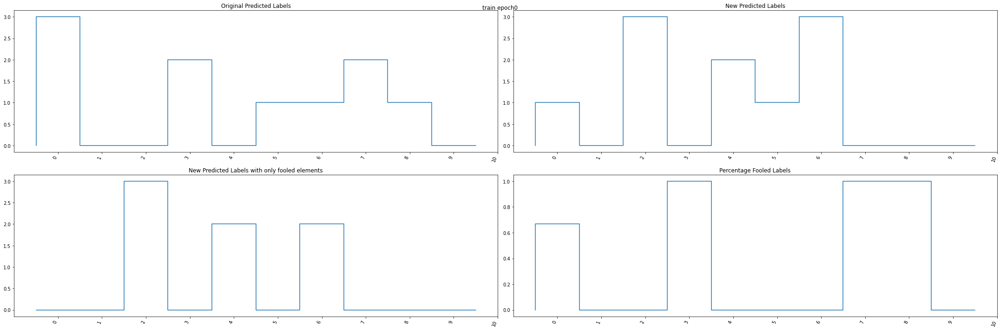

Test Fooling ratio 0: 100%|██████████| 1000/1000 [00:15<00:00, 64.92it/s]


test fooling ratio: tensor(0.4359)


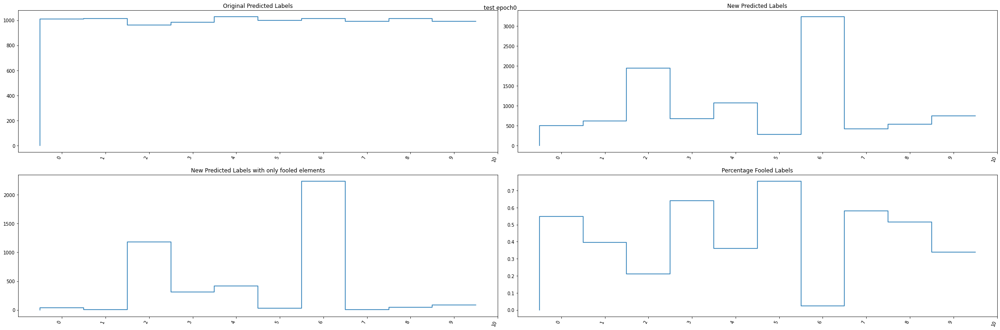

Iteration 1


Fooling ratio 1: 100%|██████████| 1/1 [00:00<00:00, 38.02it/s]


train fooling ratio: tensor(0.9000)


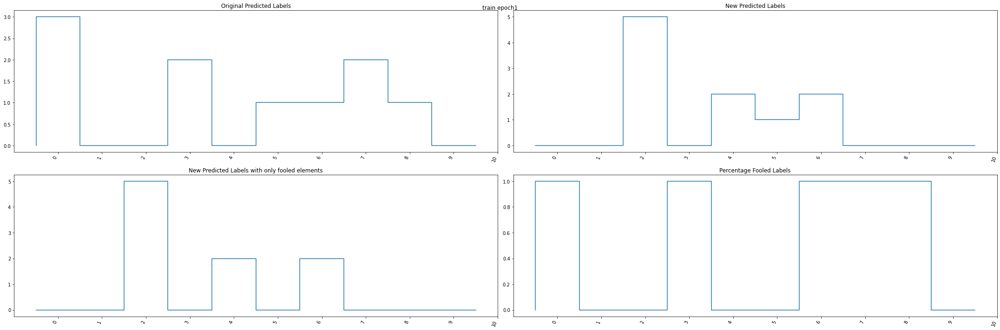

Test Fooling ratio 1: 100%|██████████| 1000/1000 [00:15<00:00, 65.64it/s]


test fooling ratio: tensor(0.4253)


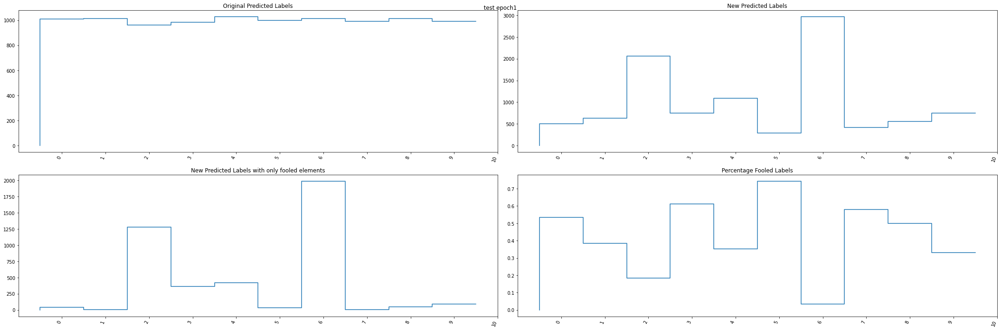

training fooling ratio: tensor(0.9000)
- data size: 50
Files already downloaded and verified
Files already downloaded and verified
Iteration 0


Fooling ratio 0: 100%|██████████| 5/5 [00:00<00:00, 54.89it/s]


train fooling ratio: tensor(0.4800)


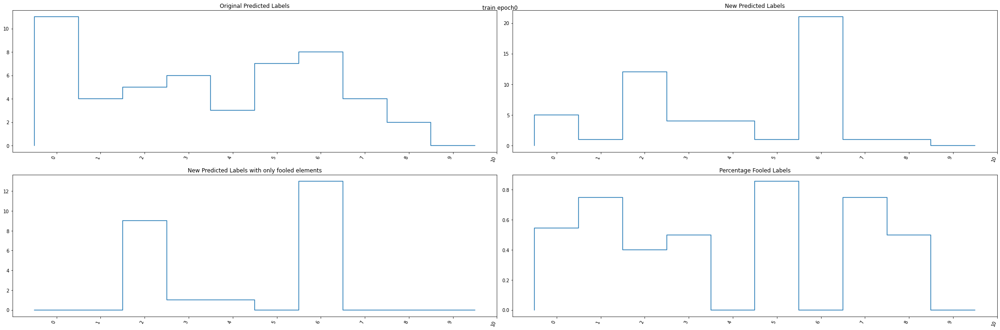

Test Fooling ratio 0: 100%|██████████| 1000/1000 [00:15<00:00, 63.16it/s]


test fooling ratio: tensor(0.5351)


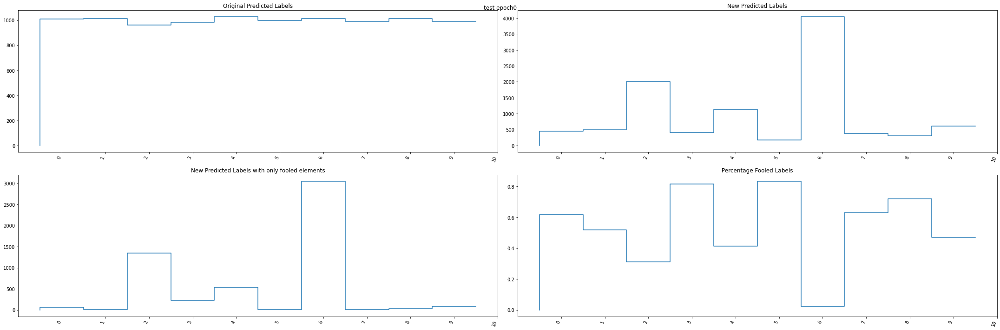

Iteration 1


Fooling ratio 1: 100%|██████████| 5/5 [00:00<00:00, 59.15it/s]


train fooling ratio: tensor(0.5400)


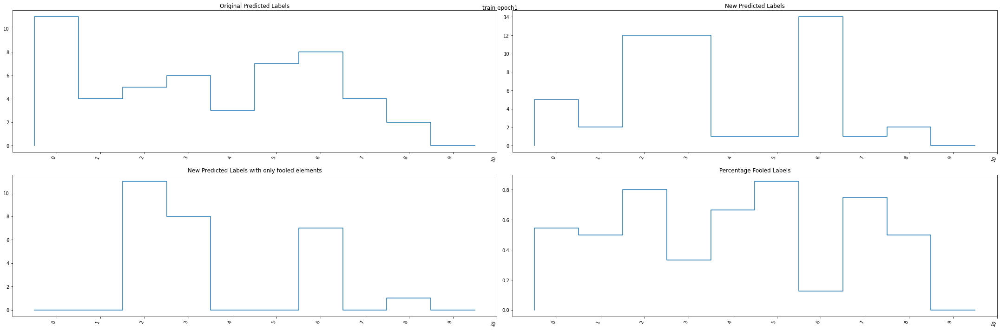

Test Fooling ratio 1: 100%|██████████| 1000/1000 [00:15<00:00, 62.96it/s]


test fooling ratio: tensor(0.4687)


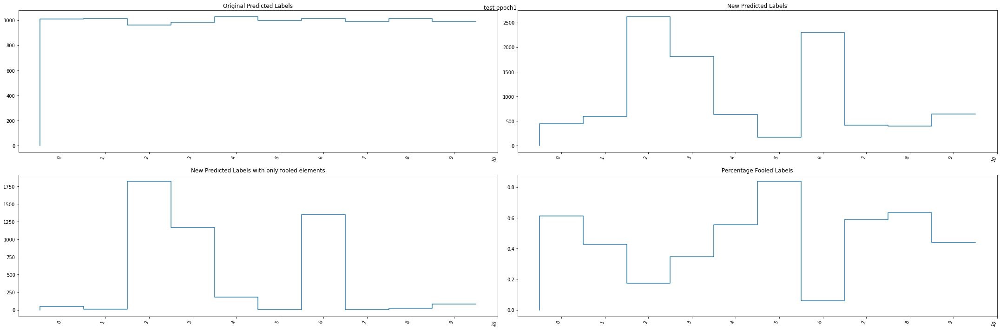

Iteration 2


Fooling ratio 2: 100%|██████████| 5/5 [00:00<00:00, 57.98it/s]


train fooling ratio: tensor(0.5200)


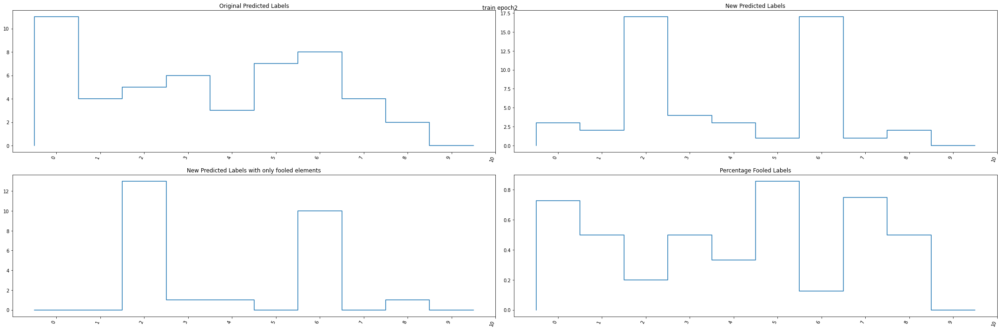

Test Fooling ratio 2: 100%|██████████| 1000/1000 [00:15<00:00, 62.80it/s]


test fooling ratio: tensor(0.5203)


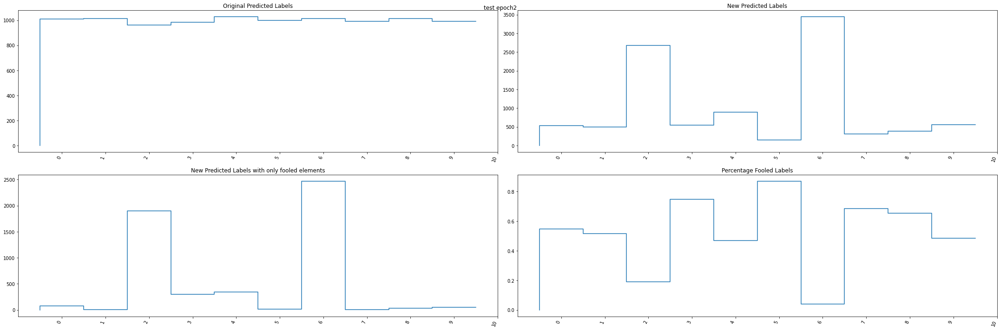

Iteration 3


Fooling ratio 3: 100%|██████████| 5/5 [00:00<00:00, 54.39it/s]


train fooling ratio: tensor(0.4800)


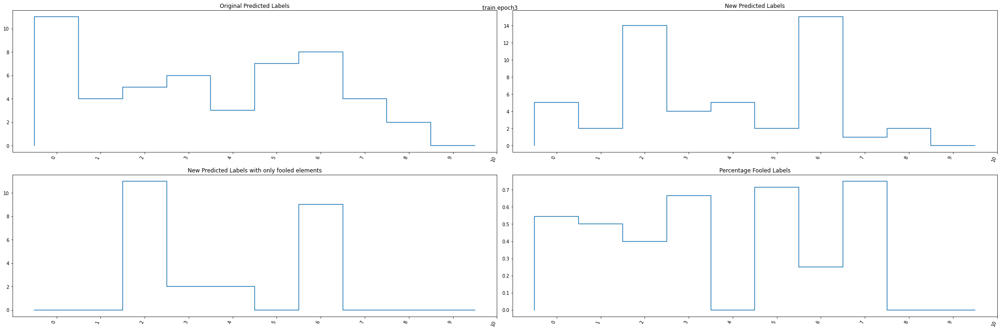

Test Fooling ratio 3: 100%|██████████| 1000/1000 [00:15<00:00, 62.96it/s]


test fooling ratio: tensor(0.4150)


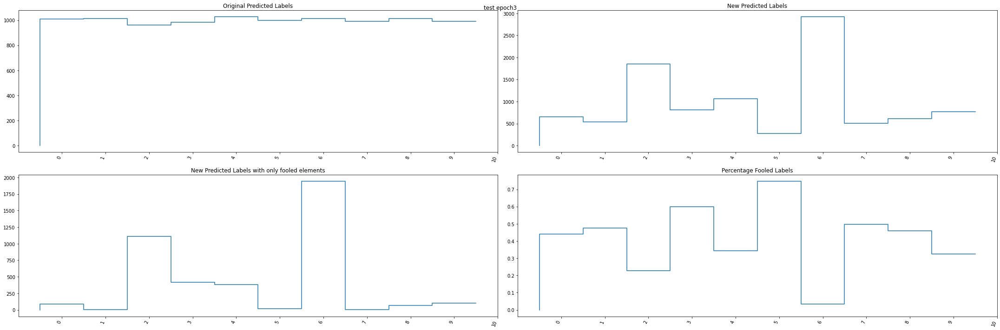

Iteration 4


Fooling ratio 4: 100%|██████████| 5/5 [00:00<00:00, 58.40it/s]


train fooling ratio: tensor(0.5000)


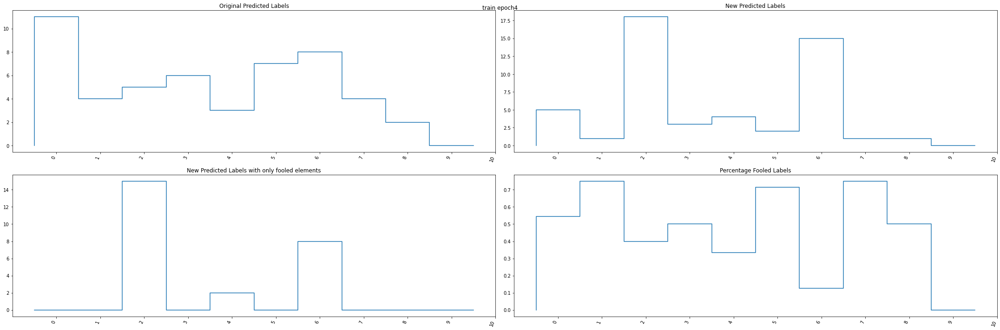

Test Fooling ratio 4: 100%|██████████| 1000/1000 [00:15<00:00, 62.78it/s]


test fooling ratio: tensor(0.4545)


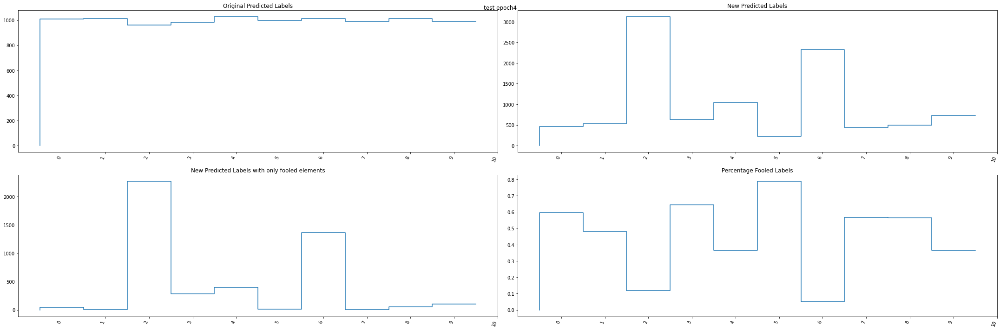

Iteration 5


Fooling ratio 5: 100%|██████████| 5/5 [00:00<00:00, 54.85it/s]


train fooling ratio: tensor(0.4000)


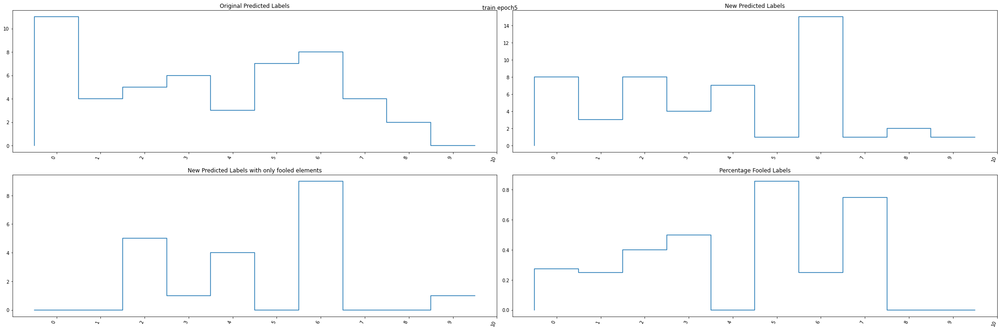

Test Fooling ratio 5: 100%|██████████| 1000/1000 [00:15<00:00, 62.67it/s]


test fooling ratio: tensor(0.3805)


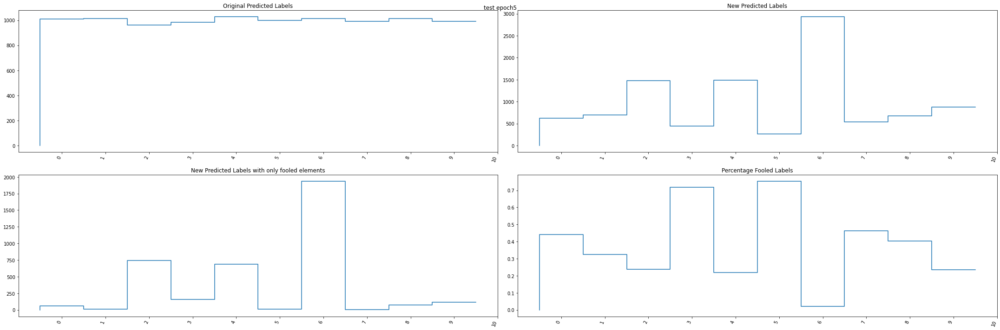

Iteration 6


Fooling ratio 6: 100%|██████████| 5/5 [00:00<00:00, 55.75it/s]


train fooling ratio: tensor(0.4800)


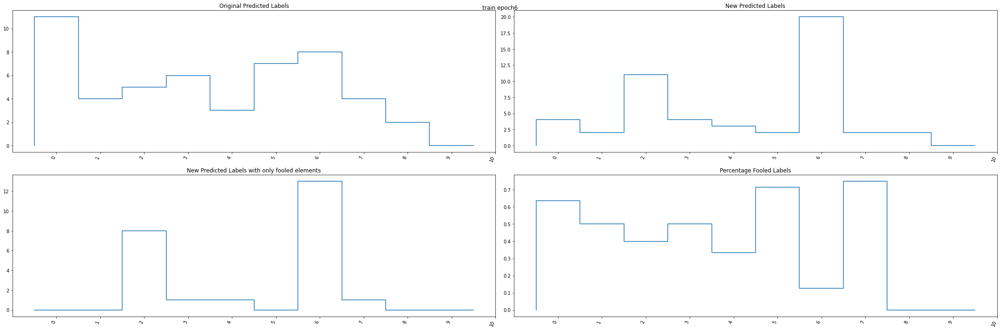

Test Fooling ratio 6: 100%|██████████| 1000/1000 [00:16<00:00, 62.22it/s]


test fooling ratio: tensor(0.4938)


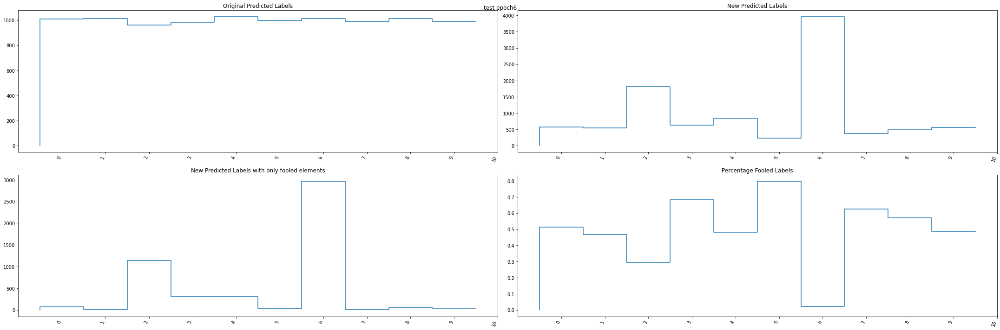

Iteration 7


Fooling ratio 7: 100%|██████████| 5/5 [00:00<00:00, 54.19it/s]


train fooling ratio: tensor(0.4800)


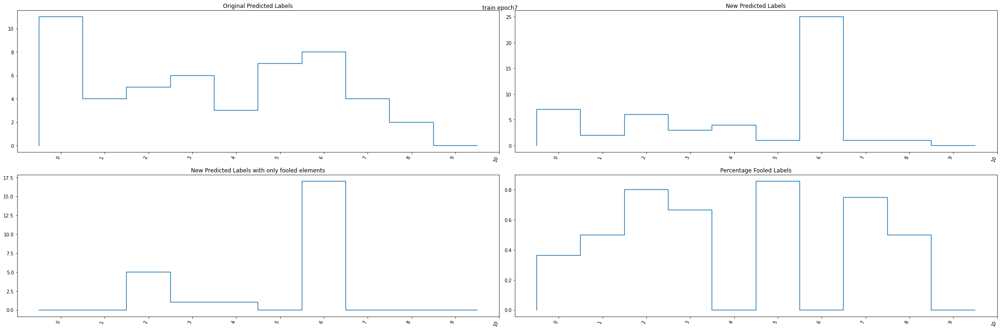

Test Fooling ratio 7: 100%|██████████| 1000/1000 [00:15<00:00, 62.78it/s]


test fooling ratio: tensor(0.4825)


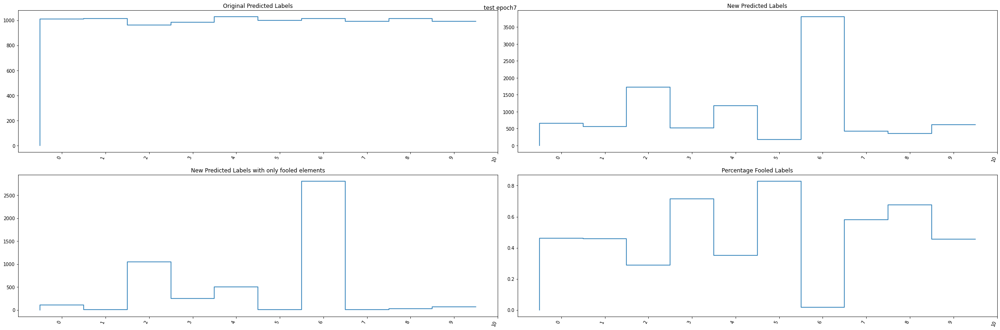

Iteration 8


Fooling ratio 8: 100%|██████████| 5/5 [00:00<00:00, 53.87it/s]


train fooling ratio: tensor(0.4000)


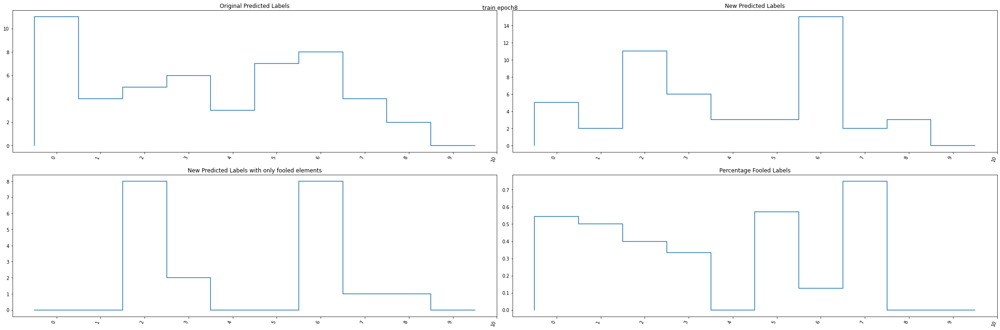

Test Fooling ratio 8: 100%|██████████| 1000/1000 [00:16<00:00, 62.24it/s]


test fooling ratio: tensor(0.3721)


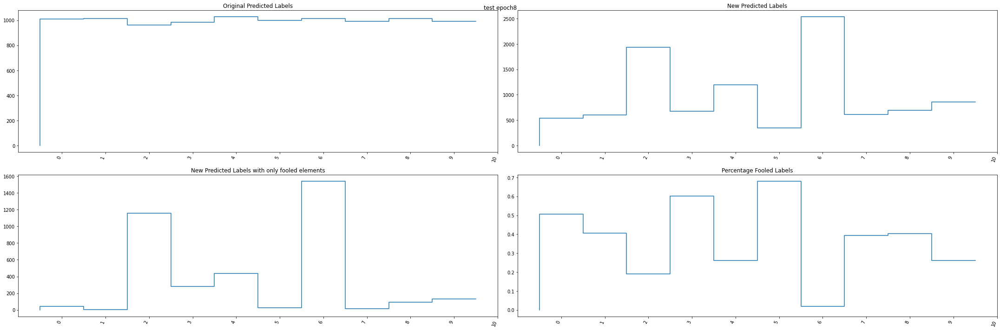

Iteration 9


Fooling ratio 9: 100%|██████████| 5/5 [00:00<00:00, 48.99it/s]


train fooling ratio: tensor(0.4000)


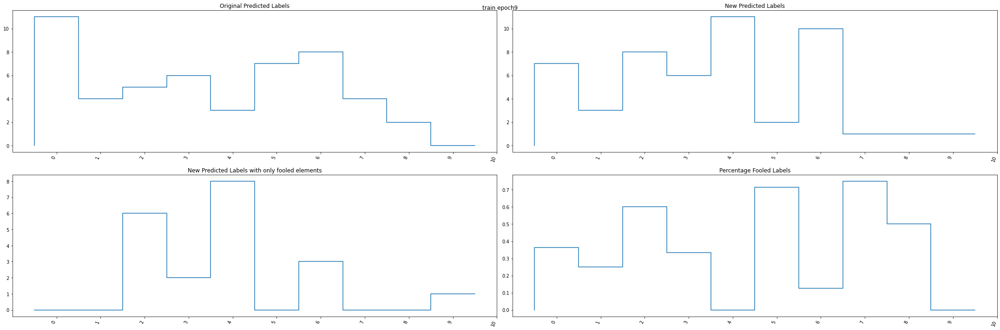

Test Fooling ratio 9: 100%|██████████| 1000/1000 [00:16<00:00, 62.27it/s]


test fooling ratio: tensor(0.3322)


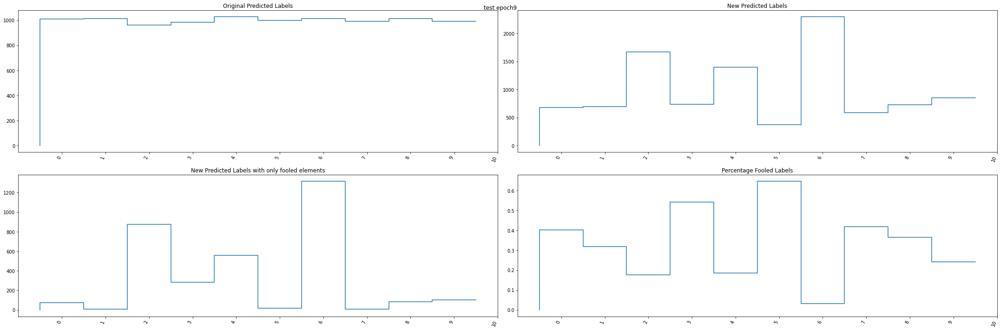

training fooling ratio: tensor(0.4000)
- data size: 100
Files already downloaded and verified
Files already downloaded and verified
Iteration 0


Fooling ratio 0: 100%|██████████| 10/10 [00:00<00:00, 51.61it/s]


train fooling ratio: tensor(0.4300)


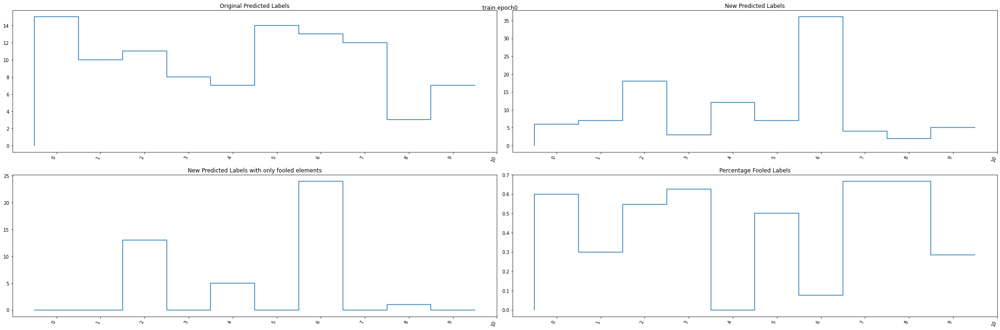

Test Fooling ratio 0: 100%|██████████| 1000/1000 [00:16<00:00, 62.47it/s]


test fooling ratio: tensor(0.4513)


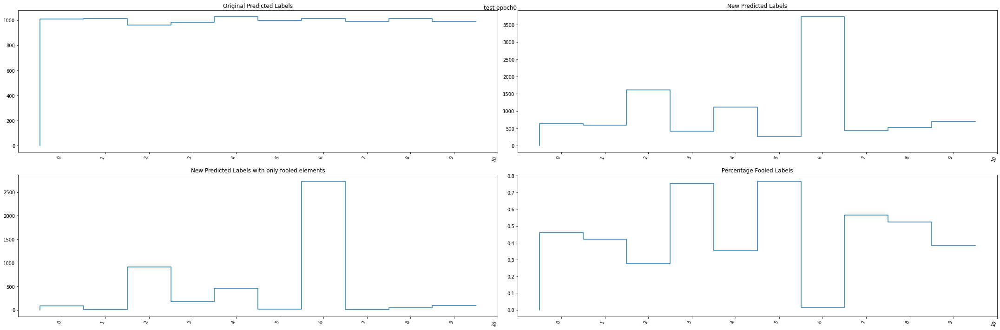

Iteration 1


Fooling ratio 1: 100%|██████████| 10/10 [00:00<00:00, 57.35it/s]


train fooling ratio: tensor(0.4700)


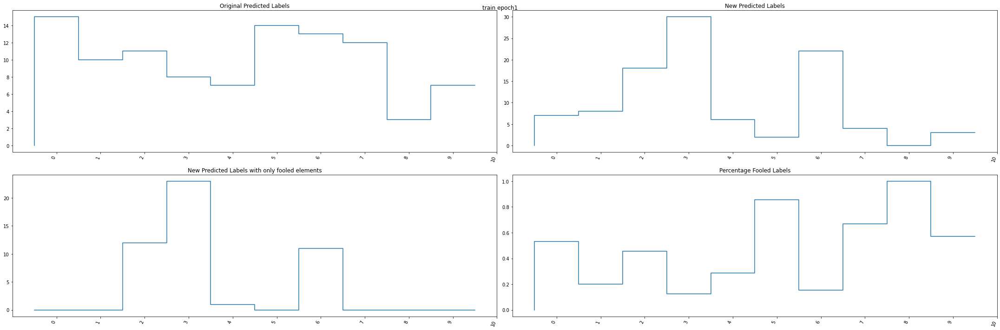

Test Fooling ratio 1: 100%|██████████| 1000/1000 [00:16<00:00, 62.23it/s]


test fooling ratio: tensor(0.4660)


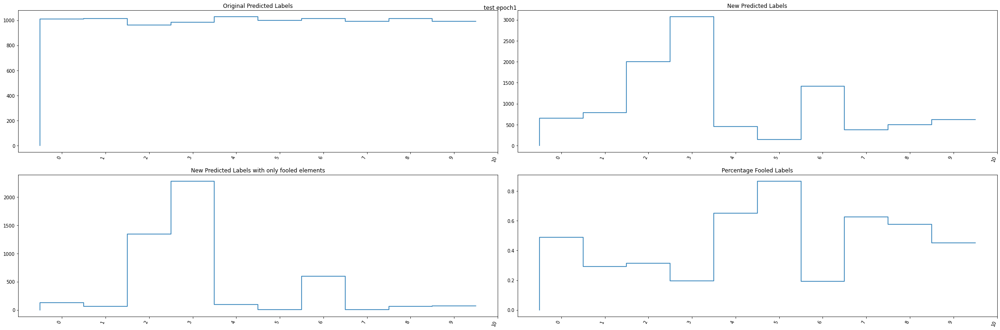

Iteration 2


Fooling ratio 2: 100%|██████████| 10/10 [00:00<00:00, 56.17it/s]


train fooling ratio: tensor(0.4000)


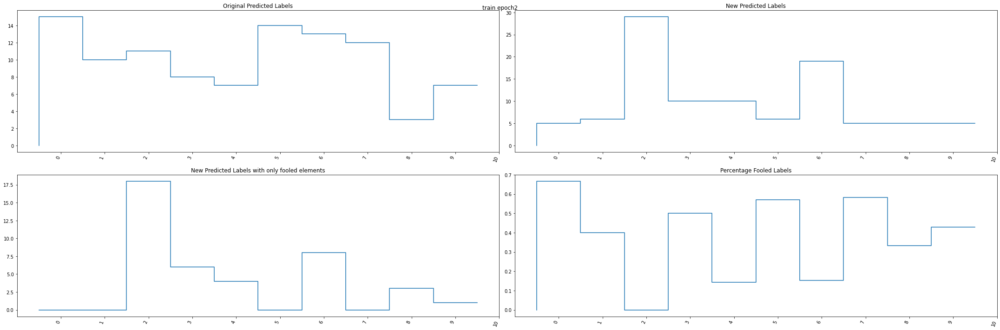

Test Fooling ratio 2: 100%|██████████| 1000/1000 [00:16<00:00, 61.40it/s]


test fooling ratio: tensor(0.3718)


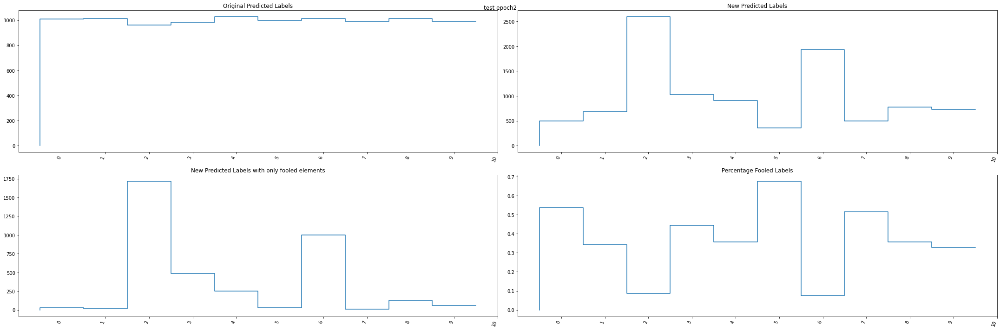

Iteration 3


Fooling ratio 3: 100%|██████████| 10/10 [00:00<00:00, 50.34it/s]


train fooling ratio: tensor(0.4000)


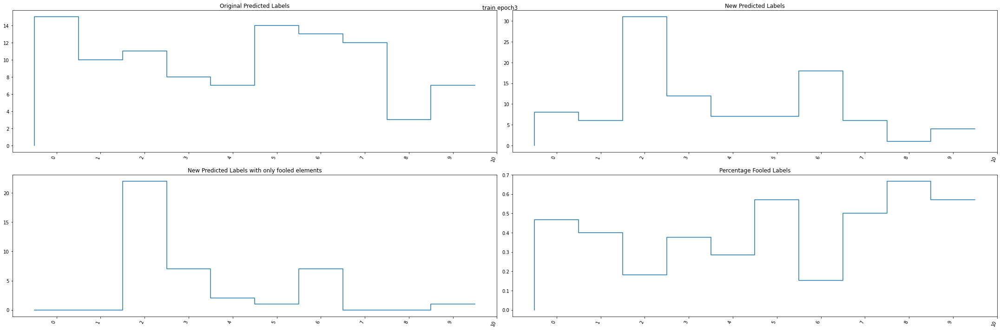

Test Fooling ratio 3: 100%|██████████| 1000/1000 [00:16<00:00, 61.25it/s]


test fooling ratio: tensor(0.3829)


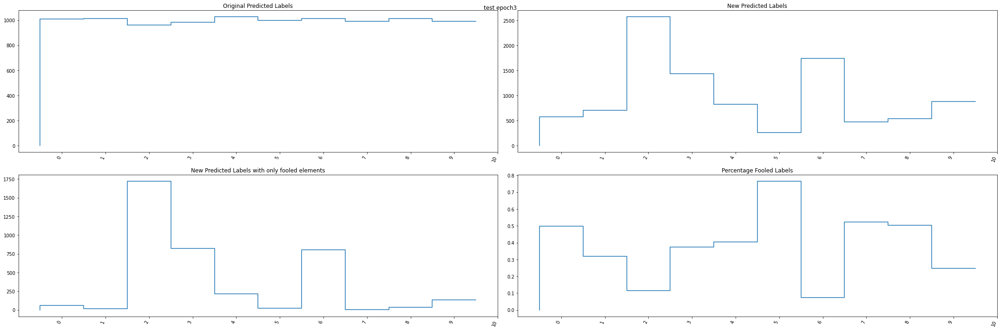

Iteration 4


Fooling ratio 4: 100%|██████████| 10/10 [00:00<00:00, 55.40it/s]


train fooling ratio: tensor(0.4100)


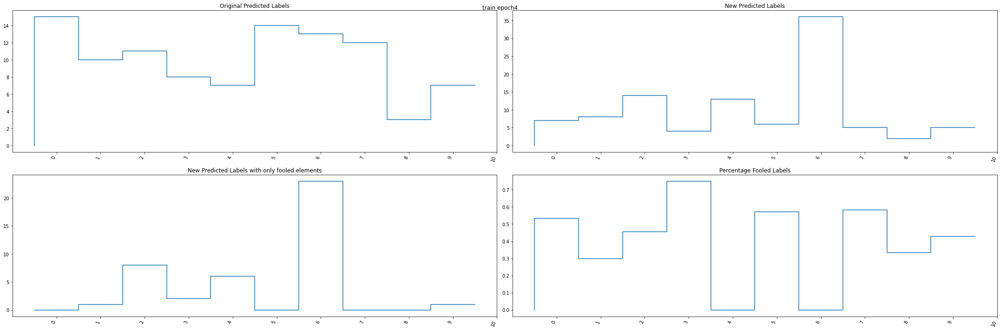

Test Fooling ratio 4: 100%|██████████| 1000/1000 [00:16<00:00, 61.63it/s]


test fooling ratio: tensor(0.4336)


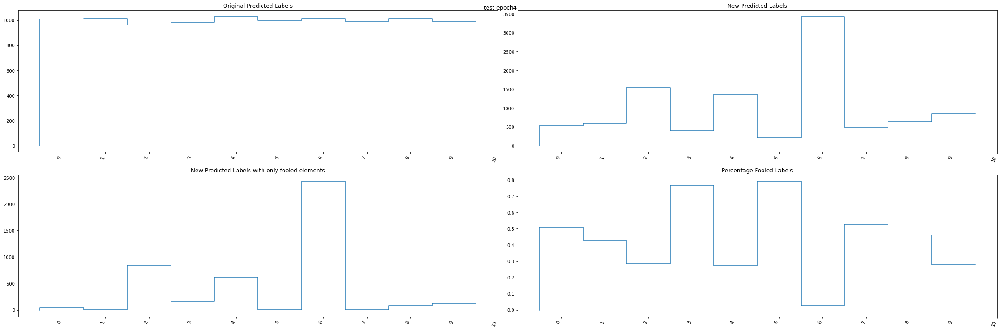

Iteration 5


Fooling ratio 5: 100%|██████████| 10/10 [00:00<00:00, 54.16it/s]


train fooling ratio: tensor(0.4100)


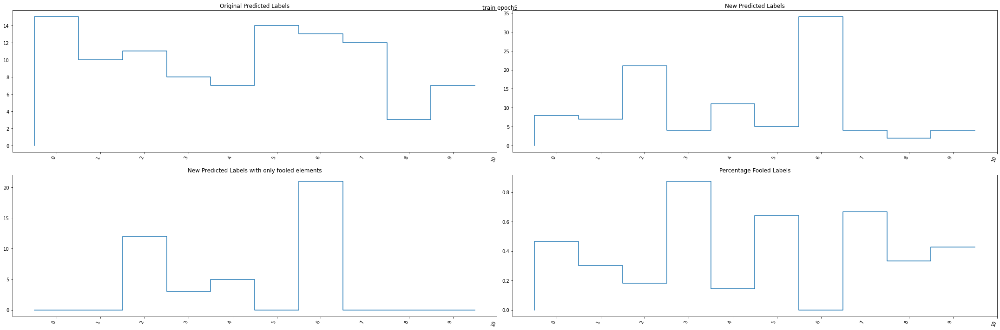

Test Fooling ratio 5: 100%|██████████| 1000/1000 [00:16<00:00, 61.02it/s]


test fooling ratio: tensor(0.4642)


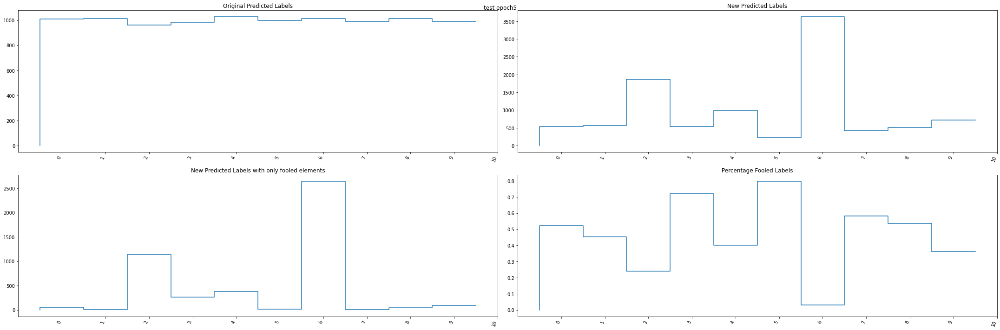

Iteration 6


Fooling ratio 6: 100%|██████████| 10/10 [00:00<00:00, 47.10it/s]


train fooling ratio: tensor(0.4000)


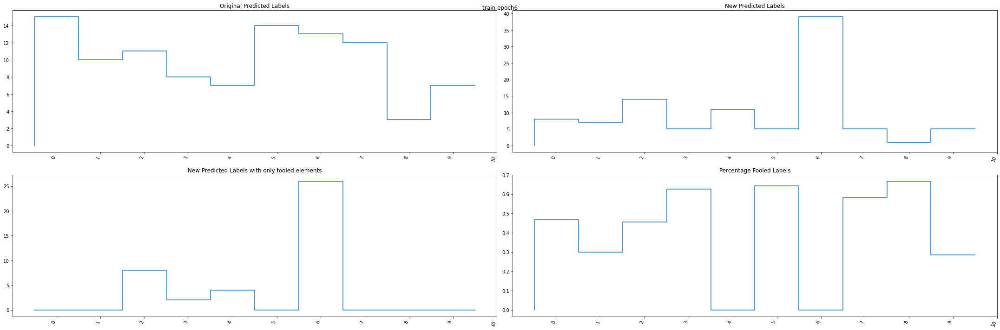

Test Fooling ratio 6: 100%|██████████| 1000/1000 [00:16<00:00, 61.17it/s]


test fooling ratio: tensor(0.4624)


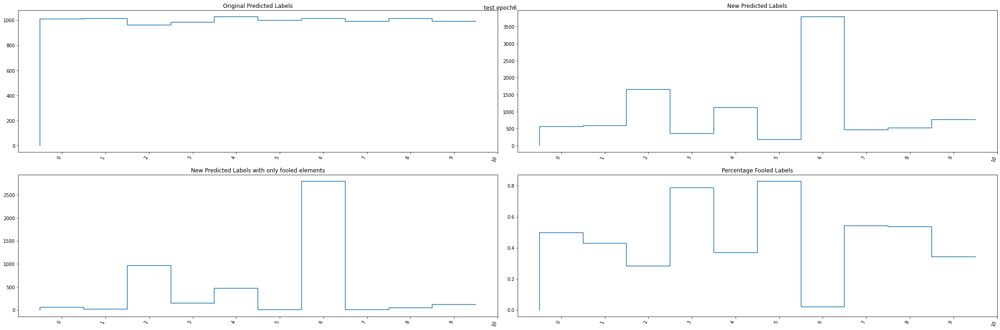

Iteration 7


Fooling ratio 7: 100%|██████████| 10/10 [00:00<00:00, 52.74it/s]


train fooling ratio: tensor(0.4100)


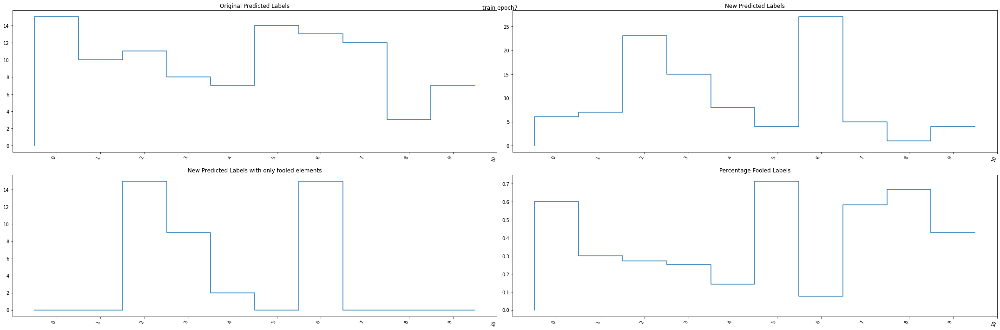

Test Fooling ratio 7: 100%|██████████| 1000/1000 [00:16<00:00, 60.68it/s]


test fooling ratio: tensor(0.4056)


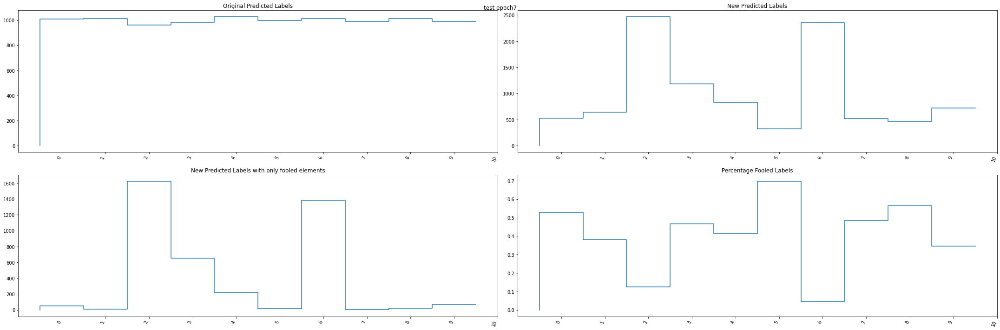

Iteration 8


Fooling ratio 8: 100%|██████████| 10/10 [00:00<00:00, 54.77it/s]


train fooling ratio: tensor(0.4600)


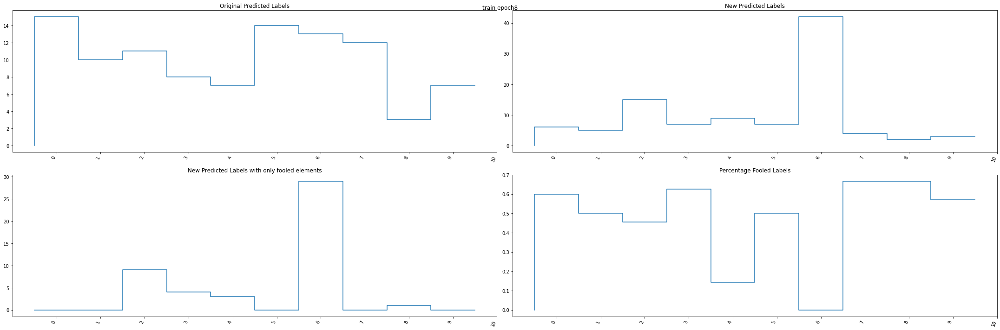

Test Fooling ratio 8: 100%|██████████| 1000/1000 [00:16<00:00, 61.05it/s]


test fooling ratio: tensor(0.4893)


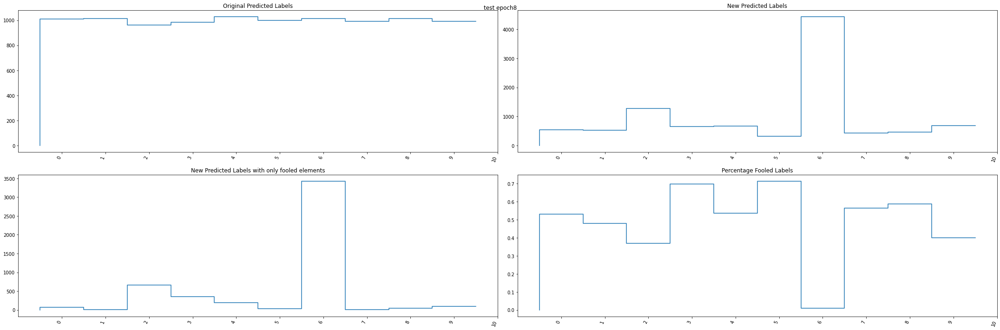

Iteration 9


Fooling ratio 9: 100%|██████████| 10/10 [00:00<00:00, 53.98it/s]


train fooling ratio: tensor(0.4200)


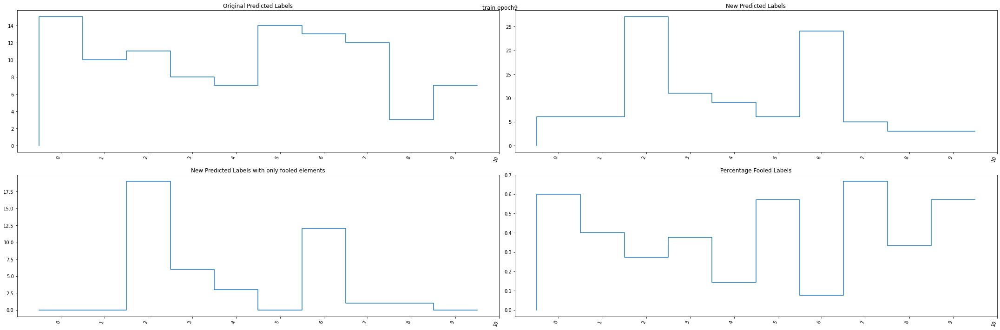

Test Fooling ratio 9: 100%|██████████| 1000/1000 [00:16<00:00, 59.49it/s]


test fooling ratio: tensor(0.3987)


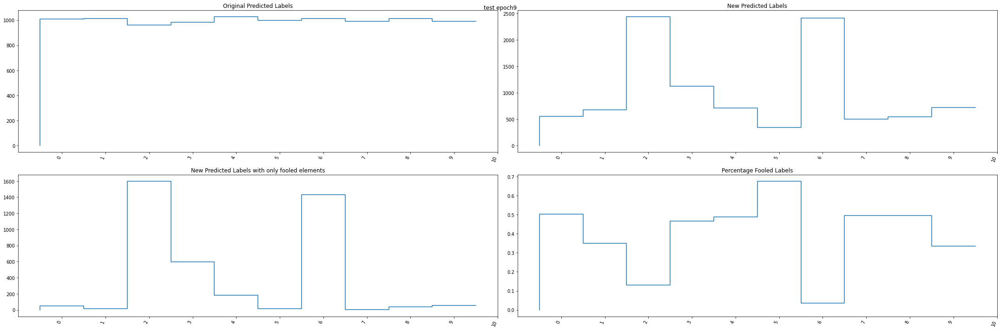

training fooling ratio: tensor(0.4200)
- data size: 500
Files already downloaded and verified
Files already downloaded and verified
Iteration 0


Fooling ratio 0: 100%|██████████| 50/50 [00:00<00:00, 58.62it/s]


train fooling ratio: tensor(0.4400)


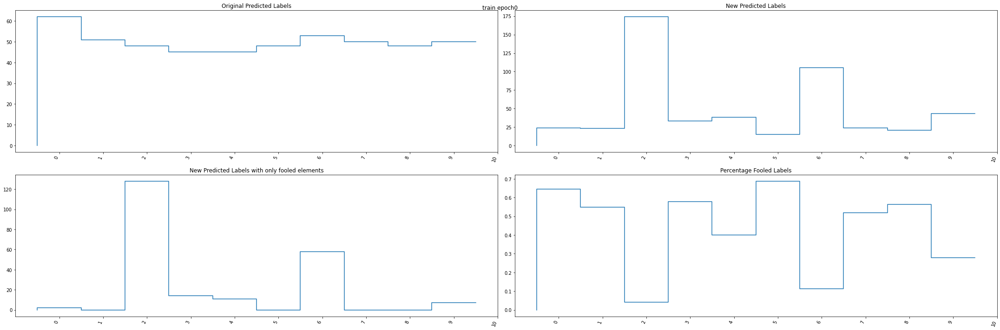

Test Fooling ratio 0: 100%|██████████| 1000/1000 [00:16<00:00, 59.59it/s]


test fooling ratio: tensor(0.4955)


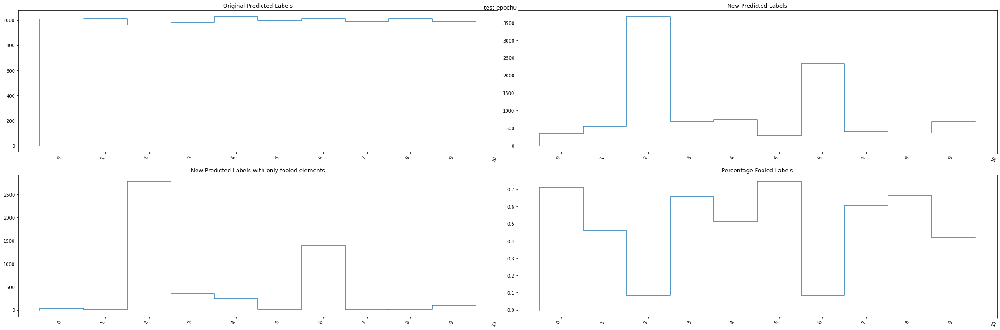

Iteration 1


Fooling ratio 1: 100%|██████████| 50/50 [00:00<00:00, 57.33it/s]


train fooling ratio: tensor(0.5820)


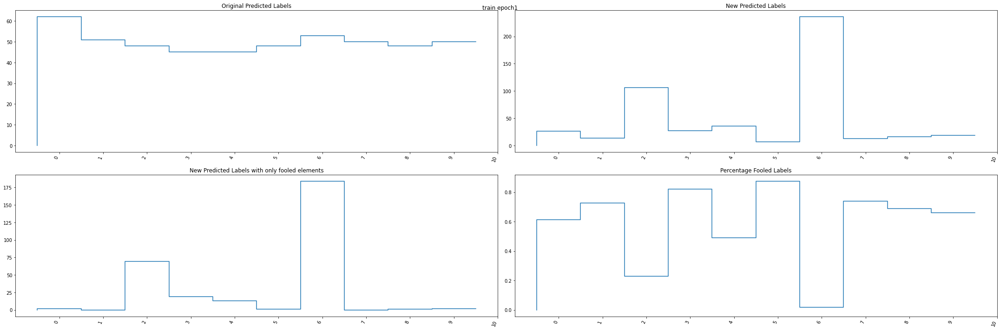

Test Fooling ratio 1: 100%|██████████| 1000/1000 [00:16<00:00, 59.71it/s]


test fooling ratio: tensor(0.6157)


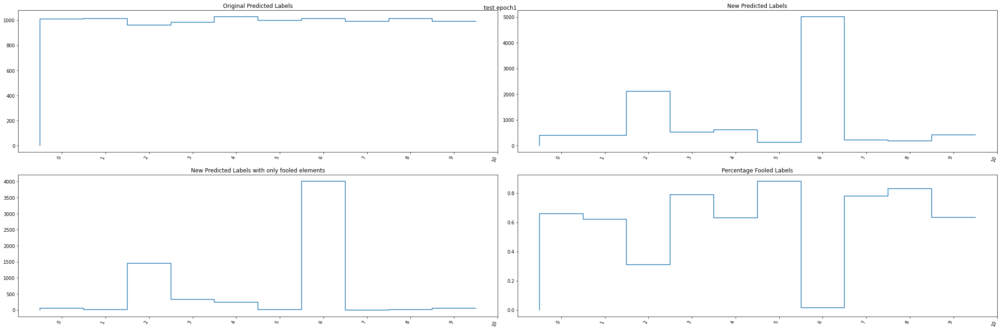

Iteration 2


Fooling ratio 2: 100%|██████████| 50/50 [00:00<00:00, 56.07it/s]


train fooling ratio: tensor(0.4880)


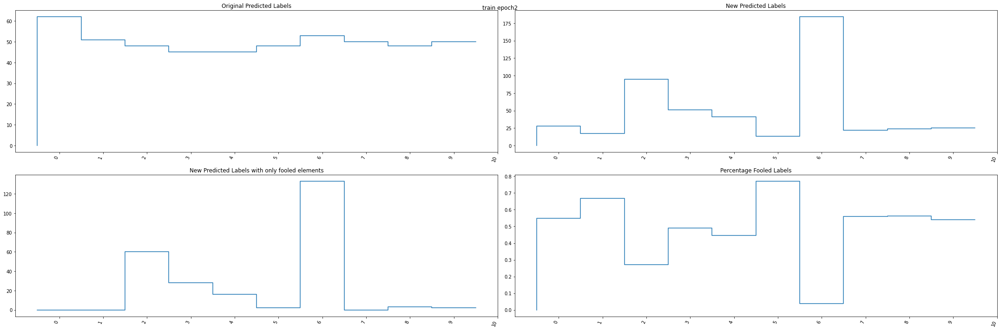

Test Fooling ratio 2: 100%|██████████| 1000/1000 [00:16<00:00, 59.03it/s]


test fooling ratio: tensor(0.5173)


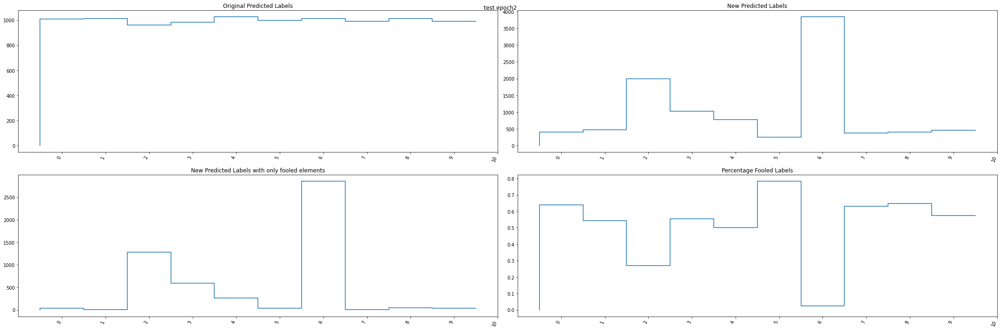

Iteration 3


Fooling ratio 3: 100%|██████████| 50/50 [00:00<00:00, 57.97it/s]


train fooling ratio: tensor(0.4020)


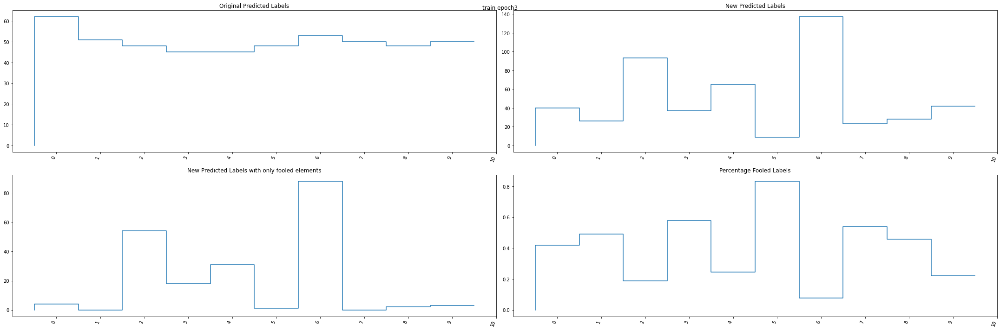

Test Fooling ratio 3: 100%|██████████| 1000/1000 [00:16<00:00, 60.11it/s]


test fooling ratio: tensor(0.4400)


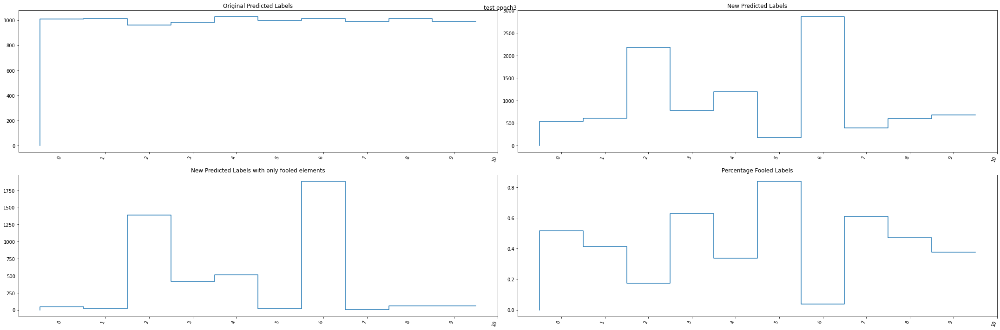

Iteration 4


Fooling ratio 4: 100%|██████████| 50/50 [00:00<00:00, 58.06it/s]


train fooling ratio: tensor(0.4920)


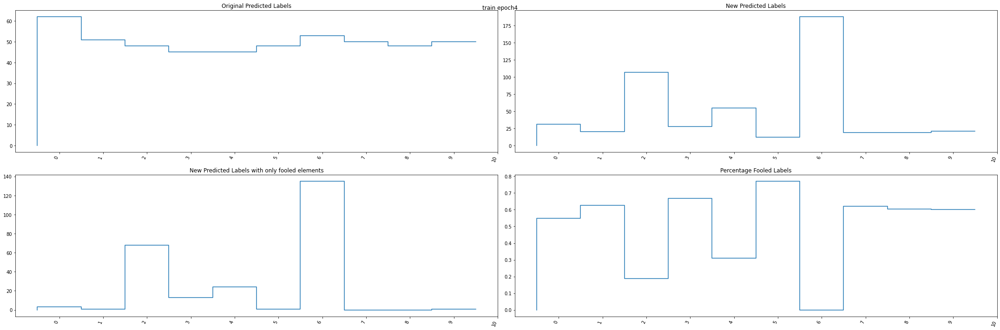

Test Fooling ratio 4: 100%|██████████| 1000/1000 [00:16<00:00, 60.68it/s]


test fooling ratio: tensor(0.5427)


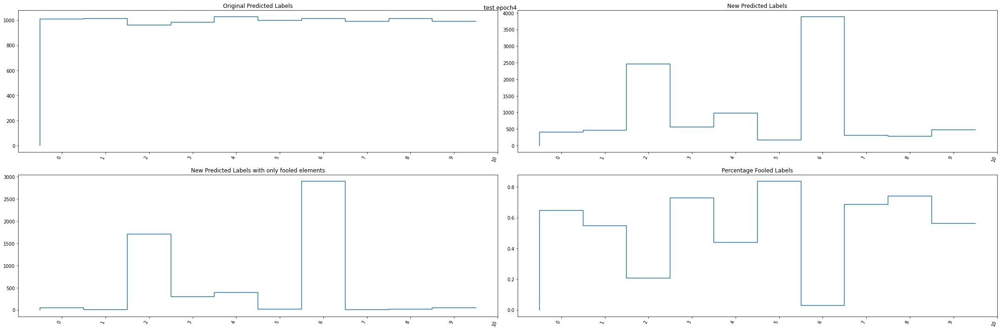

Iteration 5


Fooling ratio 5: 100%|██████████| 50/50 [00:00<00:00, 55.67it/s]


train fooling ratio: tensor(0.5240)


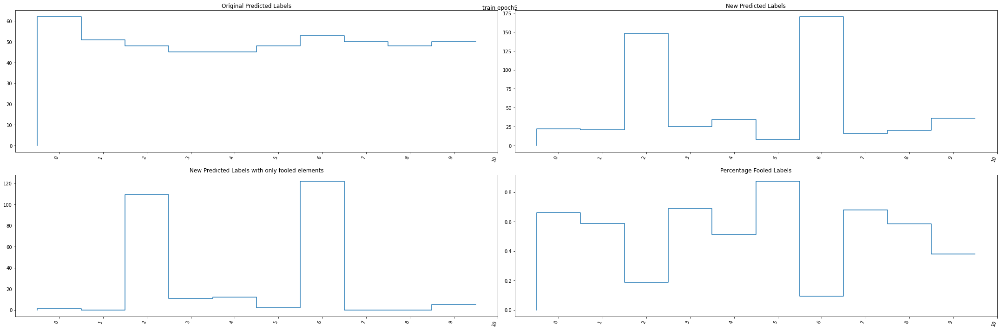

Test Fooling ratio 5: 100%|██████████| 1000/1000 [00:16<00:00, 59.58it/s]


test fooling ratio: tensor(0.5373)


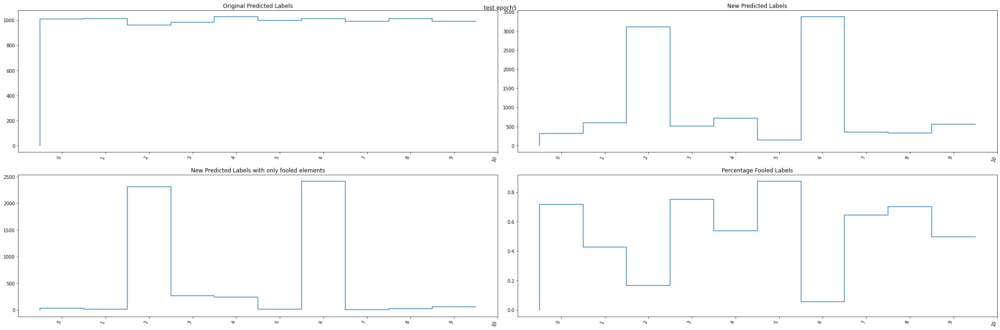

Iteration 6


Fooling ratio 6: 100%|██████████| 50/50 [00:00<00:00, 54.79it/s]


train fooling ratio: tensor(0.4000)


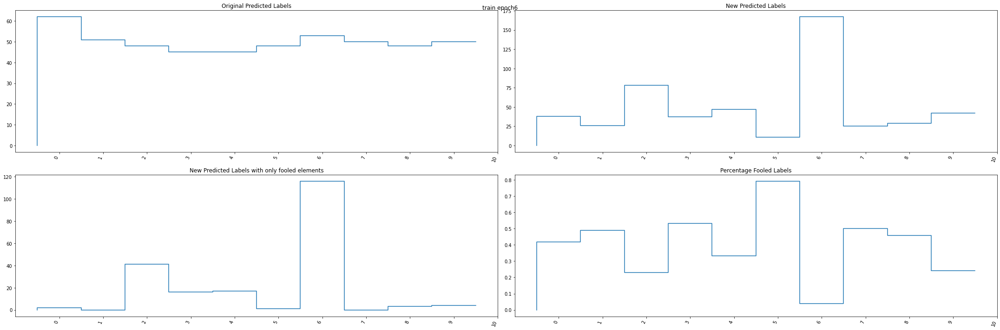

Test Fooling ratio 6: 100%|██████████| 1000/1000 [00:16<00:00, 59.53it/s]


test fooling ratio: tensor(0.4227)


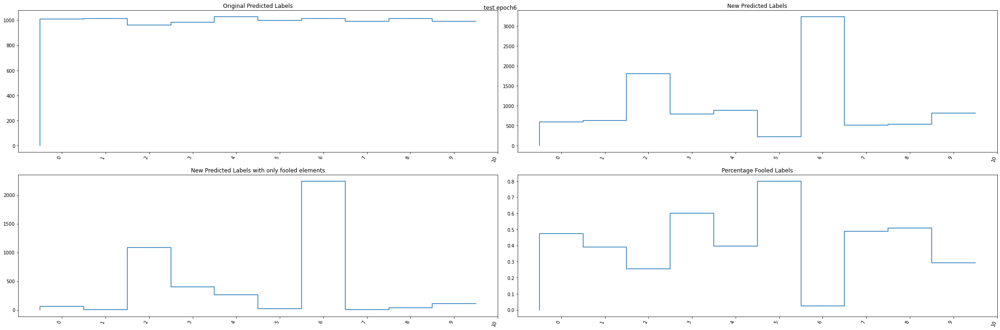

Iteration 7


Fooling ratio 7: 100%|██████████| 50/50 [00:00<00:00, 55.98it/s]


train fooling ratio: tensor(0.4540)


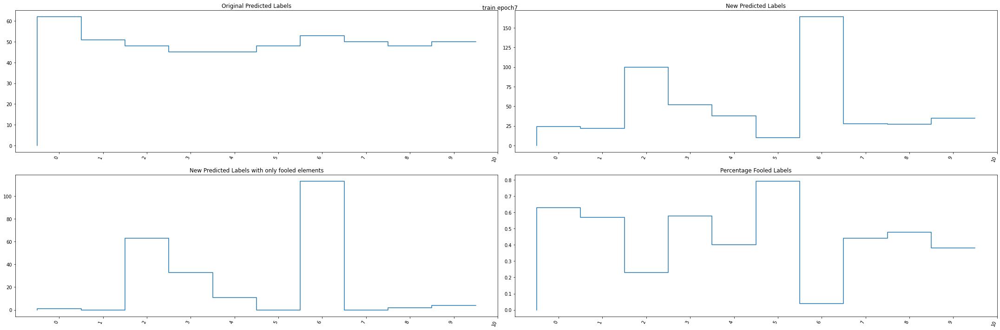

Test Fooling ratio 7: 100%|██████████| 1000/1000 [00:16<00:00, 58.90it/s]


test fooling ratio: tensor(0.4921)


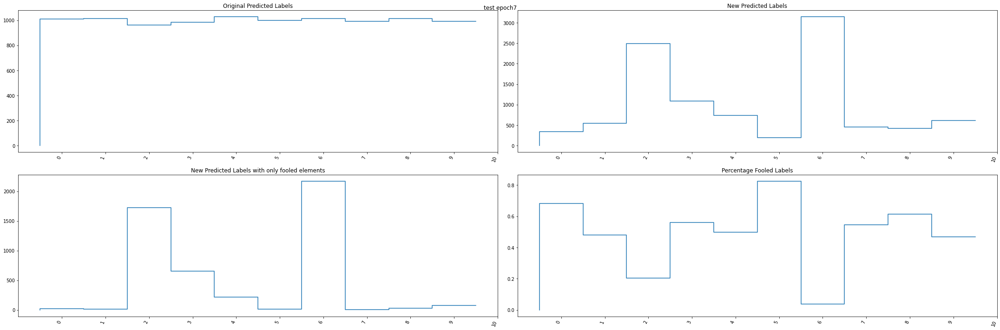

Iteration 8


Fooling ratio 8: 100%|██████████| 50/50 [00:00<00:00, 53.96it/s]


train fooling ratio: tensor(0.5020)


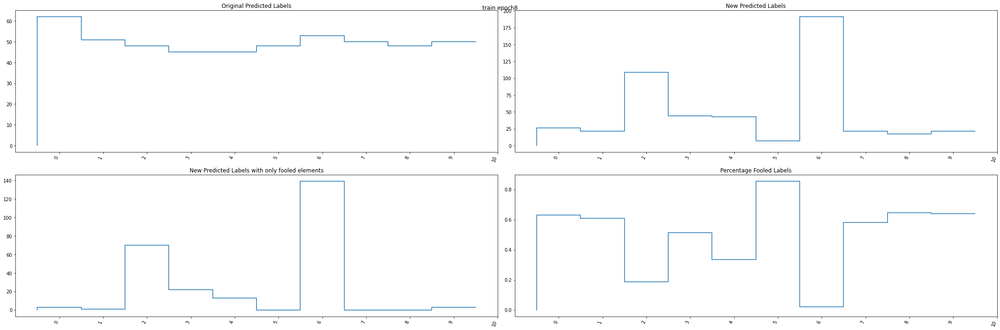

Test Fooling ratio 8: 100%|██████████| 1000/1000 [00:16<00:00, 59.23it/s]


test fooling ratio: tensor(0.5633)


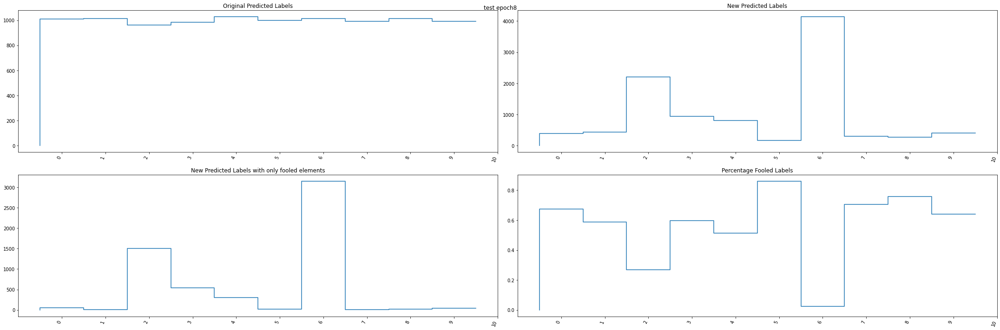

Iteration 9


Fooling ratio 9: 100%|██████████| 50/50 [00:00<00:00, 56.31it/s]


train fooling ratio: tensor(0.4900)


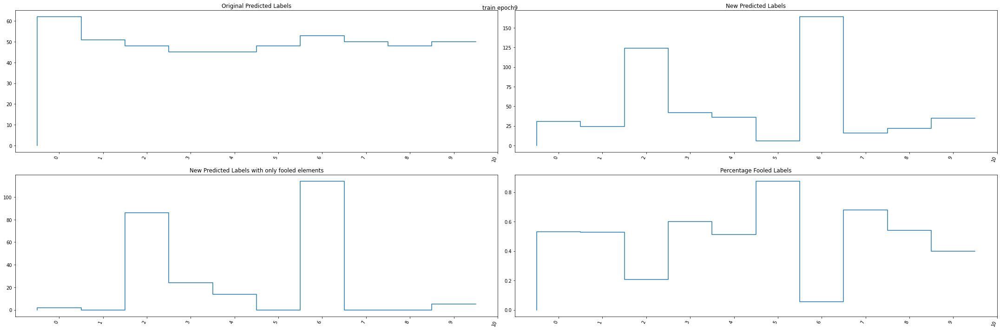

Test Fooling ratio 9: 100%|██████████| 1000/1000 [00:16<00:00, 59.38it/s]


test fooling ratio: tensor(0.5219)


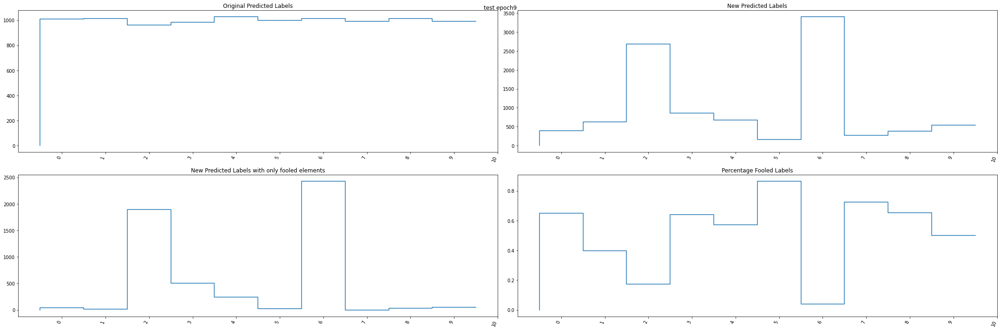

training fooling ratio: tensor(0.4900)
- data size: 1000
Files already downloaded and verified
Files already downloaded and verified
Iteration 0


Fooling ratio 0: 100%|██████████| 100/100 [00:01<00:00, 57.24it/s]


train fooling ratio: tensor(0.4020)


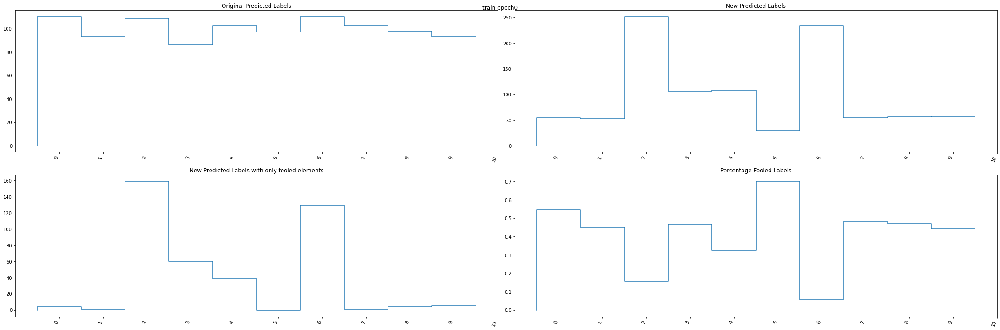

Test Fooling ratio 0: 100%|██████████| 1000/1000 [00:16<00:00, 59.60it/s]


test fooling ratio: tensor(0.4051)


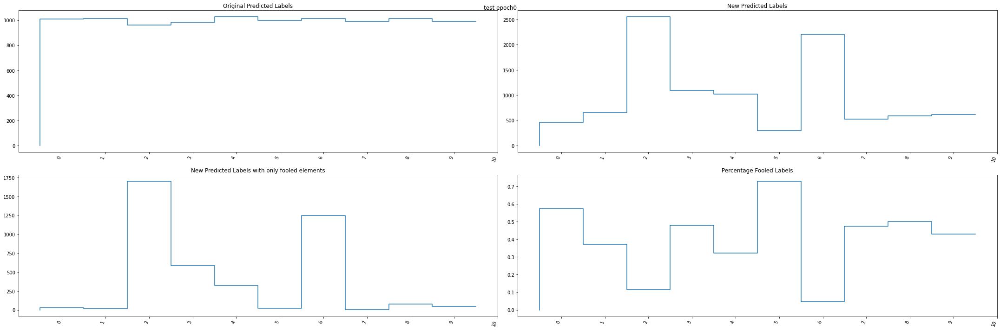

Iteration 1


Fooling ratio 1: 100%|██████████| 100/100 [00:01<00:00, 58.58it/s]


train fooling ratio: tensor(0.5370)


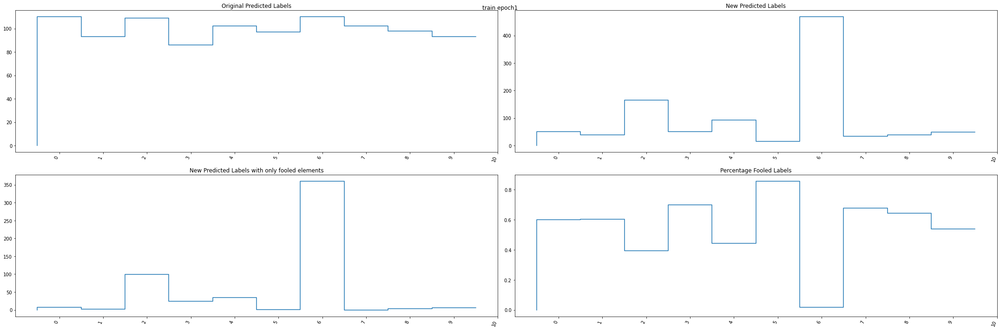

Test Fooling ratio 1: 100%|██████████| 1000/1000 [00:16<00:00, 59.92it/s]


test fooling ratio: tensor(0.5496)


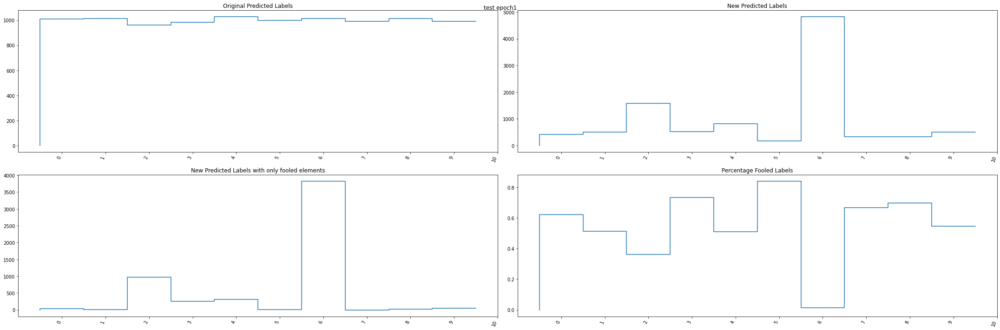

Iteration 2


Fooling ratio 2: 100%|██████████| 100/100 [00:01<00:00, 58.47it/s]


train fooling ratio: tensor(0.4350)


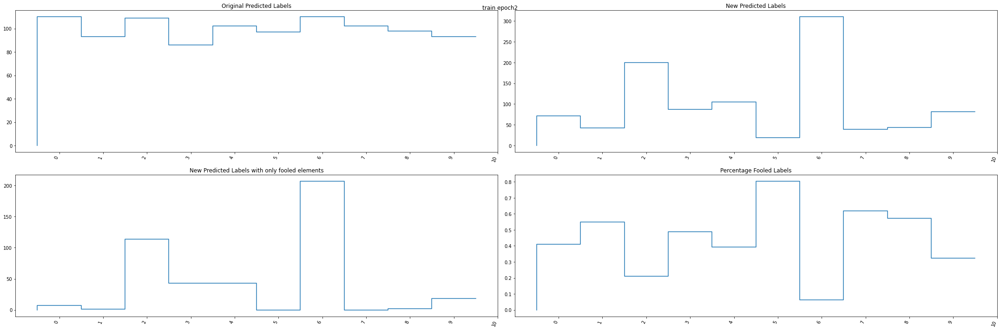

Test Fooling ratio 2: 100%|██████████| 1000/1000 [00:16<00:00, 59.86it/s]


test fooling ratio: tensor(0.4775)


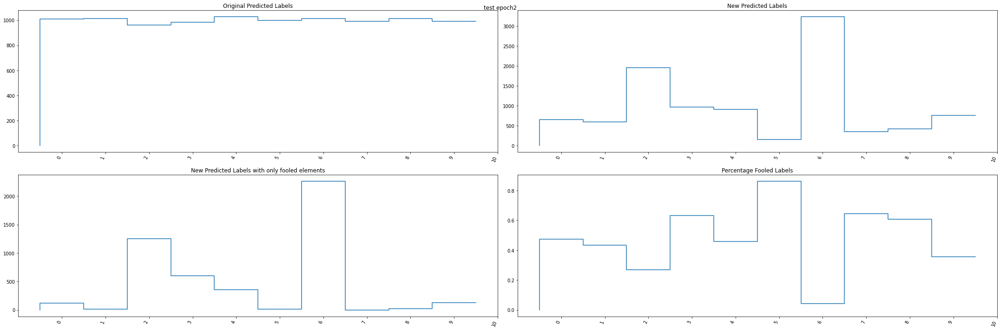

Iteration 3


Fooling ratio 3: 100%|██████████| 100/100 [00:01<00:00, 57.87it/s]


train fooling ratio: tensor(0.4250)


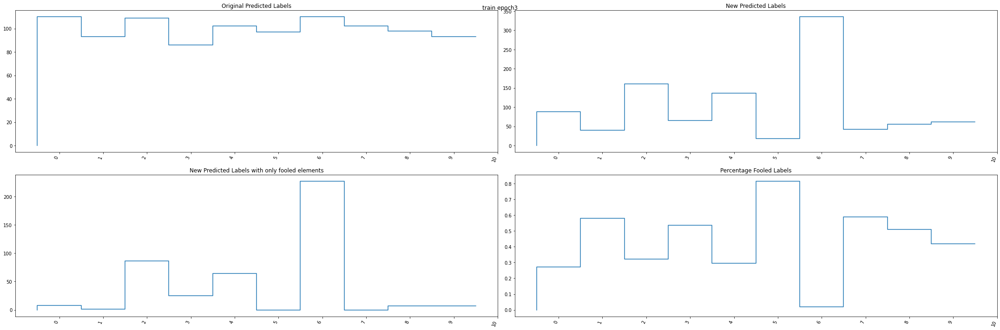

Test Fooling ratio 3: 100%|██████████| 1000/1000 [00:16<00:00, 60.02it/s]


test fooling ratio: tensor(0.4381)


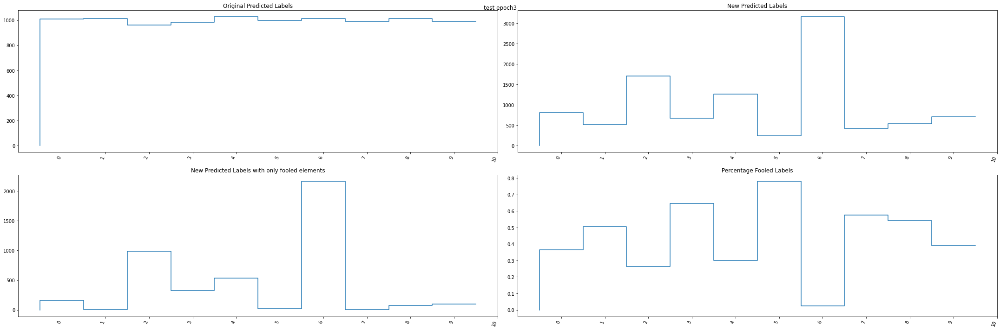

Iteration 4


Fooling ratio 4: 100%|██████████| 100/100 [00:01<00:00, 58.89it/s]


train fooling ratio: tensor(0.4390)


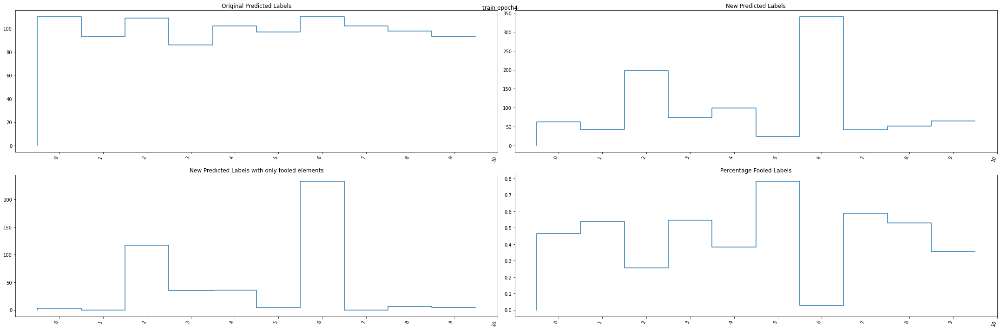

Test Fooling ratio 4: 100%|██████████| 1000/1000 [00:16<00:00, 58.92it/s]


test fooling ratio: tensor(0.4465)


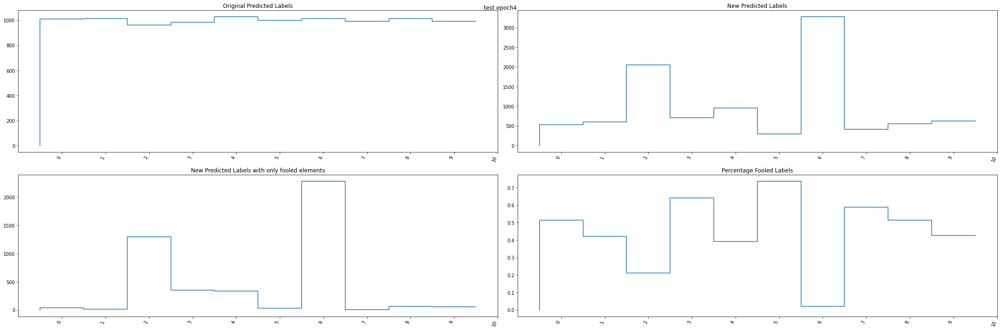

Iteration 5


Fooling ratio 5: 100%|██████████| 100/100 [00:01<00:00, 57.94it/s]


train fooling ratio: tensor(0.5110)


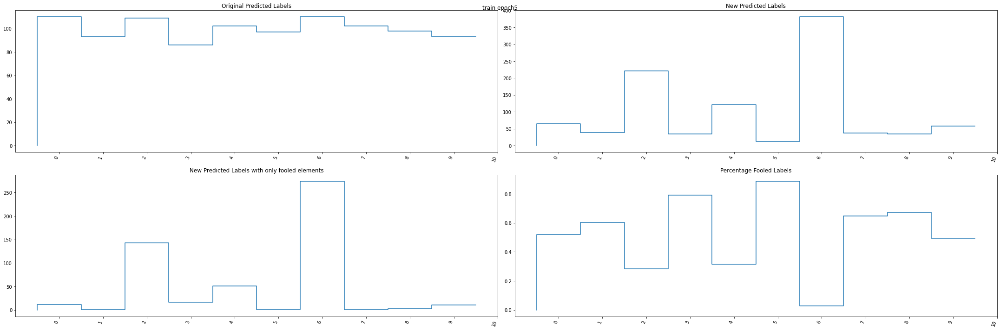

Test Fooling ratio 5: 100%|██████████| 1000/1000 [00:17<00:00, 58.21it/s]


test fooling ratio: tensor(0.5427)


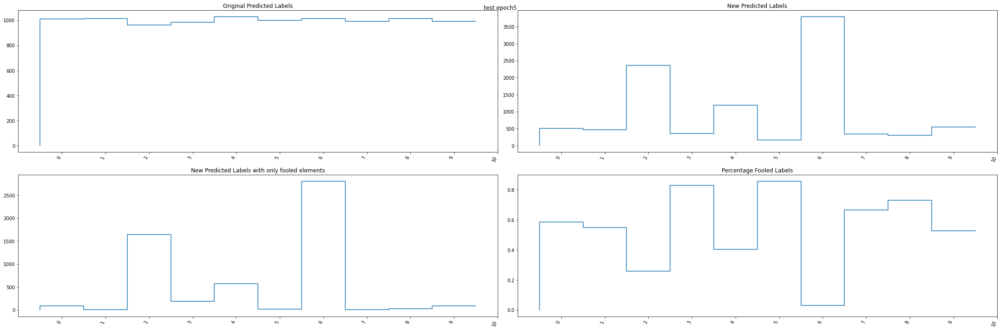

Iteration 6


Fooling ratio 6: 100%|██████████| 100/100 [00:01<00:00, 59.86it/s]


train fooling ratio: tensor(0.5260)


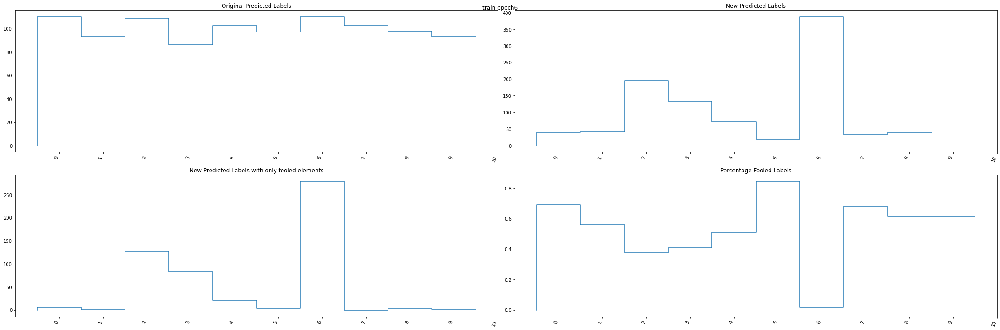

Test Fooling ratio 6: 100%|██████████| 1000/1000 [00:16<00:00, 61.24it/s]


test fooling ratio: tensor(0.5389)


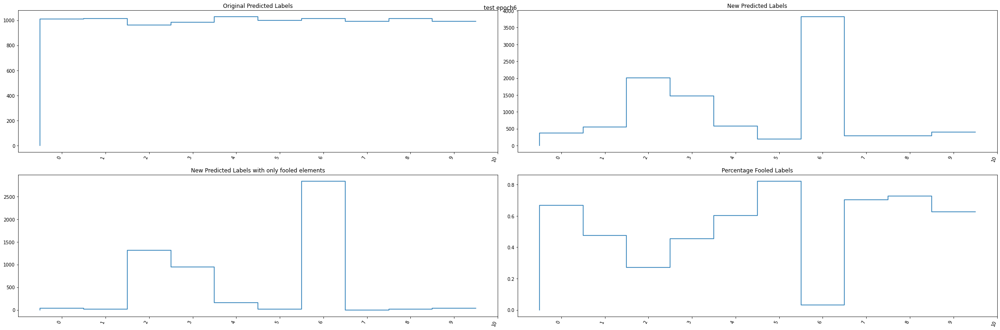

Iteration 7


Fooling ratio 7: 100%|██████████| 100/100 [00:01<00:00, 59.75it/s]


train fooling ratio: tensor(0.4970)


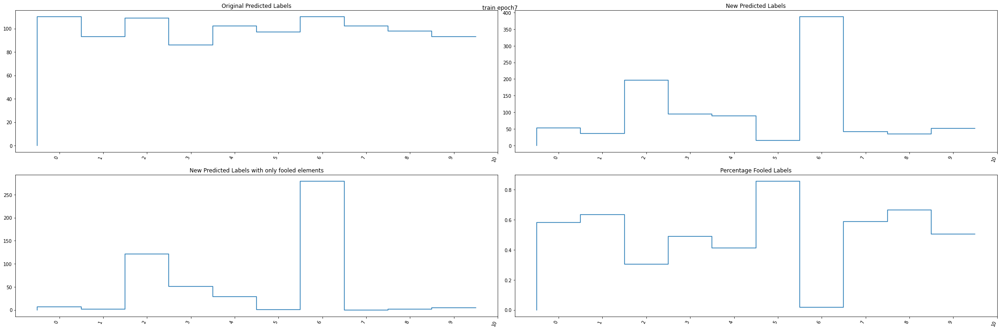

Test Fooling ratio 7: 100%|██████████| 1000/1000 [00:16<00:00, 60.69it/s]


test fooling ratio: tensor(0.5252)


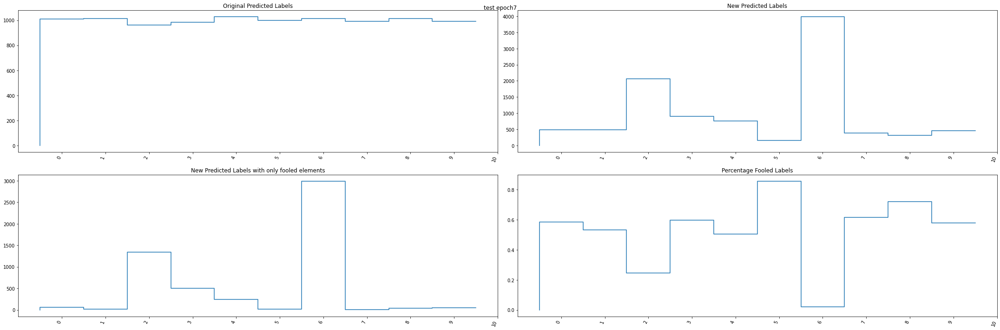

Iteration 8


Fooling ratio 8: 100%|██████████| 100/100 [00:01<00:00, 58.25it/s]


train fooling ratio: tensor(0.4350)


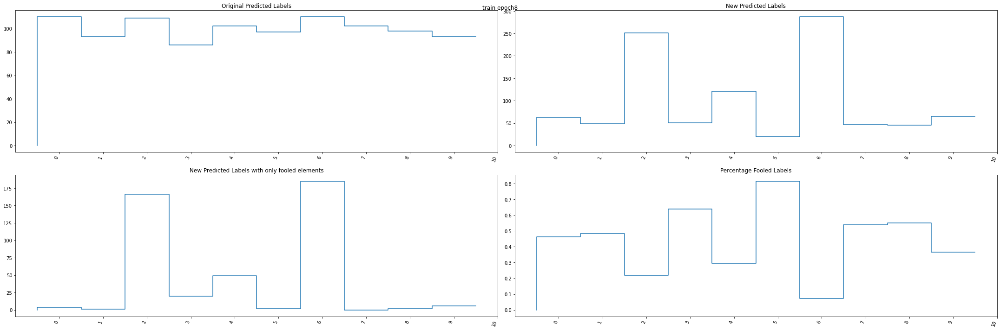

Test Fooling ratio 8: 100%|██████████| 1000/1000 [00:16<00:00, 60.33it/s]


test fooling ratio: tensor(0.4610)


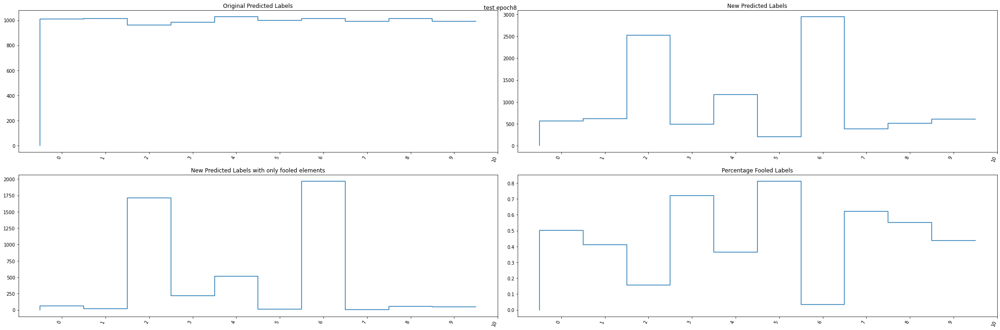

Iteration 9


Fooling ratio 9: 100%|██████████| 100/100 [00:01<00:00, 58.13it/s]


train fooling ratio: tensor(0.5140)


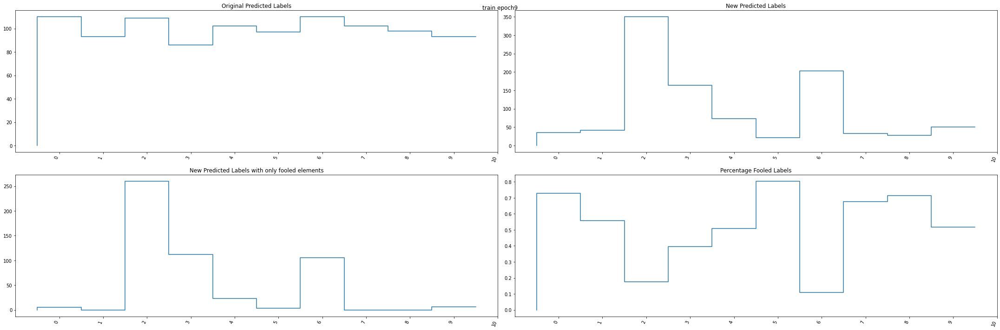

Test Fooling ratio 9: 100%|██████████| 1000/1000 [00:16<00:00, 60.00it/s]


test fooling ratio: tensor(0.5344)


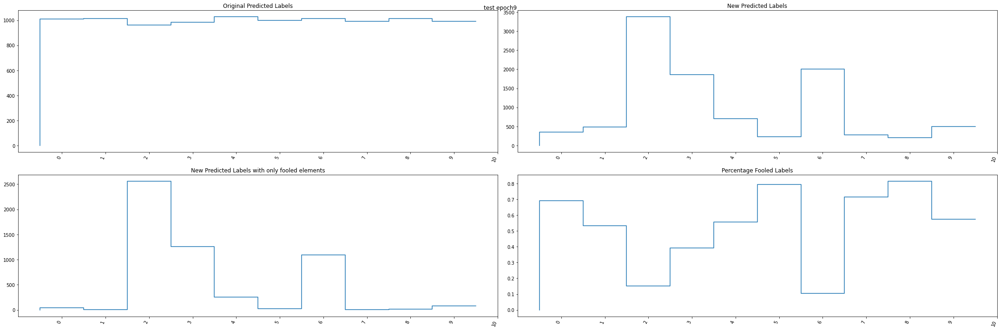

training fooling ratio: tensor(0.5140)
- data size: 2000
Files already downloaded and verified
Files already downloaded and verified
Iteration 0


Fooling ratio 0: 100%|██████████| 200/200 [00:03<00:00, 60.50it/s]


train fooling ratio: tensor(0.4540)


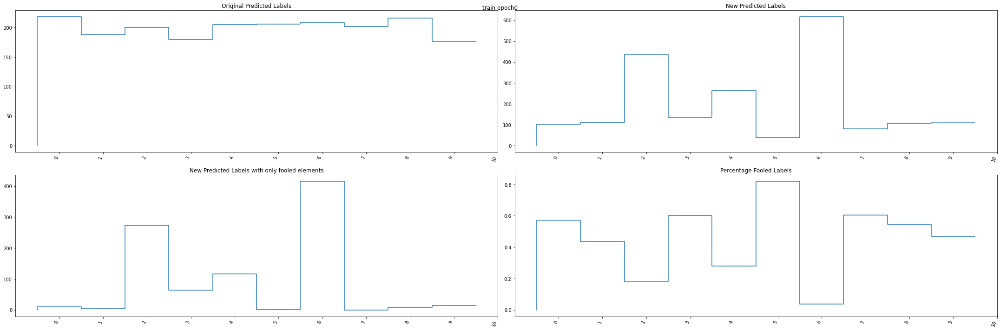

Test Fooling ratio 0: 100%|██████████| 1000/1000 [00:16<00:00, 61.44it/s]


test fooling ratio: tensor(0.4584)


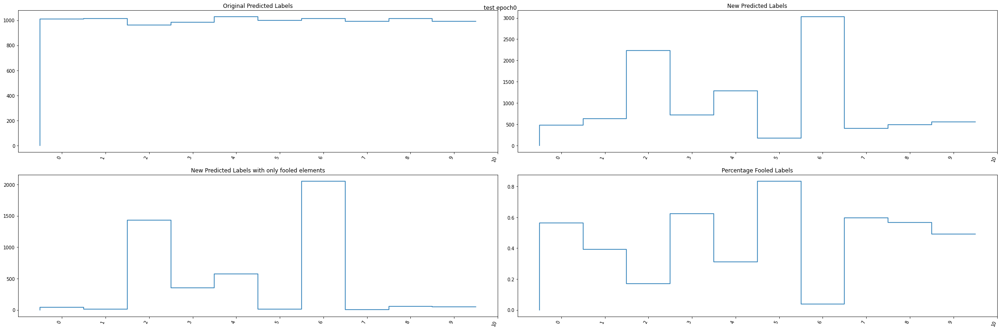

Iteration 1


Fooling ratio 1: 100%|██████████| 200/200 [00:03<00:00, 57.59it/s]


train fooling ratio: tensor(0.5560)


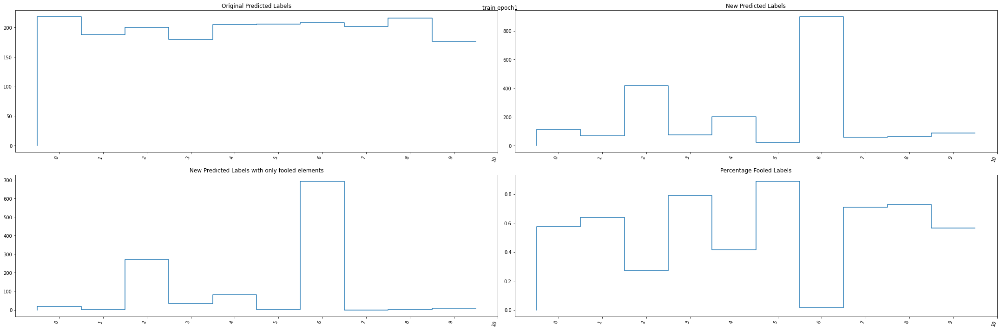

Test Fooling ratio 1: 100%|██████████| 1000/1000 [00:17<00:00, 58.31it/s]


test fooling ratio: tensor(0.5721)


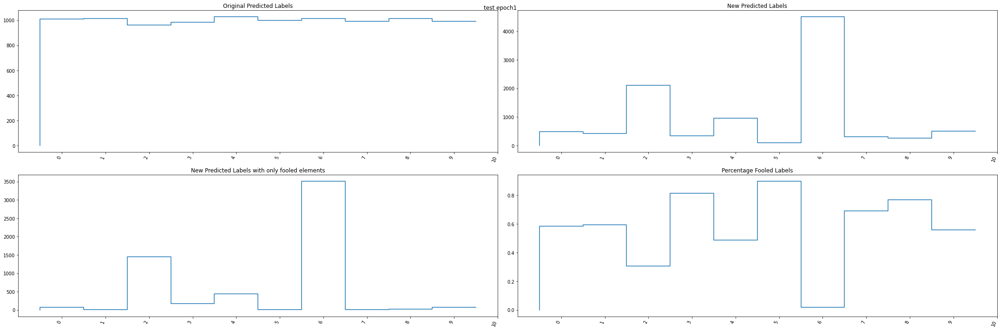

Iteration 2


Fooling ratio 2: 100%|██████████| 200/200 [00:03<00:00, 58.09it/s]


train fooling ratio: tensor(0.5285)


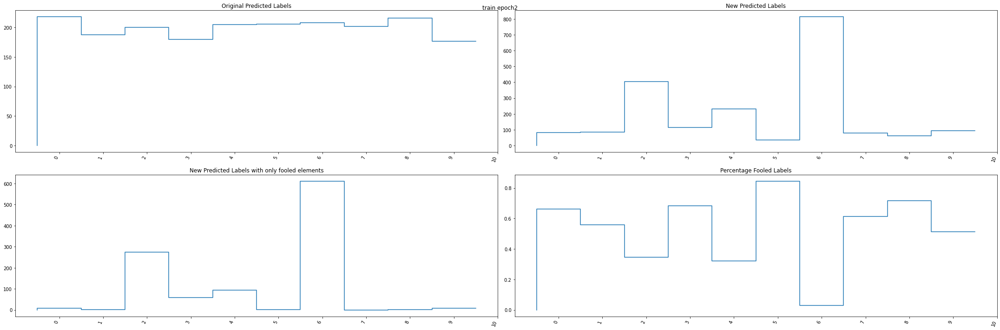

Test Fooling ratio 2: 100%|██████████| 1000/1000 [00:16<00:00, 60.92it/s]


test fooling ratio: tensor(0.5361)


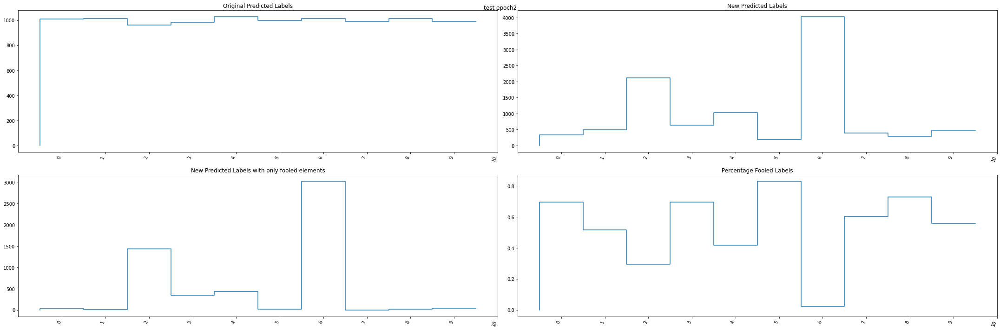

Iteration 3


Fooling ratio 3: 100%|██████████| 200/200 [00:03<00:00, 59.12it/s]


train fooling ratio: tensor(0.4185)


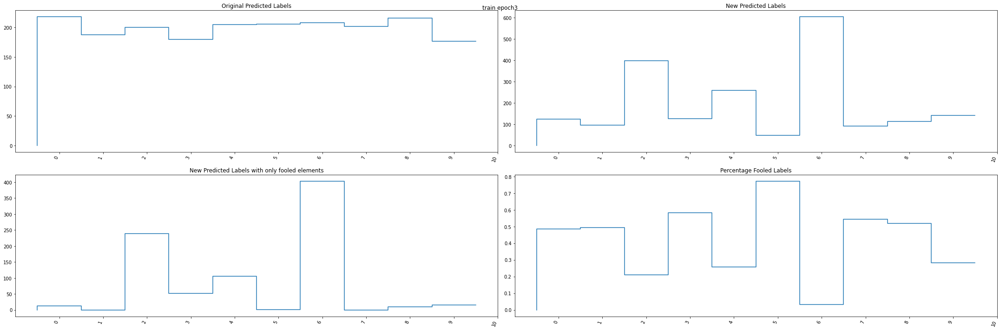

Test Fooling ratio 3: 100%|██████████| 1000/1000 [00:16<00:00, 59.68it/s]


test fooling ratio: tensor(0.4382)


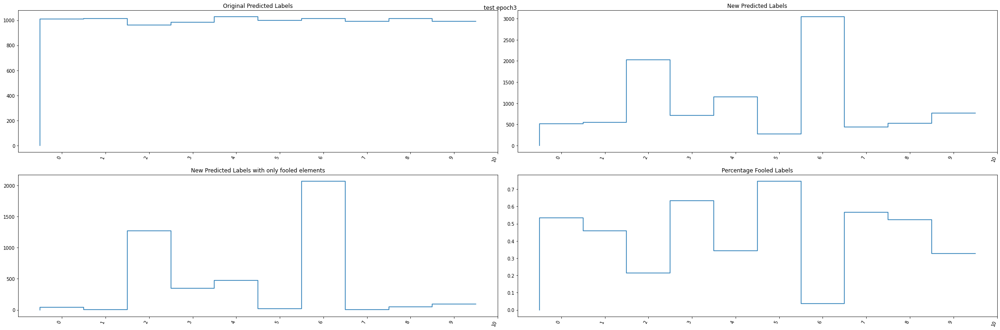

Iteration 4


Fooling ratio 4: 100%|██████████| 200/200 [00:03<00:00, 59.36it/s]


train fooling ratio: tensor(0.4910)


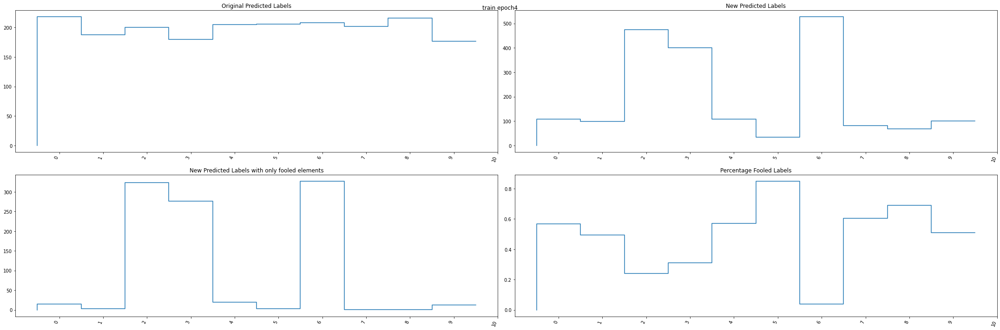

Test Fooling ratio 4: 100%|██████████| 1000/1000 [00:16<00:00, 60.53it/s]


test fooling ratio: tensor(0.5047)


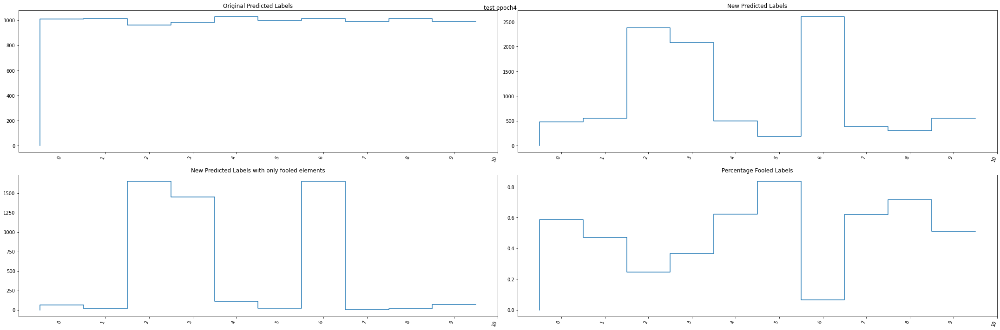

Iteration 5


Fooling ratio 5: 100%|██████████| 200/200 [00:03<00:00, 60.40it/s]


train fooling ratio: tensor(0.5325)


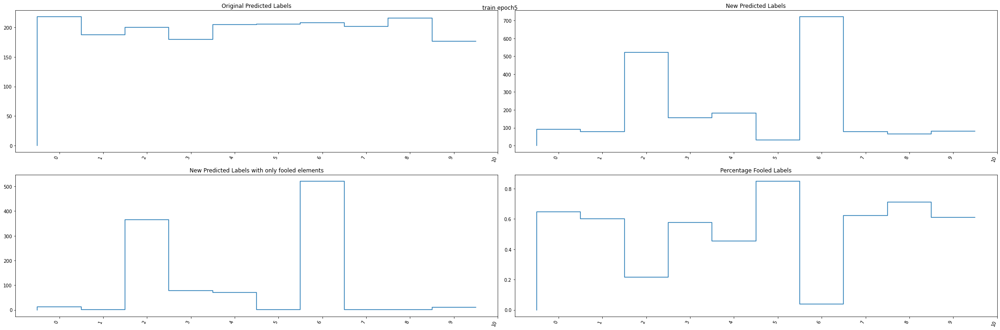

Test Fooling ratio 5: 100%|██████████| 1000/1000 [00:16<00:00, 60.54it/s]


test fooling ratio: tensor(0.5491)


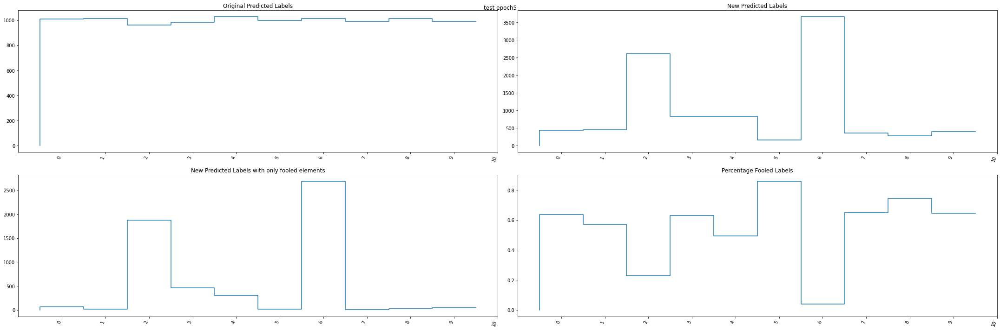

Iteration 6


Fooling ratio 6: 100%|██████████| 200/200 [00:03<00:00, 59.25it/s]


train fooling ratio: tensor(0.5100)


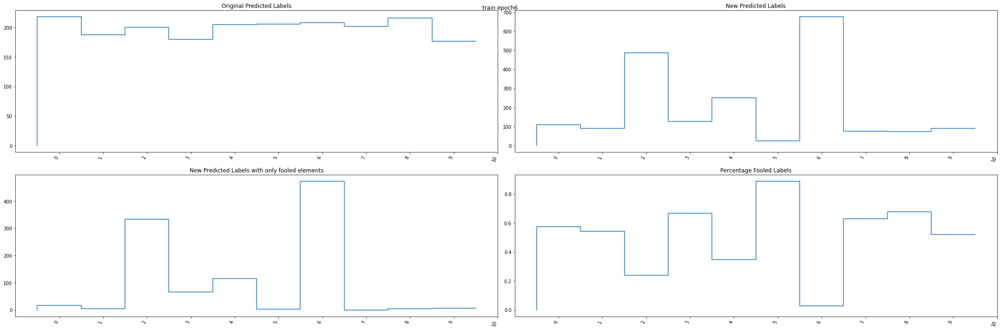

Test Fooling ratio 6: 100%|██████████| 1000/1000 [00:16<00:00, 60.13it/s]


test fooling ratio: tensor(0.5167)


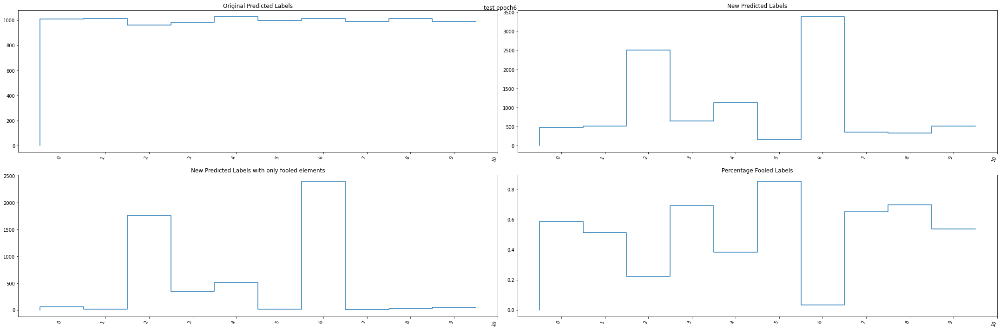

Iteration 7


Fooling ratio 7: 100%|██████████| 200/200 [00:03<00:00, 59.25it/s]


train fooling ratio: tensor(0.5140)


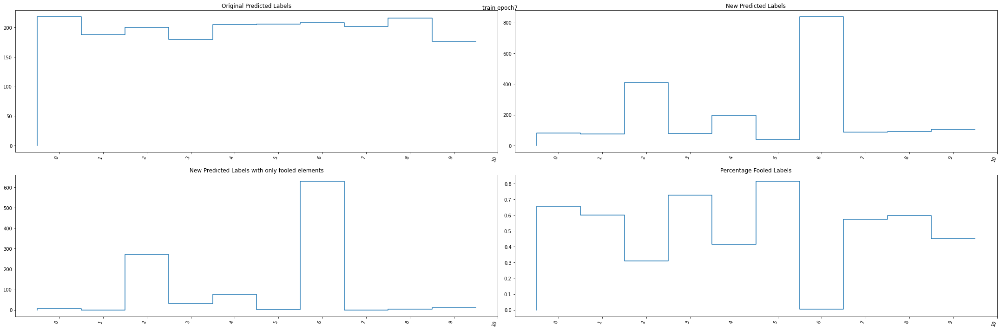

Test Fooling ratio 7: 100%|██████████| 1000/1000 [00:16<00:00, 59.87it/s]


test fooling ratio: tensor(0.5302)


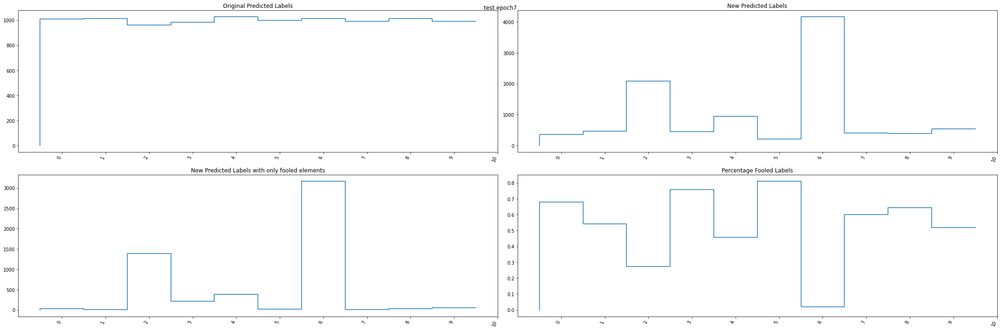

Iteration 8


Fooling ratio 8: 100%|██████████| 200/200 [00:03<00:00, 60.20it/s]


train fooling ratio: tensor(0.4795)


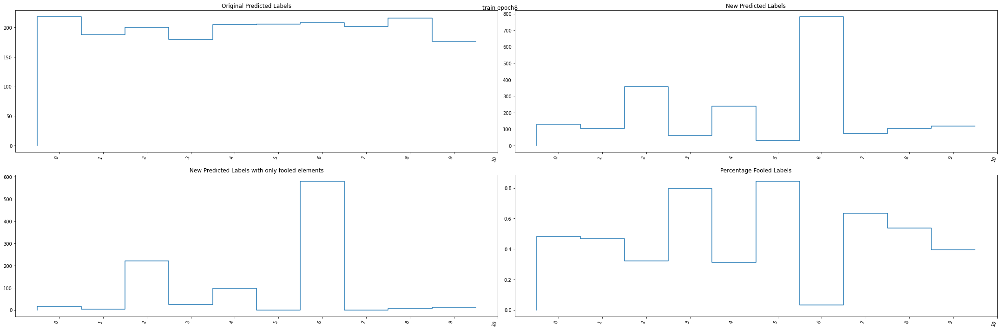

Test Fooling ratio 8: 100%|██████████| 1000/1000 [00:16<00:00, 60.12it/s]


test fooling ratio: tensor(0.4857)


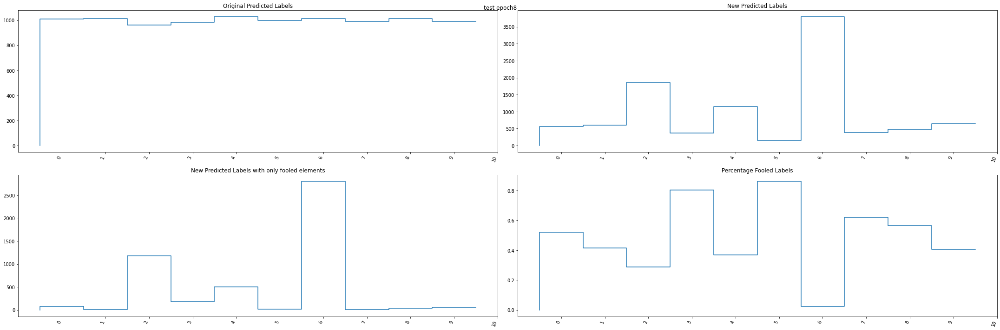

Iteration 9


Fooling ratio 9: 100%|██████████| 200/200 [00:03<00:00, 58.32it/s]


train fooling ratio: tensor(0.4420)


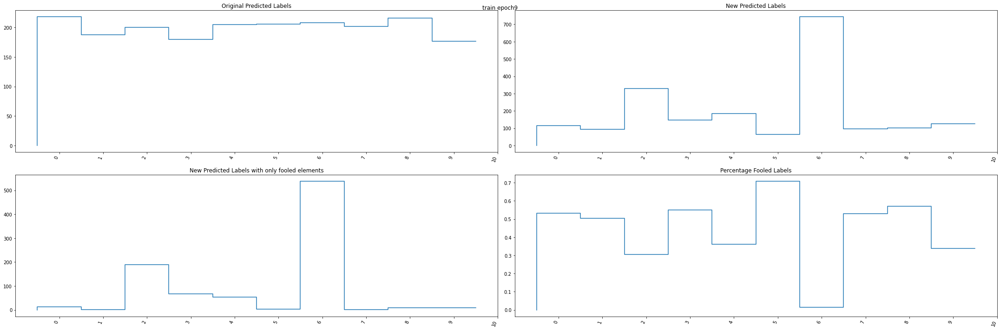

Test Fooling ratio 9: 100%|██████████| 1000/1000 [00:16<00:00, 58.85it/s]


test fooling ratio: tensor(0.4482)


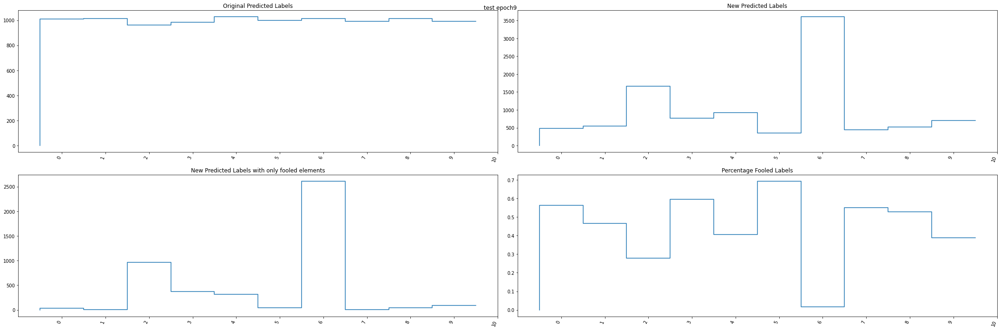

training fooling ratio: tensor(0.4420)
- data size: 4000
Files already downloaded and verified
Files already downloaded and verified
Iteration 0


Fooling ratio 0: 100%|██████████| 400/400 [00:06<00:00, 60.44it/s]


train fooling ratio: tensor(0.5383)


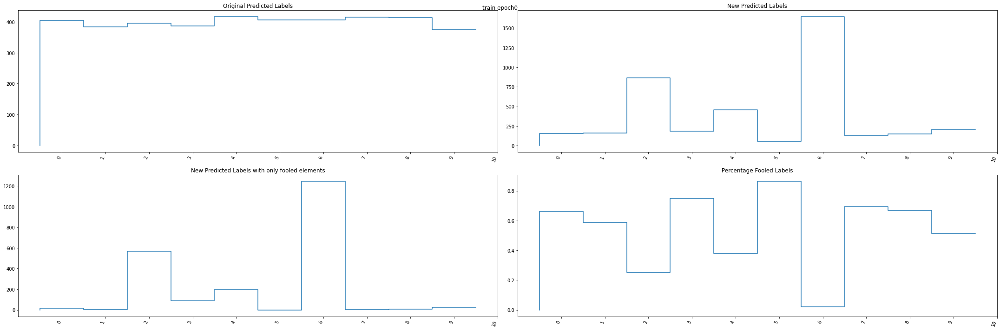

Test Fooling ratio 0: 100%|██████████| 1000/1000 [00:16<00:00, 59.92it/s]


test fooling ratio: tensor(0.5460)


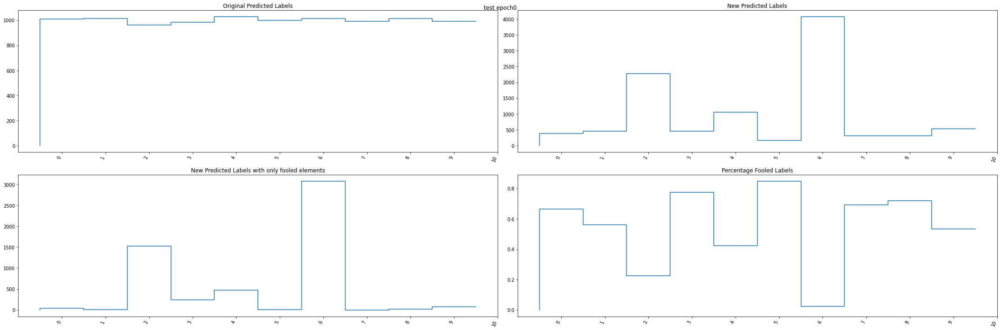

Iteration 1


Fooling ratio 1: 100%|██████████| 400/400 [00:06<00:00, 59.25it/s]


train fooling ratio: tensor(0.5268)


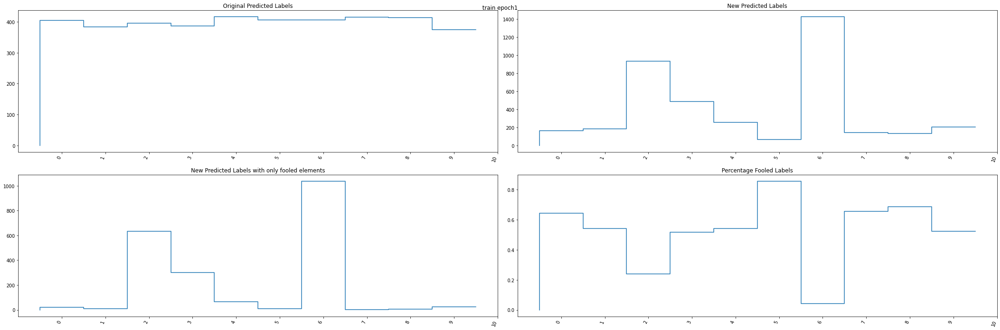

Test Fooling ratio 1: 100%|██████████| 1000/1000 [00:16<00:00, 59.29it/s]


test fooling ratio: tensor(0.5419)


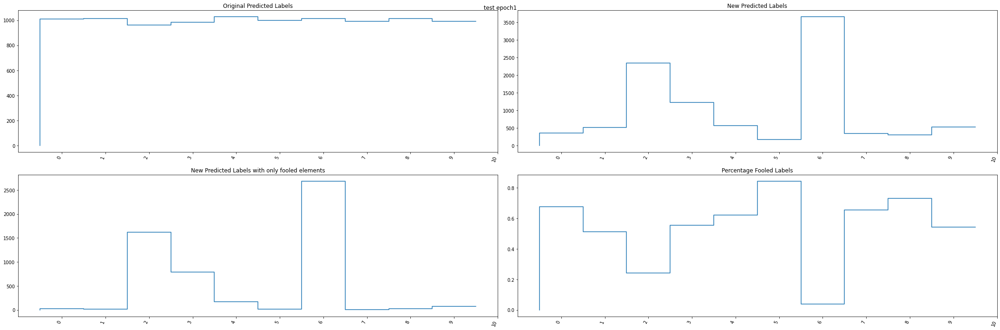

Iteration 2


Fooling ratio 2: 100%|██████████| 400/400 [00:07<00:00, 57.13it/s]


train fooling ratio: tensor(0.4975)


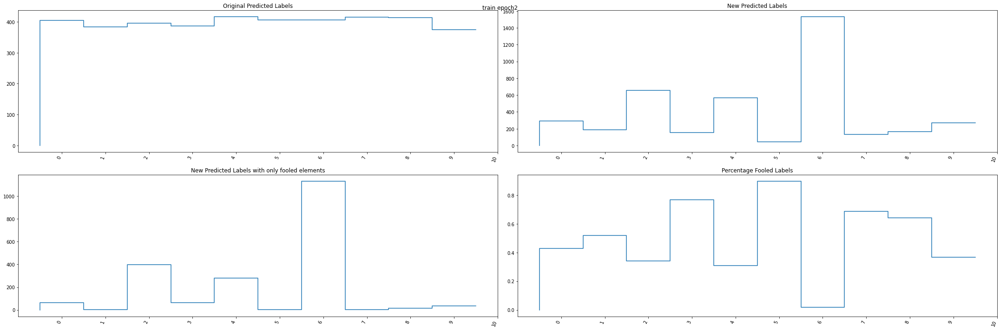

Test Fooling ratio 2: 100%|██████████| 1000/1000 [00:17<00:00, 58.43it/s]


test fooling ratio: tensor(0.5059)


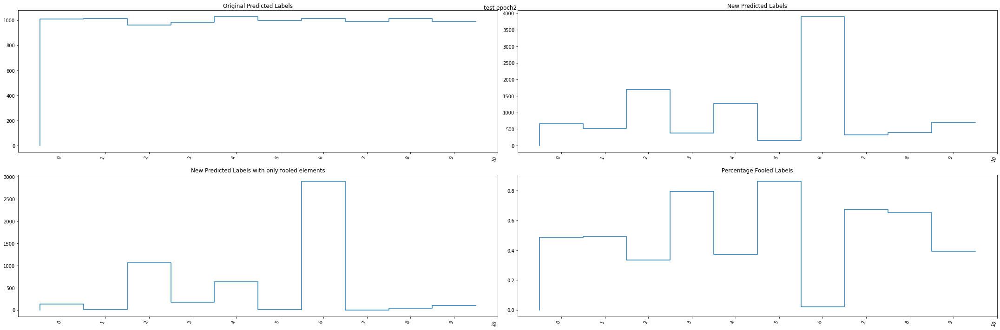

Iteration 3


Fooling ratio 3: 100%|██████████| 400/400 [00:06<00:00, 57.89it/s]


train fooling ratio: tensor(0.5580)


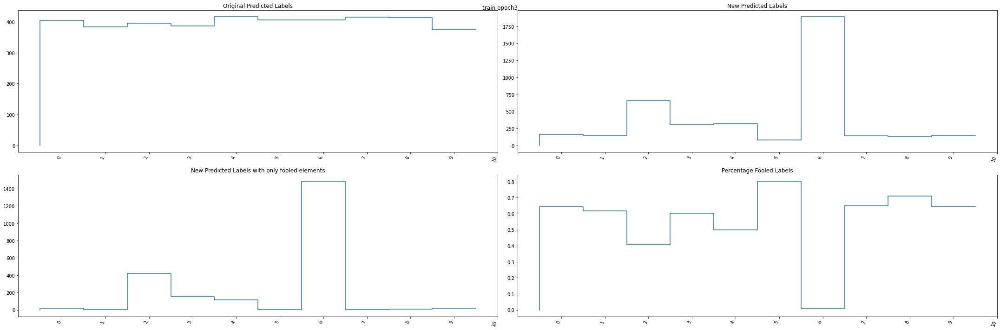

Test Fooling ratio 3: 100%|██████████| 1000/1000 [00:17<00:00, 58.57it/s]


test fooling ratio: tensor(0.5739)


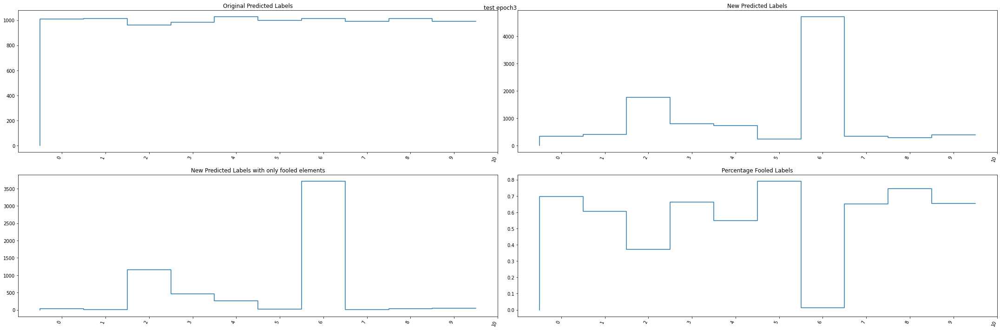

Iteration 4


Fooling ratio 4: 100%|██████████| 400/400 [00:06<00:00, 58.47it/s]


train fooling ratio: tensor(0.4925)


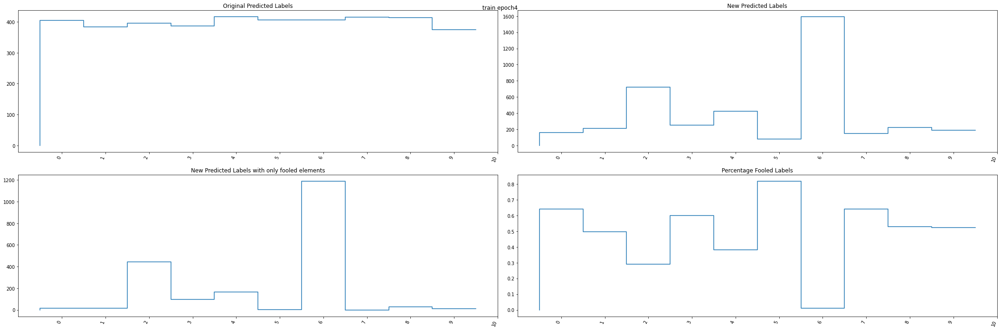

Test Fooling ratio 4: 100%|██████████| 1000/1000 [00:17<00:00, 58.74it/s]


test fooling ratio: tensor(0.5046)


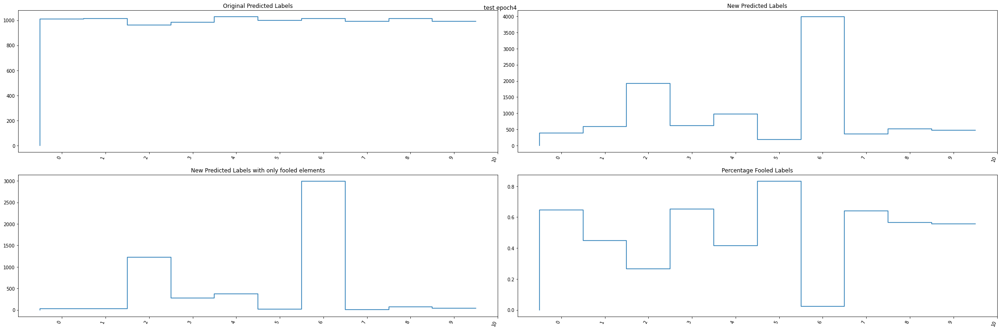

Iteration 5


Fooling ratio 5: 100%|██████████| 400/400 [00:07<00:00, 56.43it/s]


train fooling ratio: tensor(0.4647)


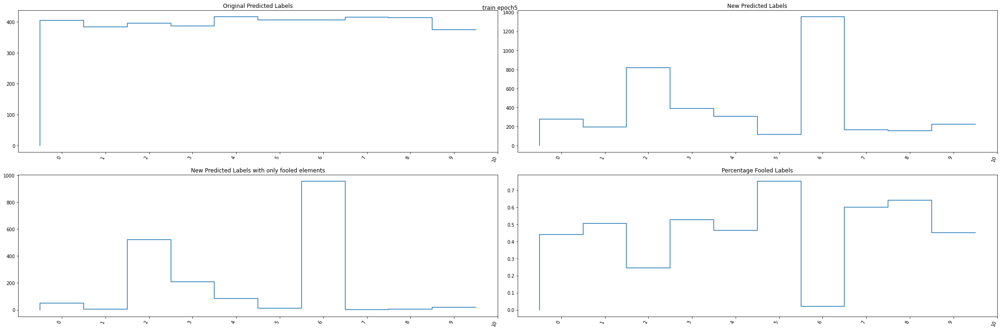

Test Fooling ratio 5: 100%|██████████| 1000/1000 [00:17<00:00, 57.87it/s]


test fooling ratio: tensor(0.4770)


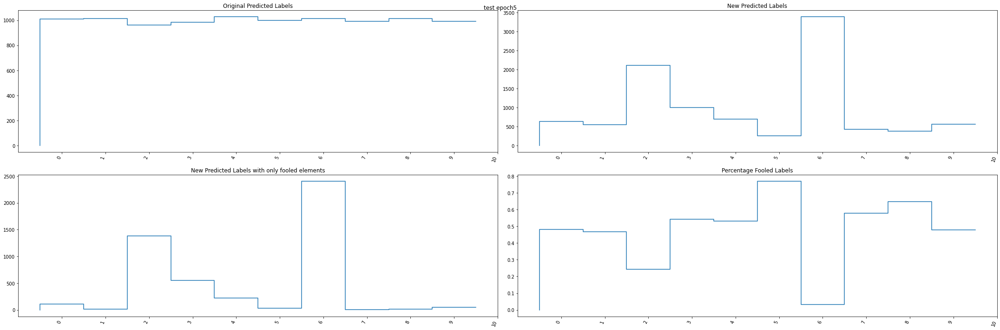

Iteration 6


Fooling ratio 6: 100%|██████████| 400/400 [00:07<00:00, 56.89it/s]


train fooling ratio: tensor(0.4667)


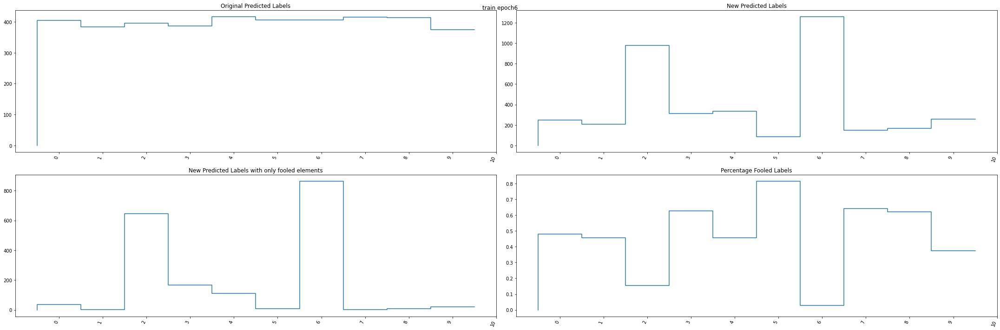

Test Fooling ratio 6: 100%|██████████| 1000/1000 [00:17<00:00, 58.09it/s]


test fooling ratio: tensor(0.4812)


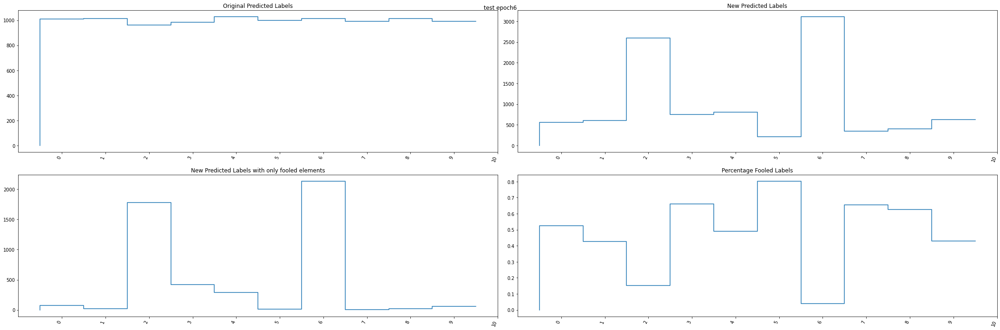

Iteration 7


Fooling ratio 7: 100%|██████████| 400/400 [00:07<00:00, 56.70it/s]


train fooling ratio: tensor(0.4120)


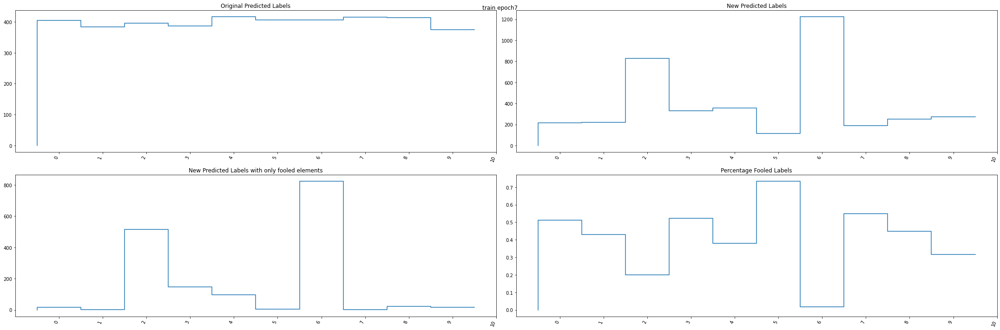

Test Fooling ratio 7: 100%|██████████| 1000/1000 [00:17<00:00, 57.76it/s]


test fooling ratio: tensor(0.4322)


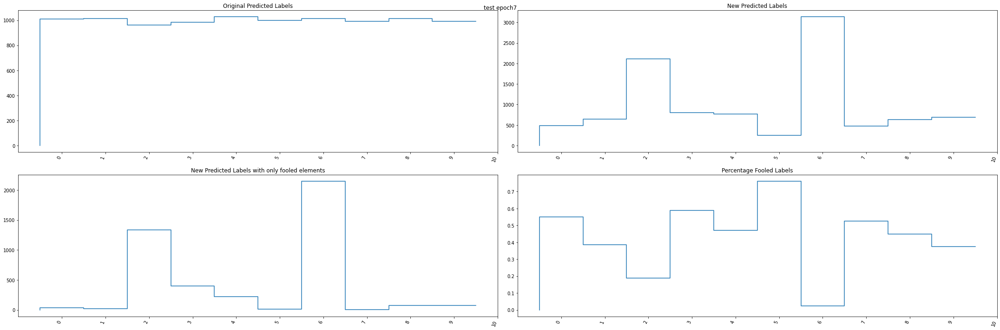

Iteration 8


Fooling ratio 8: 100%|██████████| 400/400 [00:06<00:00, 58.36it/s]


train fooling ratio: tensor(0.5435)


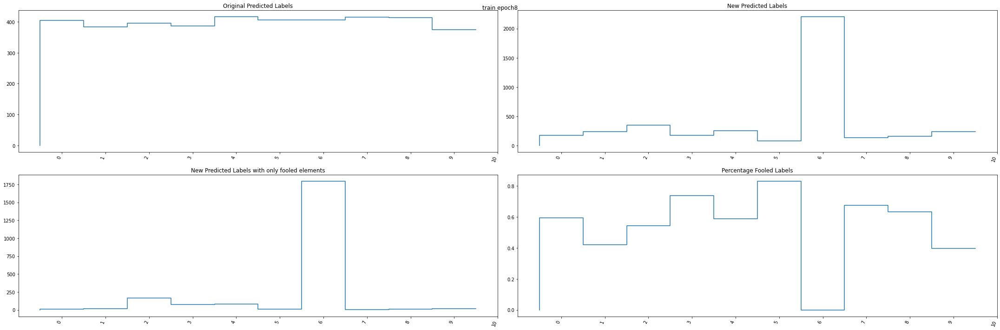

Test Fooling ratio 8: 100%|██████████| 1000/1000 [00:17<00:00, 57.39it/s]


test fooling ratio: tensor(0.5557)


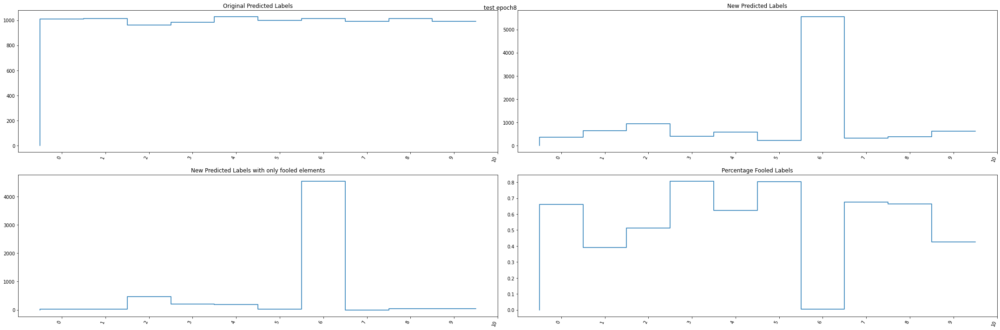

Iteration 9


Fooling ratio 9: 100%|██████████| 400/400 [00:07<00:00, 56.28it/s]


train fooling ratio: tensor(0.4983)


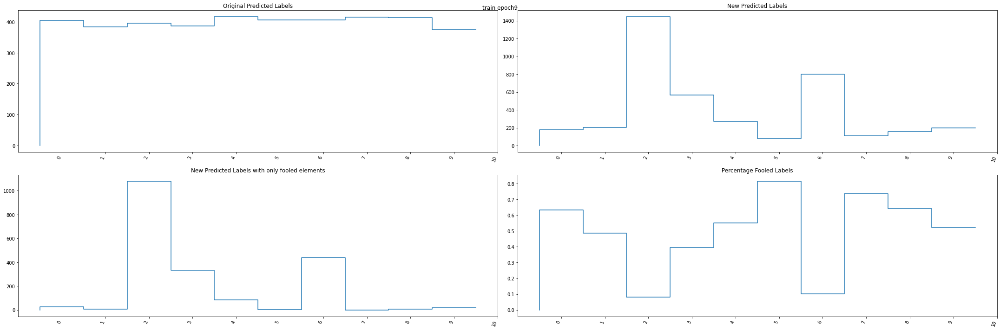

Test Fooling ratio 9: 100%|██████████| 1000/1000 [00:17<00:00, 56.65it/s]


test fooling ratio: tensor(0.5115)


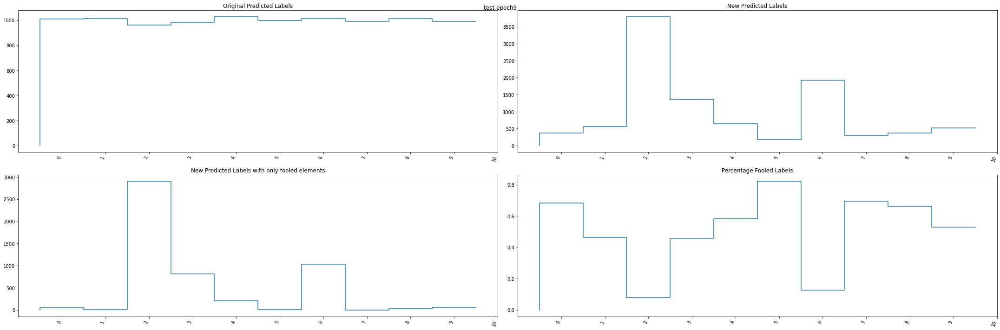

training fooling ratio: tensor(0.4983)
- data size: 10000
Files already downloaded and verified
Files already downloaded and verified
Iteration 0


Fooling ratio 0: 100%|██████████| 1000/1000 [00:17<00:00, 57.11it/s]


train fooling ratio: tensor(0.5179)


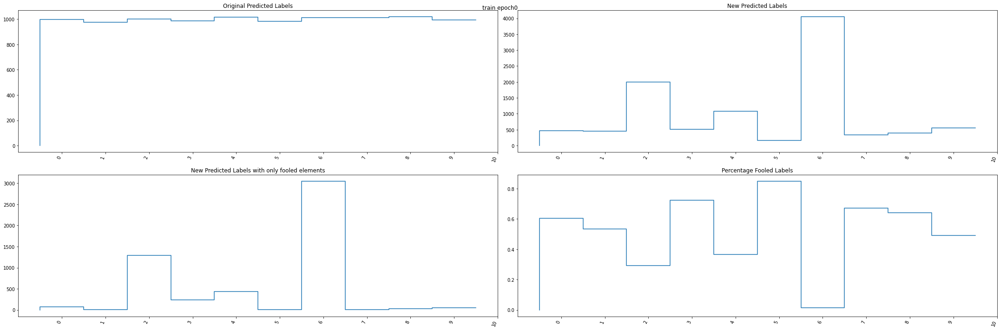

Test Fooling ratio 0: 100%|██████████| 1000/1000 [00:17<00:00, 57.09it/s]


test fooling ratio: tensor(0.5282)


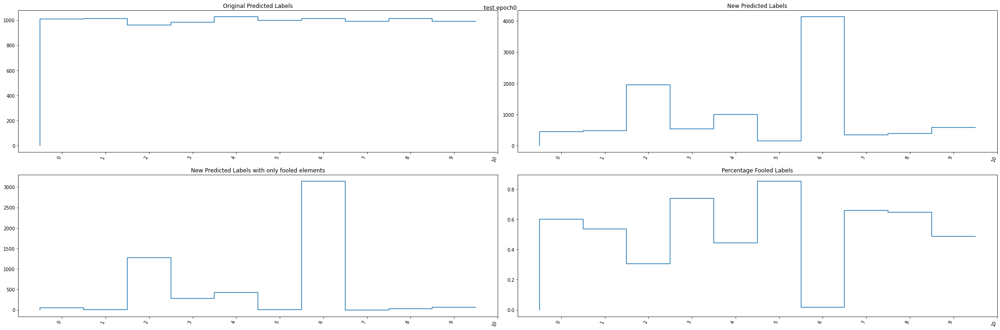

Iteration 1


Fooling ratio 1: 100%|██████████| 1000/1000 [00:17<00:00, 57.29it/s]


train fooling ratio: tensor(0.4554)


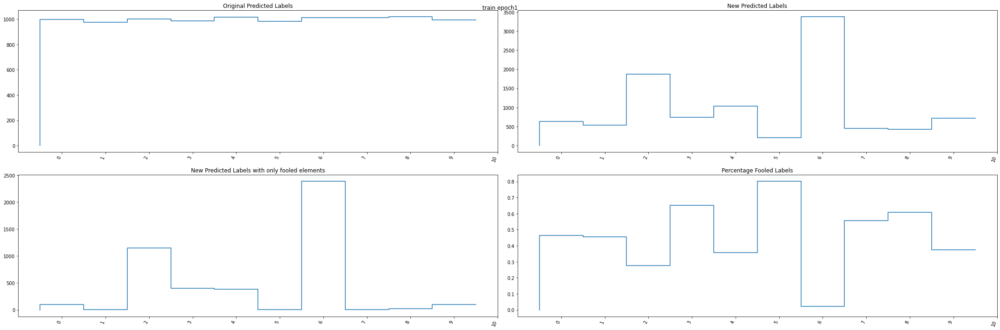

Test Fooling ratio 1: 100%|██████████| 1000/1000 [00:17<00:00, 57.45it/s]


test fooling ratio: tensor(0.4736)


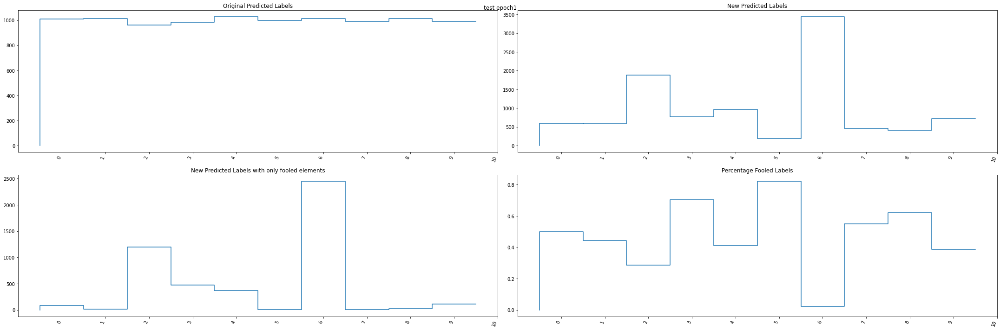

Iteration 2


Fooling ratio 2: 100%|██████████| 1000/1000 [00:17<00:00, 56.49it/s]


train fooling ratio: tensor(0.5594)


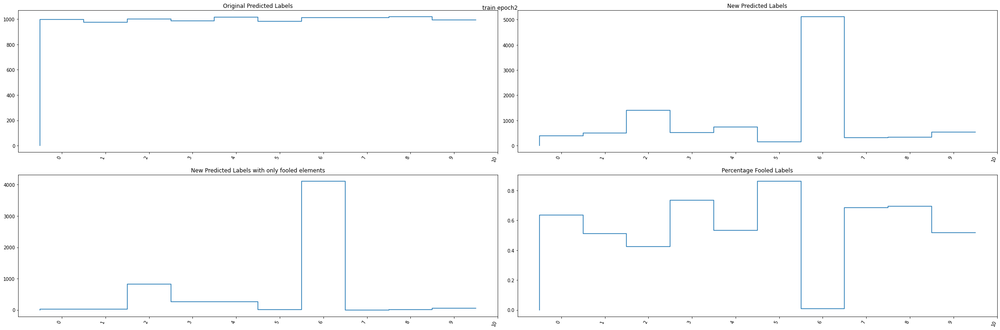

Test Fooling ratio 2: 100%|██████████| 1000/1000 [00:17<00:00, 56.70it/s]


test fooling ratio: tensor(0.5707)


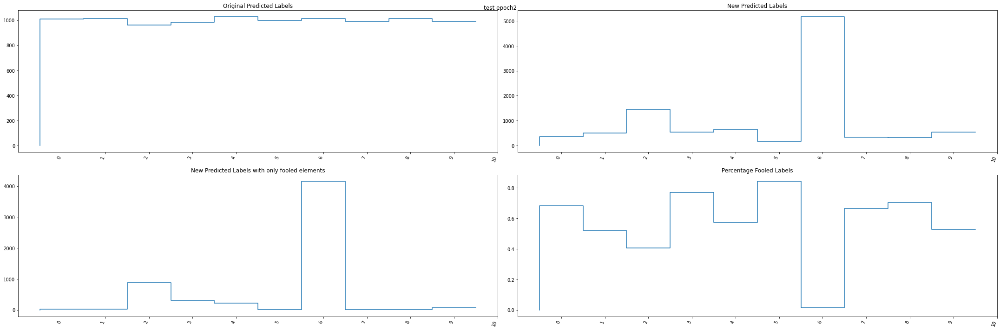

Iteration 3


Fooling ratio 3: 100%|██████████| 1000/1000 [00:17<00:00, 56.07it/s]


train fooling ratio: tensor(0.4608)


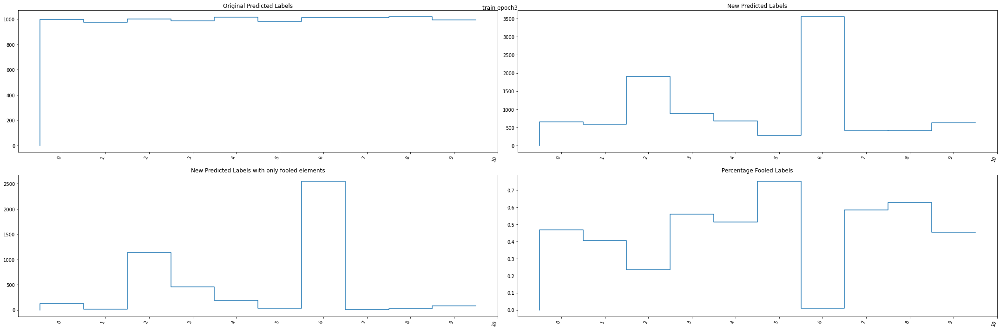

Test Fooling ratio 3: 100%|██████████| 1000/1000 [00:17<00:00, 56.66it/s]


test fooling ratio: tensor(0.4756)


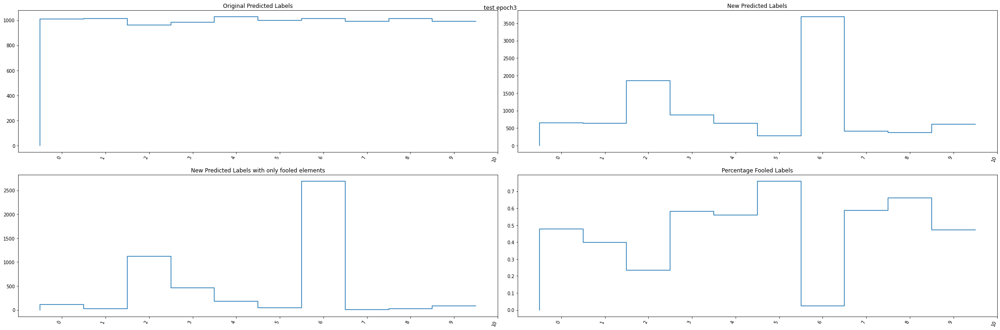

Iteration 4


Fooling ratio 4: 100%|██████████| 1000/1000 [00:18<00:00, 54.84it/s]


train fooling ratio: tensor(0.3917)


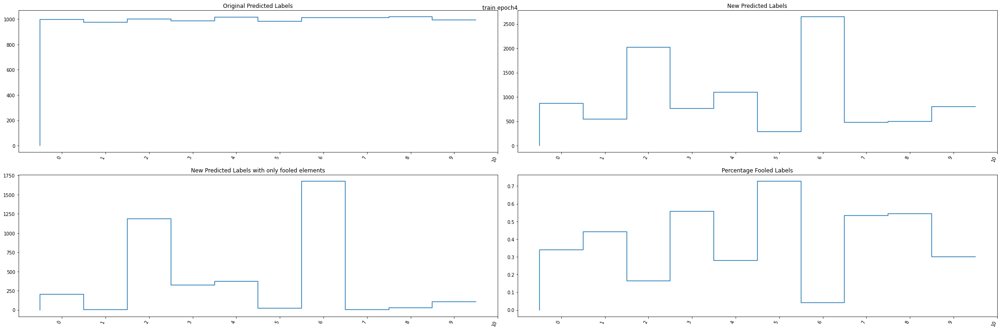

Test Fooling ratio 4: 100%|██████████| 1000/1000 [00:18<00:00, 55.30it/s]


test fooling ratio: tensor(0.4045)


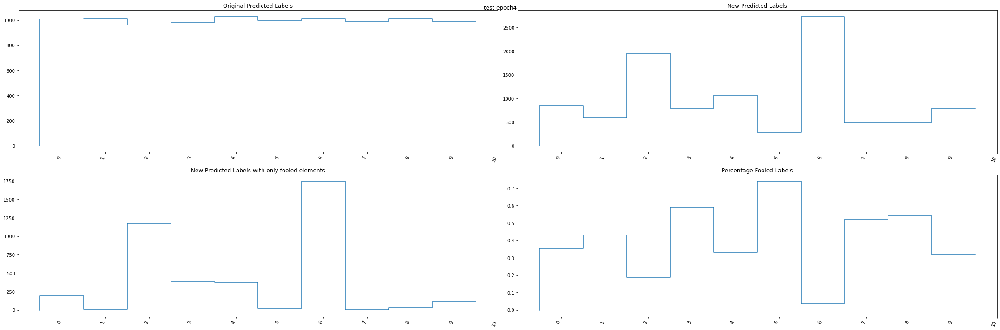

Iteration 5


Fooling ratio 5: 100%|██████████| 1000/1000 [00:17<00:00, 57.31it/s]


train fooling ratio: tensor(0.4474)


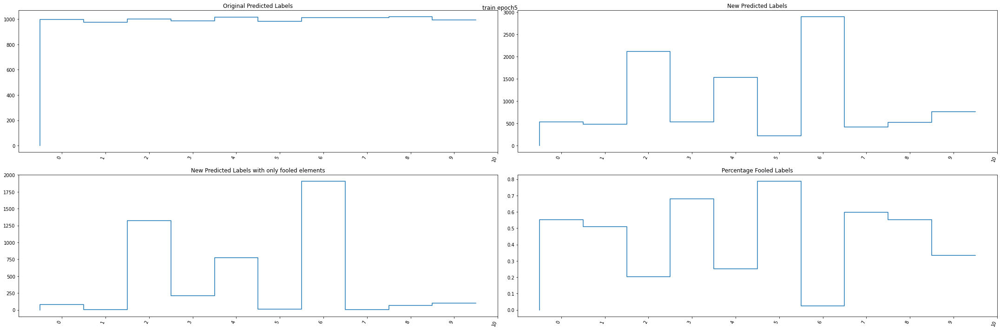

Test Fooling ratio 5: 100%|██████████| 1000/1000 [00:17<00:00, 57.70it/s]


test fooling ratio: tensor(0.4556)


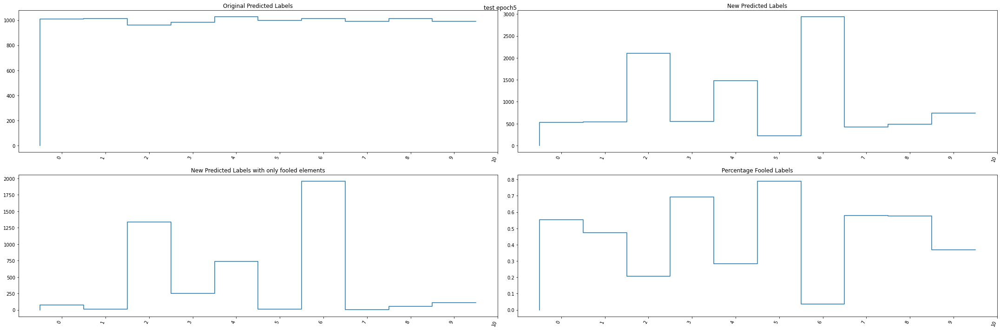

Iteration 6


Fooling ratio 6: 100%|██████████| 1000/1000 [00:17<00:00, 57.28it/s]


train fooling ratio: tensor(0.5294)


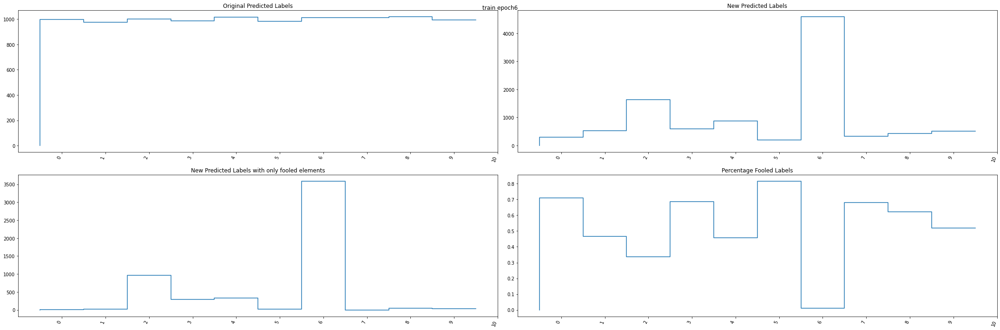

Test Fooling ratio 6: 100%|██████████| 1000/1000 [00:17<00:00, 56.95it/s]


test fooling ratio: tensor(0.5350)


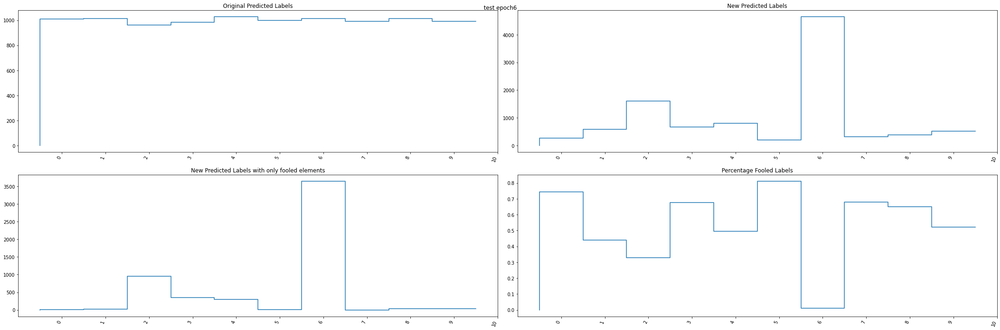

Iteration 7


Fooling ratio 7: 100%|██████████| 1000/1000 [00:17<00:00, 55.76it/s]


train fooling ratio: tensor(0.4924)


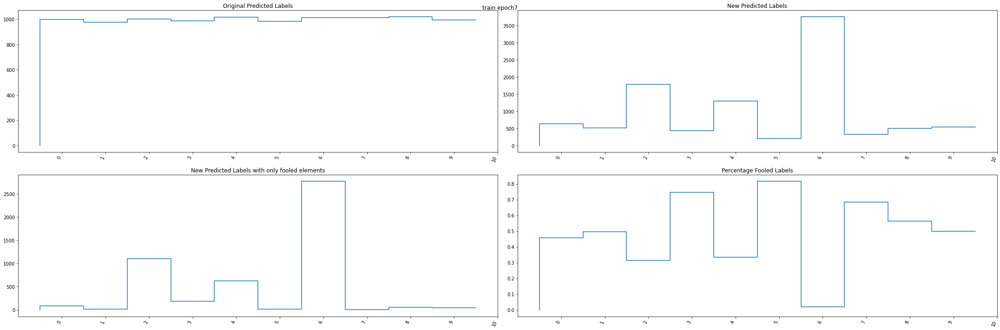

Test Fooling ratio 7: 100%|██████████| 1000/1000 [00:17<00:00, 56.01it/s]


test fooling ratio: tensor(0.4938)


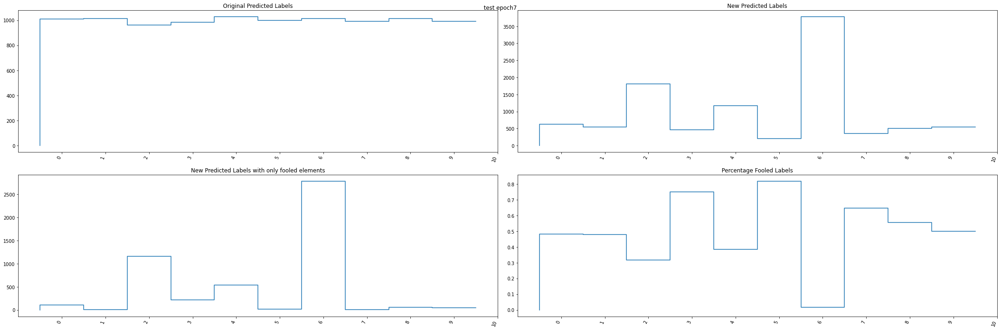

Iteration 8


Fooling ratio 8: 100%|██████████| 1000/1000 [00:18<00:00, 54.70it/s]


train fooling ratio: tensor(0.5106)


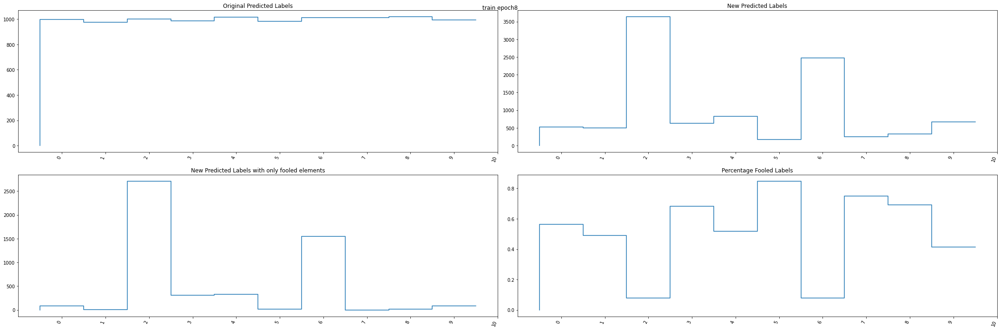

Test Fooling ratio 8: 100%|██████████| 1000/1000 [00:18<00:00, 55.40it/s]


test fooling ratio: tensor(0.5157)


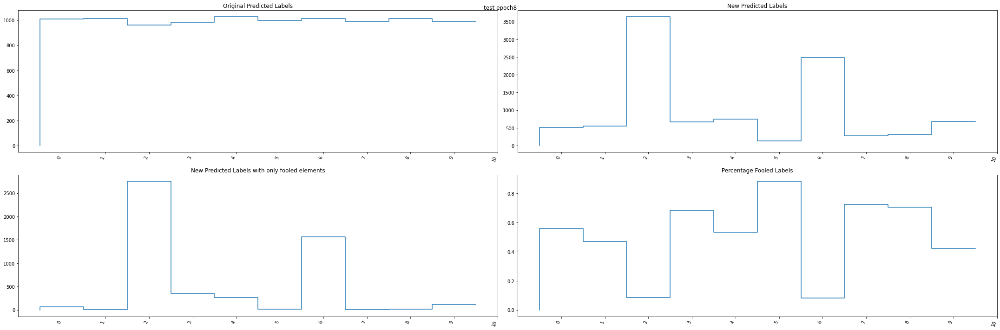

Iteration 9


Fooling ratio 9: 100%|██████████| 1000/1000 [00:17<00:00, 55.74it/s]


train fooling ratio: tensor(0.5621)


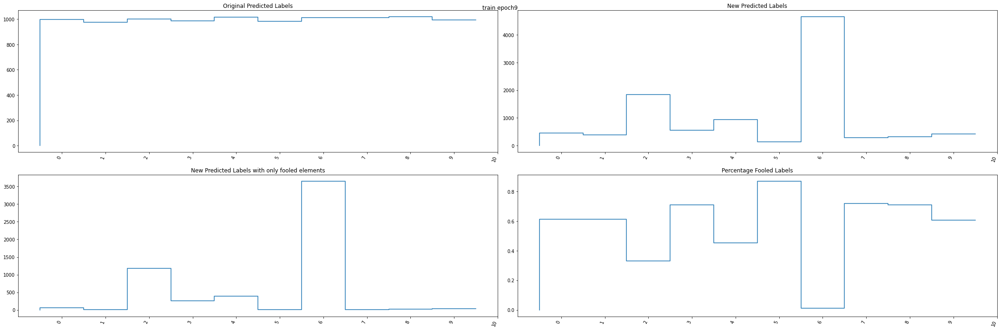

Test Fooling ratio 9: 100%|██████████| 1000/1000 [00:17<00:00, 56.03it/s]


test fooling ratio: tensor(0.5686)


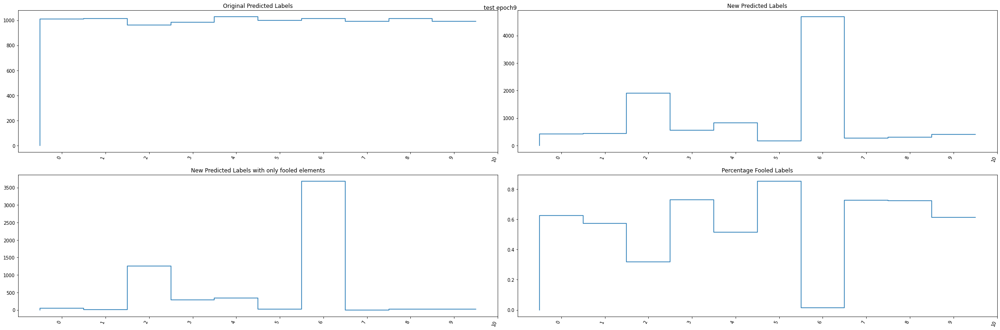

training fooling ratio: tensor(0.5621)


In [ ]:

sizes = [10, 50, 100, 500, 1000, 2000, 4000, 10000]
xi =  0.037648
delta = 0.1
device = ('cuda' if torch.cuda.is_available() else 'cpu')
for data_size in sizes:
  print("- data size:",data_size)
  log_dir = os.path.join(save_path,"logs/"+datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + "_delta" + str(delta) + "_xi" + str(xi) + "_datasize" + str(data_size) + "_CIFAR")
  writer = SummaryWriter(log_dir)
  torch.manual_seed(1)
  random.seed(1)
  np.random.seed(1)
  model, dataloader_train, dataloader_test, _ = set_up_CIFAR10(train_size = data_size, test_size = 10000, demonstration_size = 10, batch_size = 10, download = True)
  result = generate(dataloader_train,dataloader_test, model, writer, device, delta = delta, max_iter_uni=10, xi=xi, p=np.inf, num_classes=10, overshoot=0.02, max_iter_df=10, image_size = [3,32,32], total_class = 10, plot_only_last = False)
  torch.save(result,os.path.join(save_path, "result_"+str(data_size)+"_CIFAR"))
  print("training fooling ratio:", result[1])


#### Perturbation Visualization

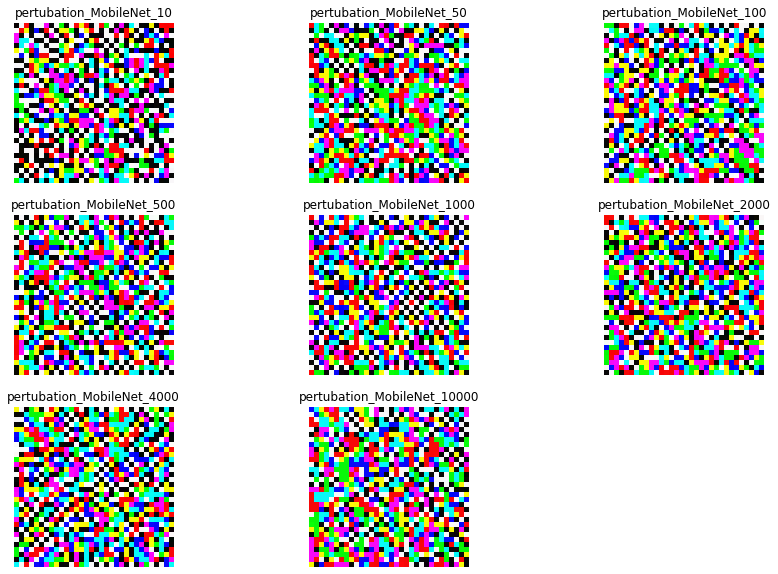

In [ ]:
sizes = [10, 50, 100, 500, 1000,2000,4000,10000]



trans = transforms.ToPILImage()
plt.figure(figsize=(15,10))
for i, data_size in enumerate(sizes):
  result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_CIFAR"))
  plt.subplot(len(sizes)//3 + 1, 3, i + 1)
  plt.imshow(trans(result[0]))
  plt.title('pertubation_MobileNet_'+ str(data_size))
  plt.axis('off')
plt.show()



#### Result Visualization

Files already downloaded and verified
Files already downloaded and verified


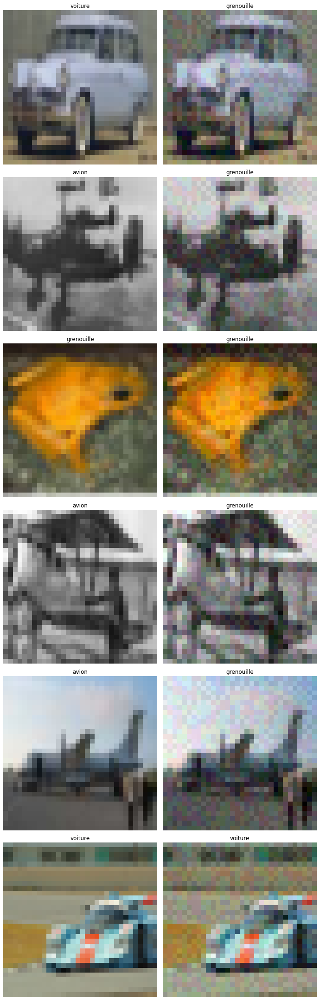

In [ ]:
data_size = 10000

torch.manual_seed(3)
random.seed(3)
np.random.seed(3)

classes = ["avion", "voiture", "oiseau", "chat", "cerf", "chien", "grenouille", "cheval", "bateau", "camion"]
model, _, _, demonstration_set = set_up_CIFAR10(train_size = 1, test_size = 1, demonstration_size = 6, batch_size = 1, download = True)
result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_CIFAR"))
v = result[0]

plt.figure(figsize=(10,30))
for i, (img, _) in enumerate(demonstration_set):
  
  transformed_img = torch.clip(img + v,0,1)

  label = int(torch.argmax(model(img.unsqueeze(0)),dim = 1)[0])
  new_label = int(torch.argmax(model(transformed_img.unsqueeze(0)),dim = 1)[0])

  img = img.transpose(0,1).transpose(1,2)
  transformed_img = transformed_img.transpose(0,1).transpose(1,2)

  plt.subplot(6, 2, i*2 + 1)
  plt.imshow(img)
  plt.title(classes[label])
  plt.axis('off')

  plt.subplot(6 ,2 , i*2 + 2)
  plt.imshow(transformed_img)
  plt.title(classes[new_label])
  plt.axis('off')
plt.tight_layout()

plt.show()

#### Final Fooling Rates

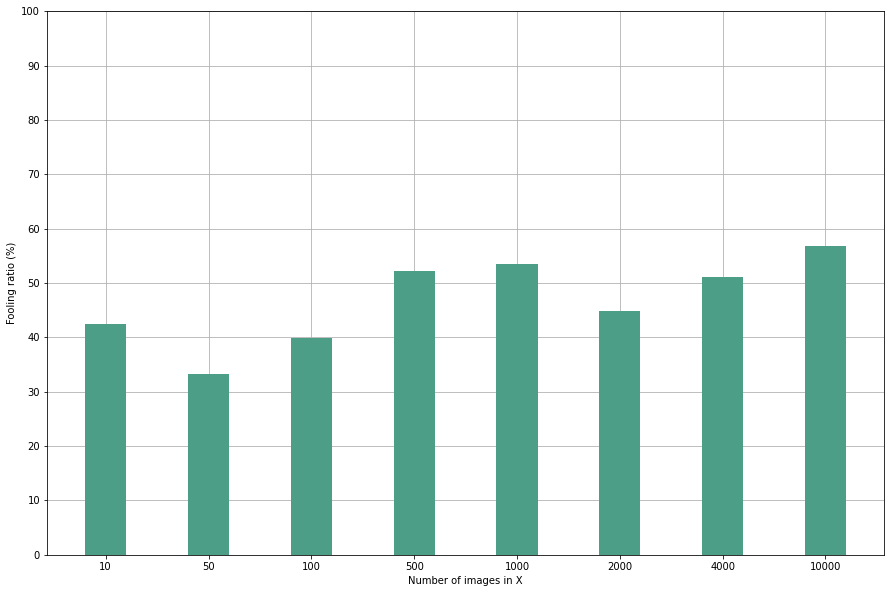

In [ ]:
sizes = [10, 50, 100, 500, 1000, 2000, 4000, 10000]

fooling_rates = torch.zeros(len(sizes))
for i, data_size in enumerate(sizes):
  result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_CIFAR"))
  fooling_rates[i] = result[2]


plt.figure(figsize=(15,10))
plt.grid(zorder=0)
plt.yticks(np.arange(0, 110, 10))
plt.bar([str(x) for x in sizes],fooling_rates*100,0.4,zorder=3,color='#4c9f86')
plt.ylim(0,100)
plt.xlabel('Number of images in X')
plt.ylabel('Fooling ratio (%)')
plt.show()

#### Fooling Distribution 

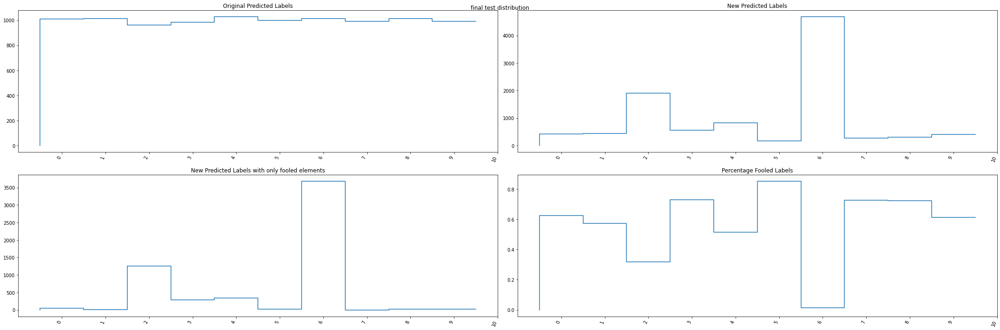

In [ ]:
data_size = 10000
result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_CIFAR"))
plot(result[4],"final test distribution",10)

#### Fooling Rate Evolution

In [ ]:
log_path = os.path.join(save_path,"logs/CIFAR")
%load_ext tensorboard
%tensorboard --logdir $log_path

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

#### Graph

In [ ]:
data_size = 10000
nb_class = 10

torch.manual_seed(1)
random.seed(1)
np.random.seed(1)

classes = ["avion", "voiture", "oiseau", "chat", "cerf", "chien", "grenouille", "cheval", "bateau", "camion"]
model, _, dataloader_test, _ = set_up_CIFAR10(train_size = 1, test_size = 10000, demonstration_size = 6, batch_size = 1, download = True)
result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_CIFAR"))
v = result[0]

Matrice = torch.zeros((nb_class,nb_class))
device = ('cuda' if torch.cuda.is_available() else 'cpu')

model = model.to(device)
for k, (image, _) in enumerate(dataloader_test):
    image = image.to(device)
    _, pred = torch.max(model(image),1)
    _, adv_pred = torch.max(model(image+v.unsqueeze(0).to(device)), 1)
    Matrice[adv_pred.item(),pred.item()] += 1
Matrice = Matrice.fill_diagonal_(0)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./cifar10/cifar-10-python.tar.gz to ./cifar10
Files already downloaded and verified


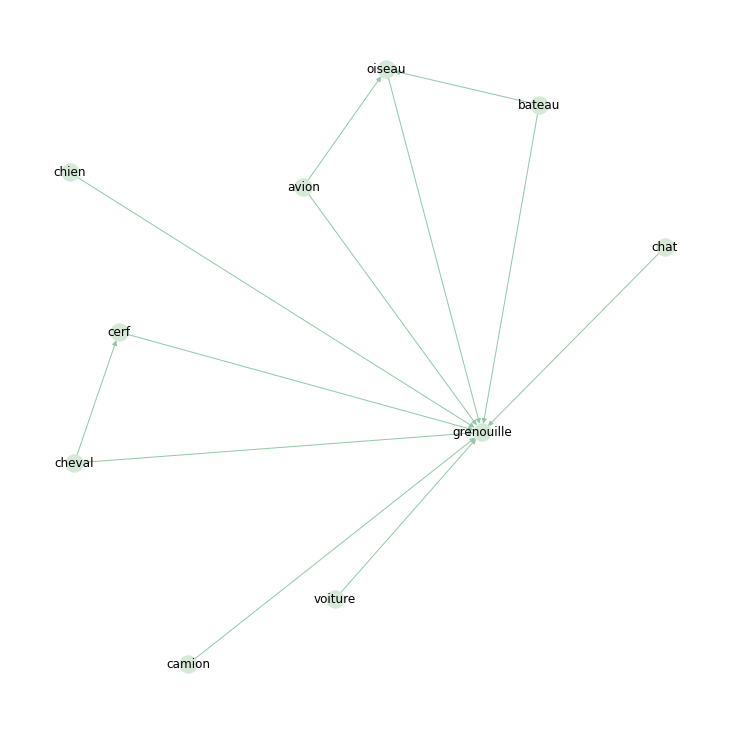

In [ ]:
seuil_aimant = 200
seuil_connexion = 200
nb_class = 10

maxs = torch.arange(nb_class)[Matrice.sum(axis=1) > seuil_aimant]
list_index_maxs = [torch.arange(nb_class)[l] for l in Matrice[maxs] > seuil_connexion]

classes = ["avion", "voiture", "oiseau", "chat", "cerf", "chien", "grenouille", "cheval", "bateau", "camion"]

plt.figure(figsize=(10,10))
g = nx.DiGraph()
for i, max in enumerate(maxs):
  for k in list_index_maxs[i]:
      g.add_edge(classes[k],classes[max])

nx.draw(g, node_color='#d6e8d7', edge_color='#90c9a9',with_labels=True)

plt.draw()


#### Certainty in Classification and Fooling

In [ ]:
data_size = 10000
nb_class = 10

torch.manual_seed(1)
random.seed(1)
np.random.seed(1)

classes = ["avion", "voiture", "oiseau", "chat", "cerf", "chien", "grenouille", "cheval", "bateau", "camion"]
model, _, dataloader_test, _ = set_up_CIFAR10(train_size = 1, test_size = 10000, demonstration_size = 6, batch_size = 1, download = True)
result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_CIFAR"))
v = result[0]

device = ('cuda' if torch.cuda.is_available() else 'cpu')

nb_fooled = 0
nb_not_fooled = 0
p_fooled = 0
p_not_fooled = 0
max_p_fooled = 0
min_p_fooled = 1
max_p_not_fooled = 0
min_p_not_fooled = 1

model = model.to(device)
for k, (image, _) in enumerate(dataloader_test):
    image = image.to(device)
    p, pred = torch.max(nn.functional.softmax(model(image), 1),1)
    _, adv_pred = torch.max(model(image+v.unsqueeze(0).to(device)), 1)

    if pred.item() != adv_pred.item():
      if p.item() > max_p_fooled:
        max_p_fooled = p.item()
      if p.item() < min_p_fooled:
        min_p_fooled = p.item()
      p_fooled += p.item()
      
      nb_fooled += 1
    else:
      if p.item() > max_p_not_fooled:
        max_p_not_fooled = p.item()
      if p.item() < min_p_not_fooled:
        min_p_not_fooled = p.item()

      p_not_fooled += p.item()
      nb_not_fooled += 1
print("Mean Certainty when Fooled:",p_fooled/nb_fooled,"with max",max_p_fooled,"and min",min_p_fooled)
print("Mean Certainty when Not Fooled:",p_not_fooled/nb_not_fooled,"with max",max_p_not_fooled,"and min",min_p_not_fooled)



Files already downloaded and verified
Files already downloaded and verified
Mean Certainty when Fooled: 0.9231977857180226 with max 0.9766970872879028 and min 0.234134703874588
Mean Certainty when Not Fooled: 0.9568162412004002 with max 0.9767885208129883 and min 0.2809179723262787


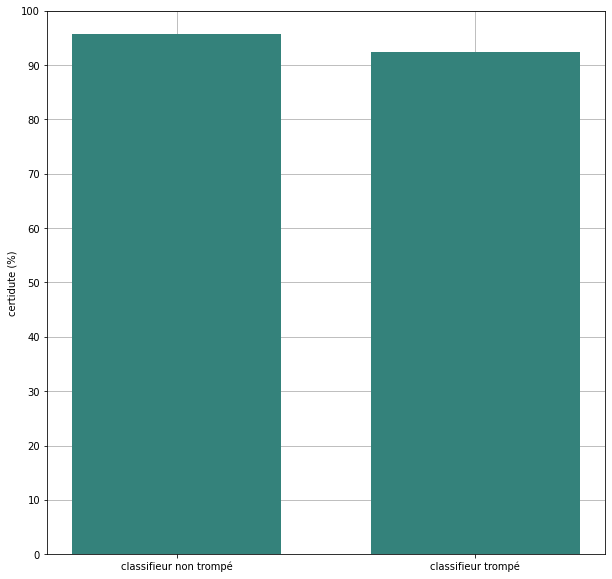

In [ ]:

plt.figure(figsize=(10,10))
plt.grid(zorder=0)
plt.yticks(np.arange(0, 110, 10))
plt.bar(["classifieur non trompé","classifieur trompé"],np.array([0.9568162412004002 ,0.9231977857180226 ])*100,0.7,zorder=3,color='#34827b')
plt.ylim(0,100)
# plt.xlabel('Number of images in X')
plt.ylabel('certidute (%)')
plt.show()

### ImageNet

#### Norm Calculation

In [ ]:
# norm without any transformation of the dataset
torch.manual_seed(1)
random.seed(1)
np.random.seed(1)
model, dataloader_train, _, _ = set_up_IMAGENET(train_size = 10000, test_size = 2, demonstration_size = 10, batch_size = 1)
print("norm inf:",get_mean_norm(dataloader_train))
print("norm 2:",get_mean_norm(dataloader_train,norm = 2))

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

norm inf: tensor(0.9817)
norm 2: tensor(197.6431)


In [ ]:
# norm with our transformation
torch.manual_seed(1)
random.seed(1)
np.random.seed(1)

transform = transforms.Compose([
                                transforms.Resize(256),
                                transforms.CenterCrop(224),
                                transforms.ToTensor(),
                                transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
                                ])

model, dataloader_train, _, _ = set_up_IMAGENET(train_size = 10000, test_size = 2, demonstration_size = 10, batch_size = 1, transform = transform)
print("norm inf:",get_mean_norm(dataloader_train))
print("norm 2:",get_mean_norm(dataloader_train,norm = 2))

norm inf: tensor(2.5132)
norm 2: tensor(450.1374)


#### Universal Perturbation

- data size: 100


Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

Iteration 0


Fooling ratio 0: 100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


train fooling ratio: tensor(0.1500)


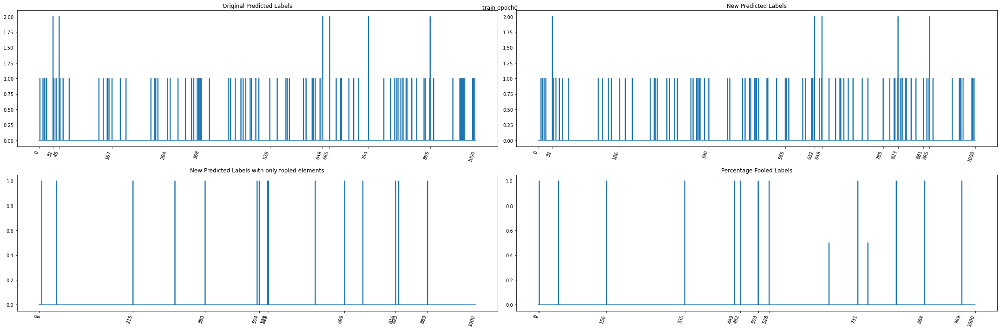

Test Fooling ratio 0: 100%|██████████| 100/100 [02:34<00:00,  1.54s/it]


test fooling ratio: tensor(0.0815)


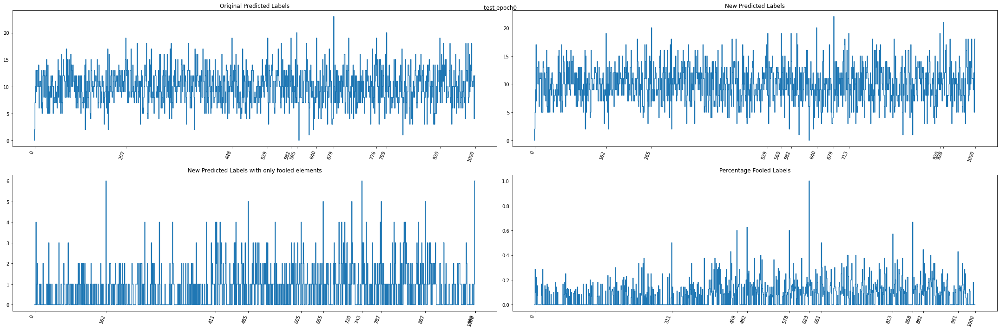

Iteration 1


Fooling ratio 1: 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


train fooling ratio: tensor(0.2000)


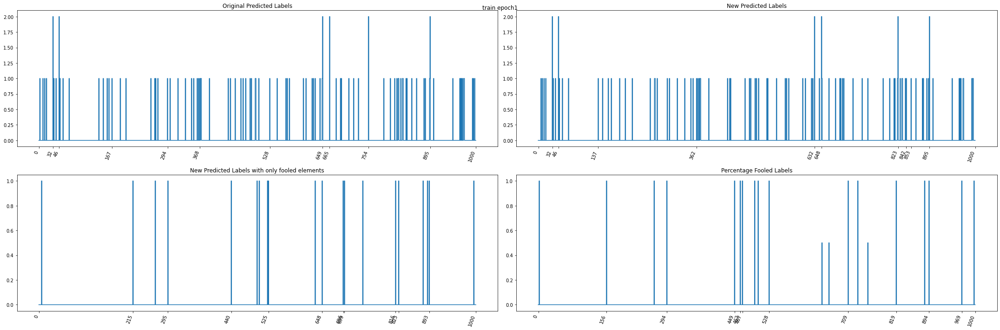

Test Fooling ratio 1: 100%|██████████| 100/100 [02:24<00:00,  1.44s/it]


test fooling ratio: tensor(0.0859)


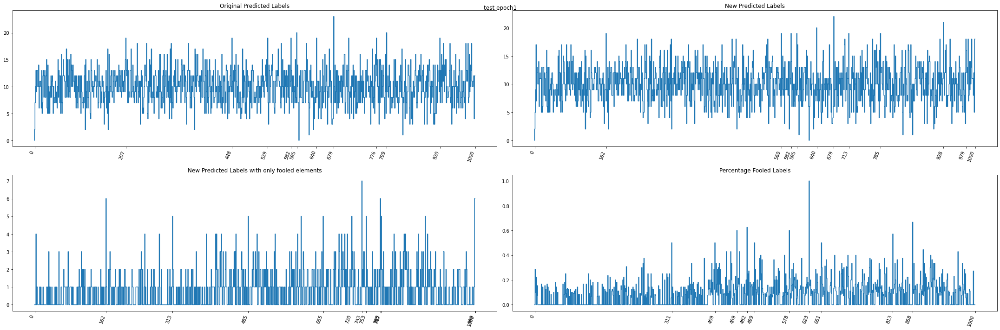

Iteration 2


Fooling ratio 2: 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


train fooling ratio: tensor(0.2100)


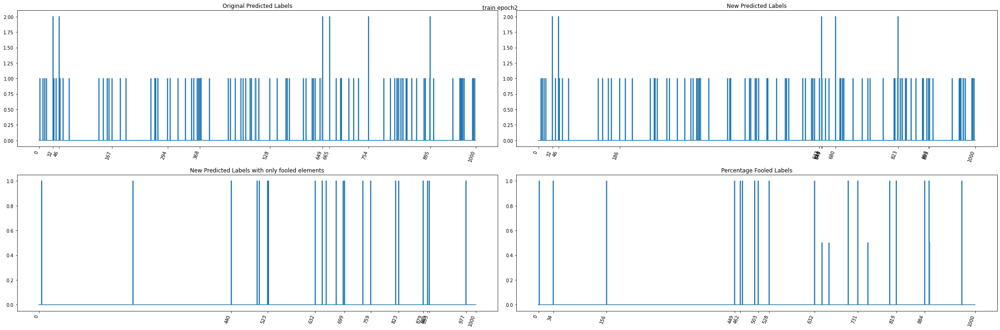

Test Fooling ratio 2: 100%|██████████| 100/100 [02:17<00:00,  1.38s/it]


test fooling ratio: tensor(0.0867)


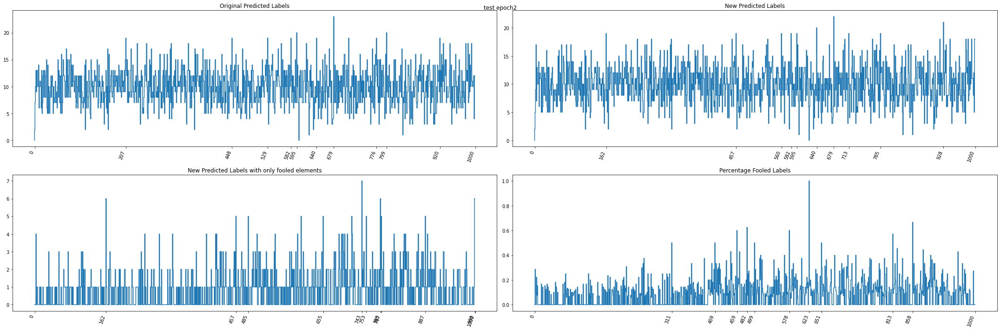

Iteration 3


Fooling ratio 3: 100%|██████████| 1/1 [00:01<00:00,  1.31s/it]


train fooling ratio: tensor(0.2400)


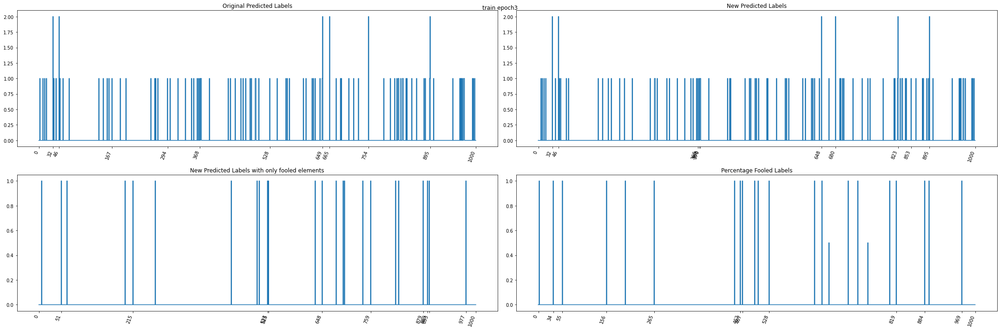

Test Fooling ratio 3: 100%|██████████| 100/100 [02:23<00:00,  1.43s/it]


test fooling ratio: tensor(0.0871)


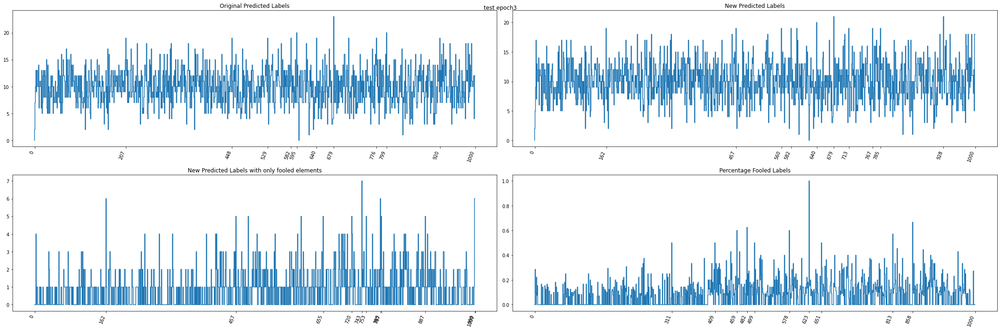

Iteration 4


Fooling ratio 4: 100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


train fooling ratio: tensor(0.2900)


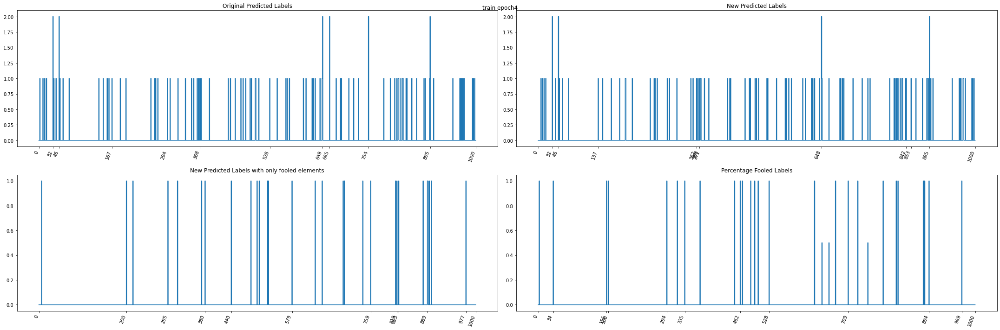

Test Fooling ratio 4: 100%|██████████| 100/100 [02:16<00:00,  1.37s/it]


test fooling ratio: tensor(0.0872)


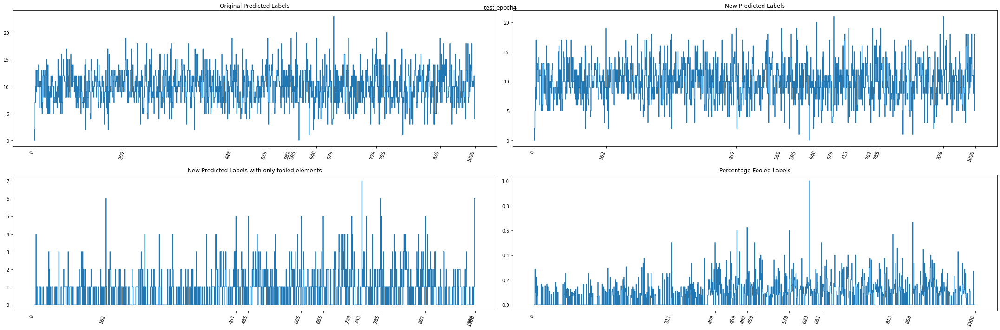

training fooling ratio: tensor(0.2900)
- data size: 500
Iteration 0


Fooling ratio 0: 100%|██████████| 5/5 [00:06<00:00,  1.34s/it]


train fooling ratio: tensor(0.2260)


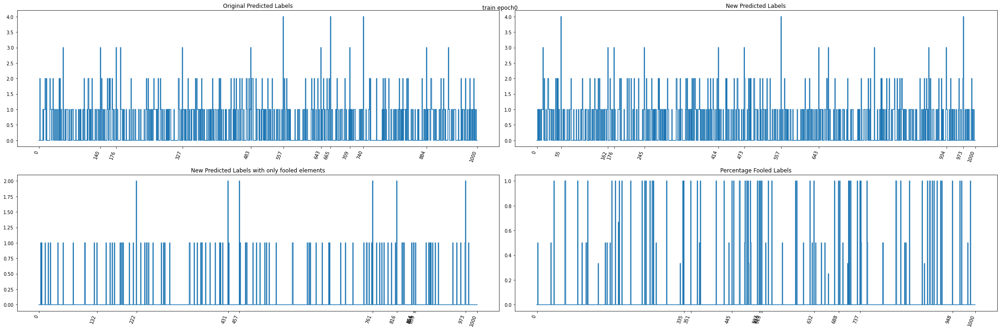

Test Fooling ratio 0: 100%|██████████| 100/100 [02:11<00:00,  1.31s/it]


test fooling ratio: tensor(0.1962)


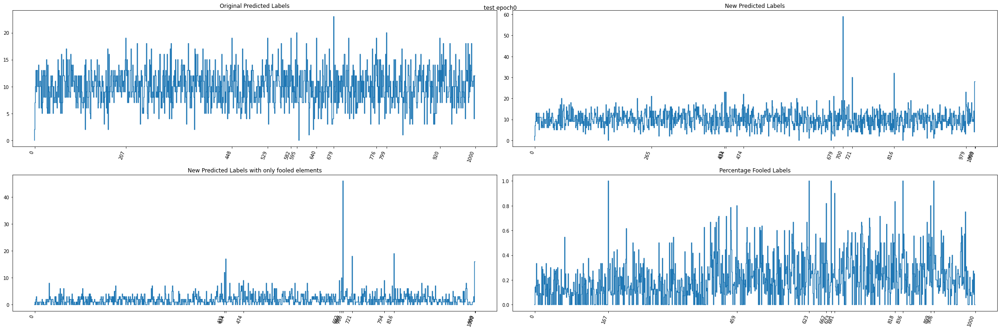

Iteration 1


Fooling ratio 1: 100%|██████████| 5/5 [00:06<00:00,  1.24s/it]


train fooling ratio: tensor(0.3180)


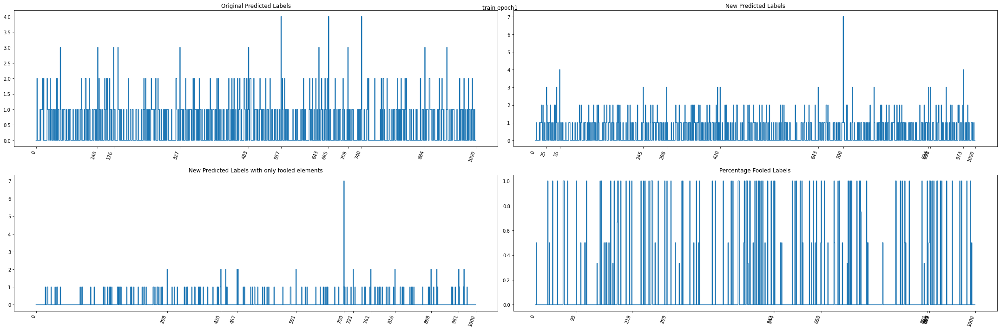

Test Fooling ratio 1: 100%|██████████| 100/100 [02:11<00:00,  1.31s/it]


test fooling ratio: tensor(0.2238)


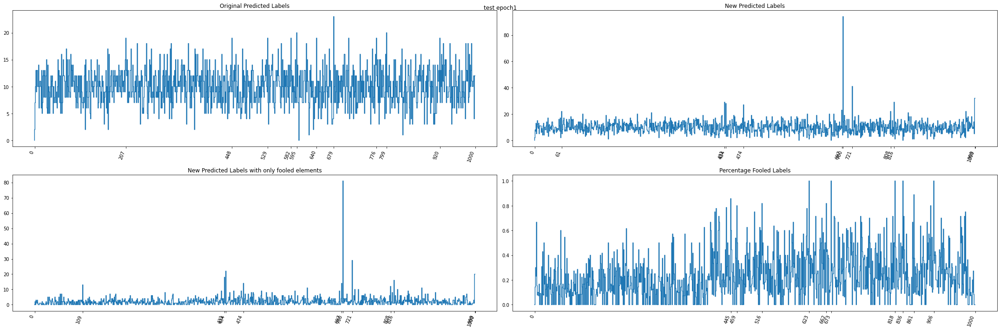

Iteration 2


Fooling ratio 2: 100%|██████████| 5/5 [00:06<00:00,  1.26s/it]


train fooling ratio: tensor(0.3500)


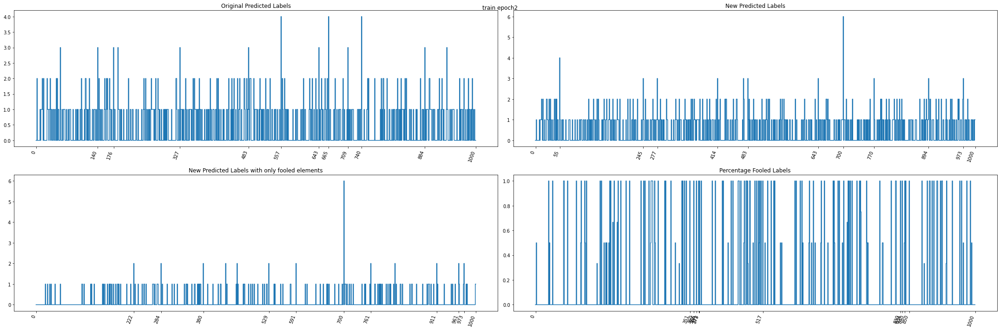

Test Fooling ratio 2: 100%|██████████| 100/100 [02:14<00:00,  1.35s/it]


test fooling ratio: tensor(0.2270)


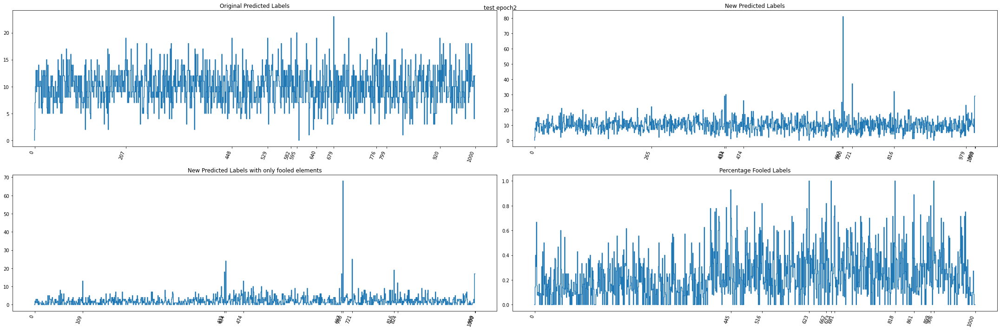

Iteration 3


Fooling ratio 3: 100%|██████████| 5/5 [00:06<00:00,  1.31s/it]


train fooling ratio: tensor(0.3720)


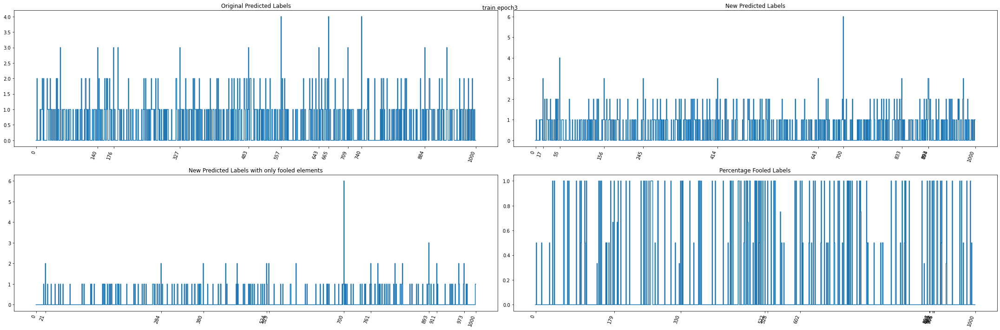

Test Fooling ratio 3: 100%|██████████| 100/100 [02:19<00:00,  1.40s/it]


test fooling ratio: tensor(0.2275)


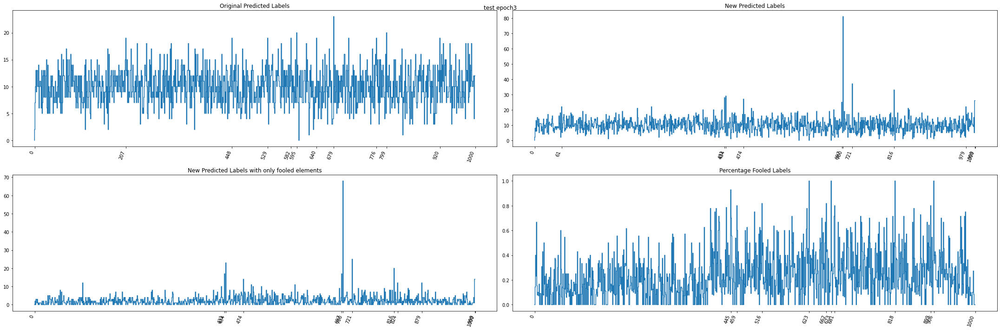

Iteration 4


Fooling ratio 4: 100%|██████████| 5/5 [00:06<00:00,  1.25s/it]


train fooling ratio: tensor(0.3760)


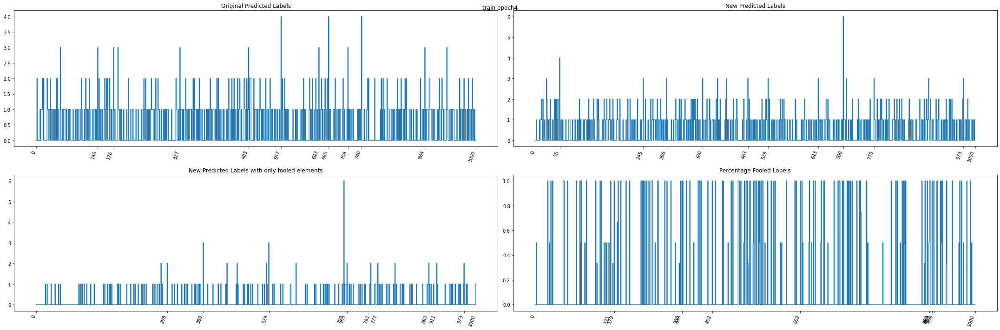

Test Fooling ratio 4: 100%|██████████| 100/100 [02:11<00:00,  1.32s/it]


test fooling ratio: tensor(0.2292)


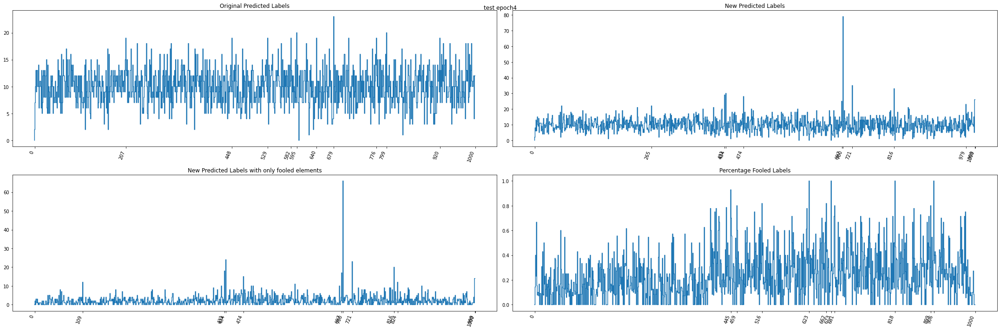

training fooling ratio: tensor(0.3760)
- data size: 1000
Iteration 0


Fooling ratio 0: 100%|██████████| 10/10 [00:12<00:00,  1.25s/it]


train fooling ratio: tensor(0.3970)


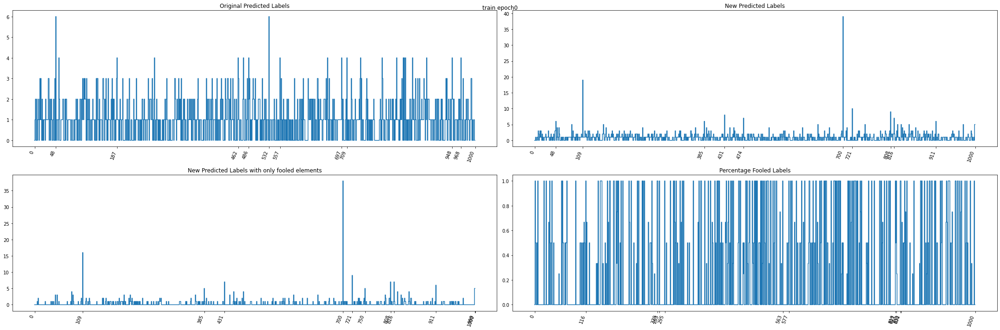

Test Fooling ratio 0: 100%|██████████| 100/100 [02:12<00:00,  1.32s/it]


test fooling ratio: tensor(0.3679)


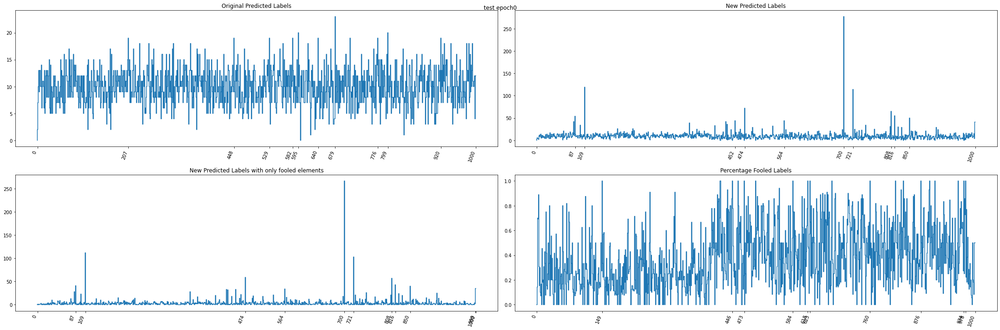

Iteration 1


Fooling ratio 1: 100%|██████████| 10/10 [00:12<00:00,  1.30s/it]


train fooling ratio: tensor(0.4900)


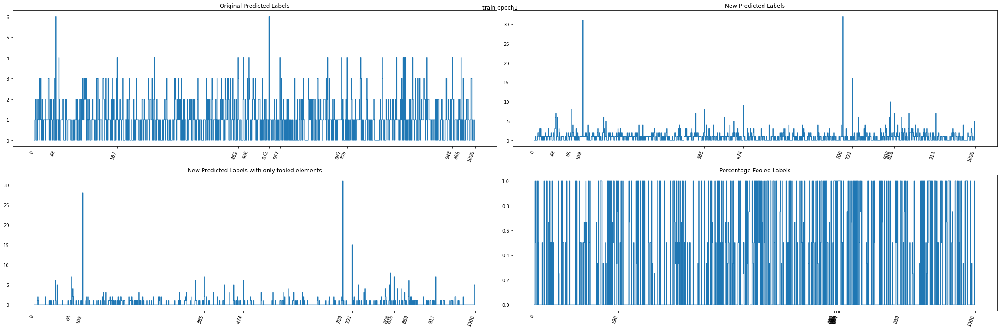

Test Fooling ratio 1: 100%|██████████| 100/100 [02:19<00:00,  1.40s/it]


test fooling ratio: tensor(0.4161)


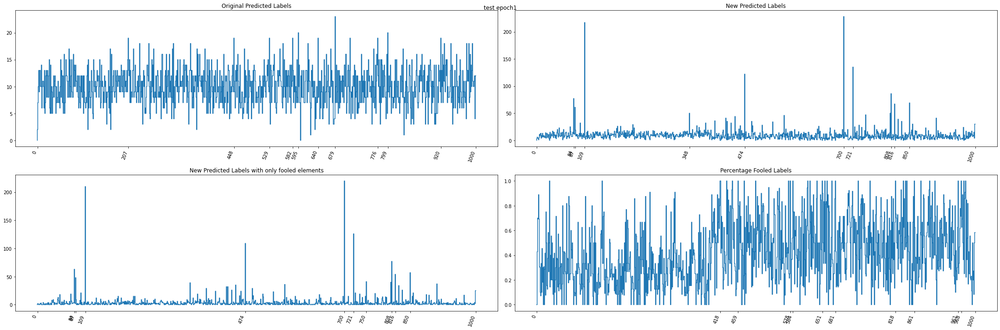

Iteration 2


Fooling ratio 2: 100%|██████████| 10/10 [00:13<00:00,  1.33s/it]


train fooling ratio: tensor(0.5300)


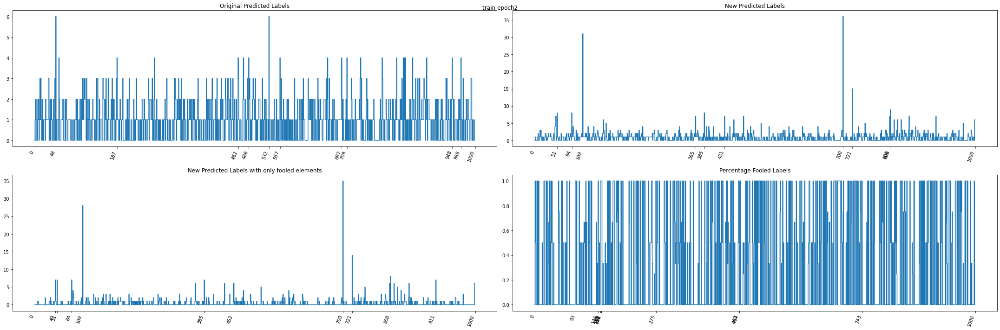

Test Fooling ratio 2: 100%|██████████| 100/100 [02:16<00:00,  1.37s/it]


test fooling ratio: tensor(0.4320)


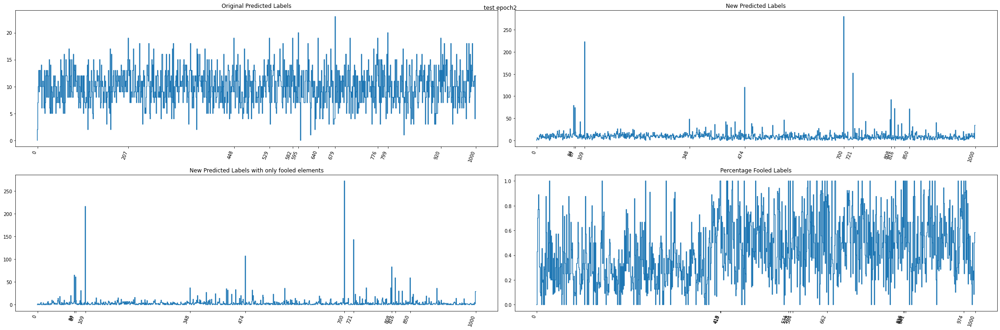

Iteration 3


Fooling ratio 3: 100%|██████████| 10/10 [00:12<00:00,  1.26s/it]


train fooling ratio: tensor(0.5520)


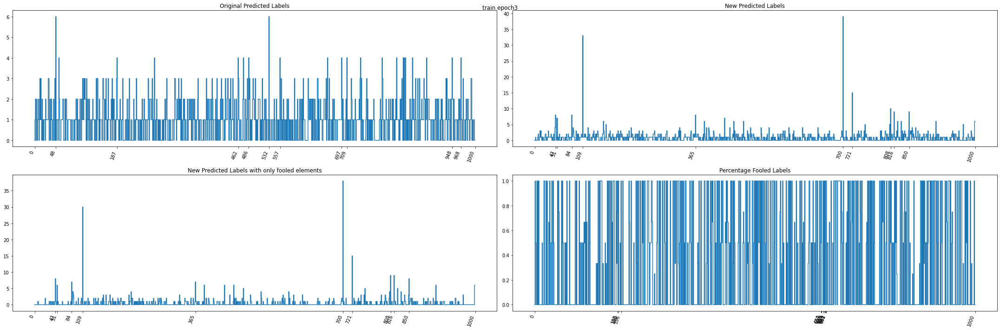

Test Fooling ratio 3: 100%|██████████| 100/100 [02:12<00:00,  1.32s/it]


test fooling ratio: tensor(0.4369)


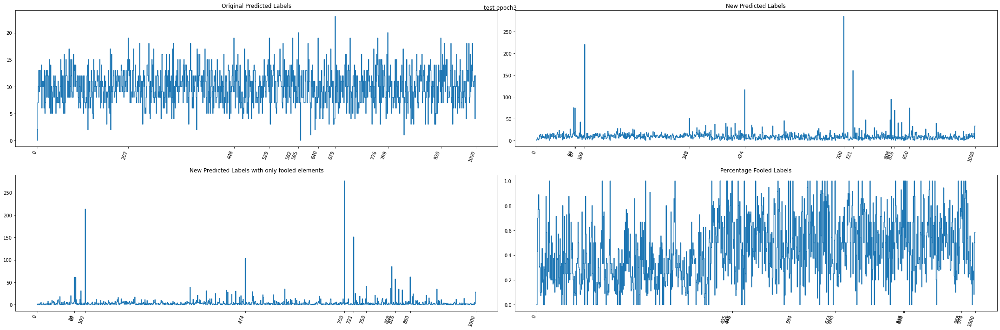

Iteration 4


Fooling ratio 4: 100%|██████████| 10/10 [00:12<00:00,  1.27s/it]


train fooling ratio: tensor(0.5640)


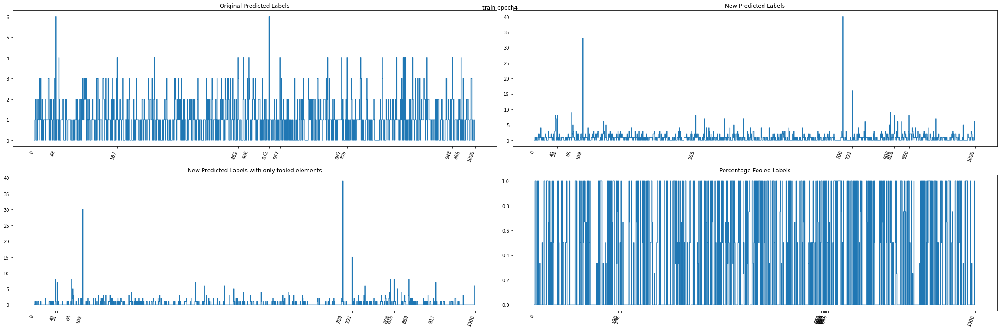

Test Fooling ratio 4: 100%|██████████| 100/100 [02:12<00:00,  1.33s/it]


test fooling ratio: tensor(0.4385)


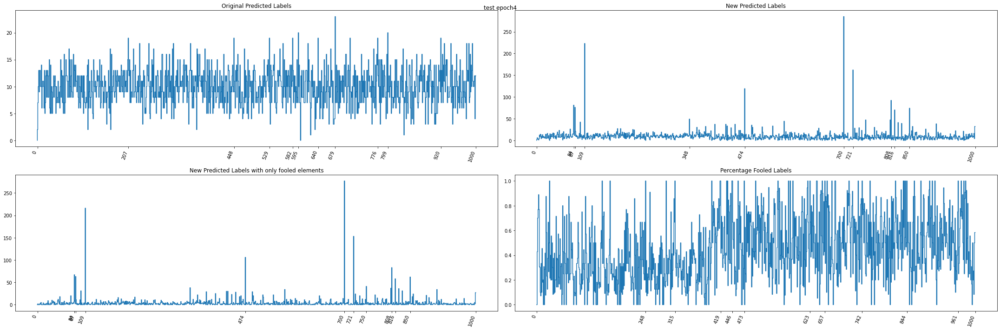

training fooling ratio: tensor(0.5640)
- data size: 2000
Iteration 0


Fooling ratio 0: 100%|██████████| 20/20 [00:25<00:00,  1.27s/it]


train fooling ratio: tensor(0.5400)


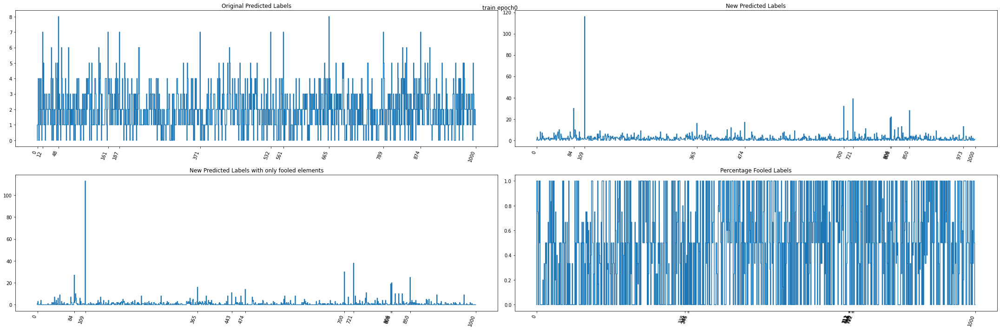

Test Fooling ratio 0: 100%|██████████| 100/100 [02:13<00:00,  1.33s/it]


test fooling ratio: tensor(0.5056)


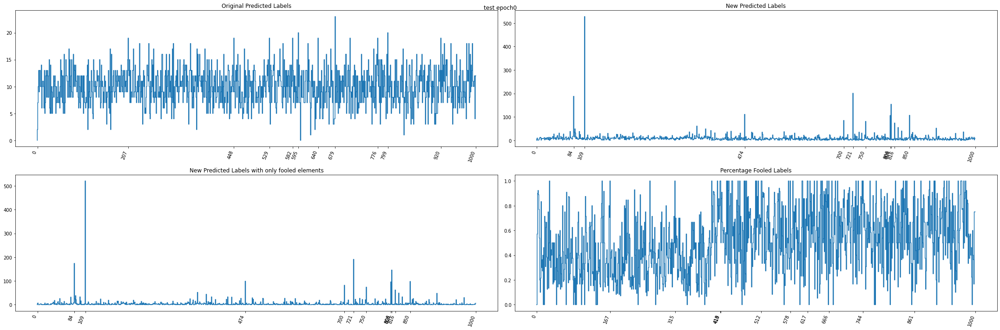

Iteration 1


Fooling ratio 1: 100%|██████████| 20/20 [00:26<00:00,  1.31s/it]


train fooling ratio: tensor(0.6325)


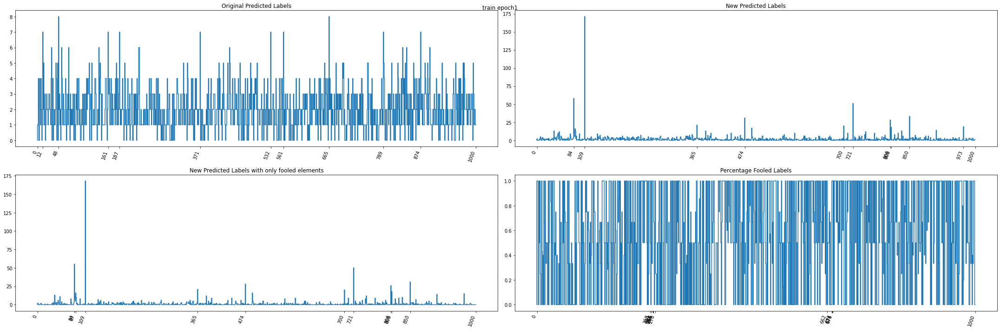

Test Fooling ratio 1: 100%|██████████| 100/100 [02:12<00:00,  1.33s/it]


test fooling ratio: tensor(0.5725)


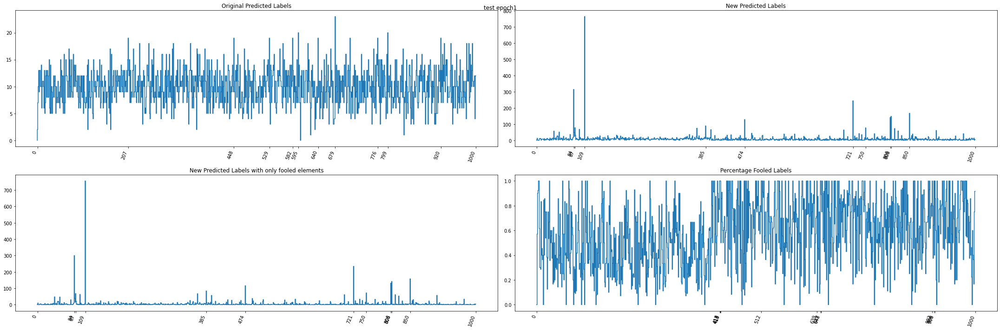

Iteration 2


Fooling ratio 2: 100%|██████████| 20/20 [00:25<00:00,  1.27s/it]


train fooling ratio: tensor(0.6530)


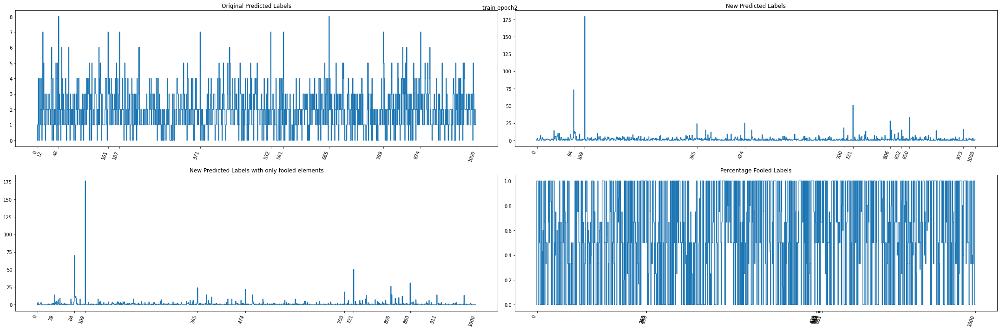

Test Fooling ratio 2: 100%|██████████| 100/100 [02:13<00:00,  1.33s/it]


test fooling ratio: tensor(0.5847)


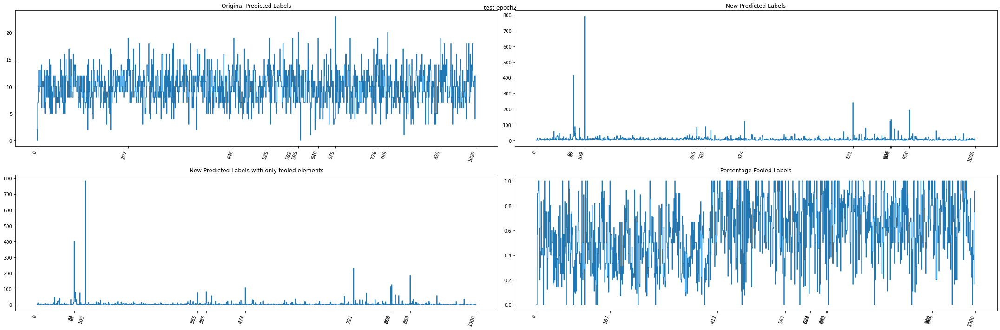

Iteration 3


Fooling ratio 3: 100%|██████████| 20/20 [00:25<00:00,  1.28s/it]


train fooling ratio: tensor(0.6700)


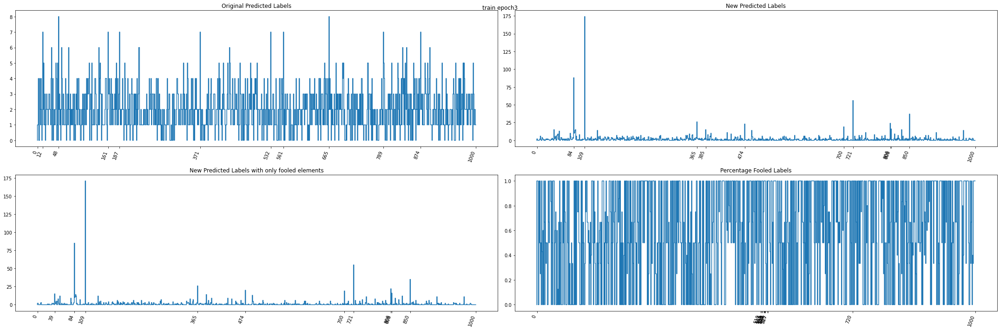

Test Fooling ratio 3: 100%|██████████| 100/100 [02:13<00:00,  1.33s/it]


test fooling ratio: tensor(0.5940)


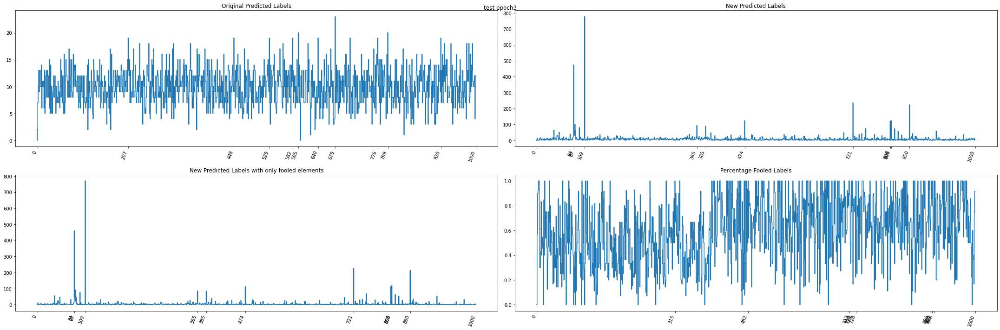

Iteration 4


Fooling ratio 4: 100%|██████████| 20/20 [00:25<00:00,  1.28s/it]


train fooling ratio: tensor(0.6900)


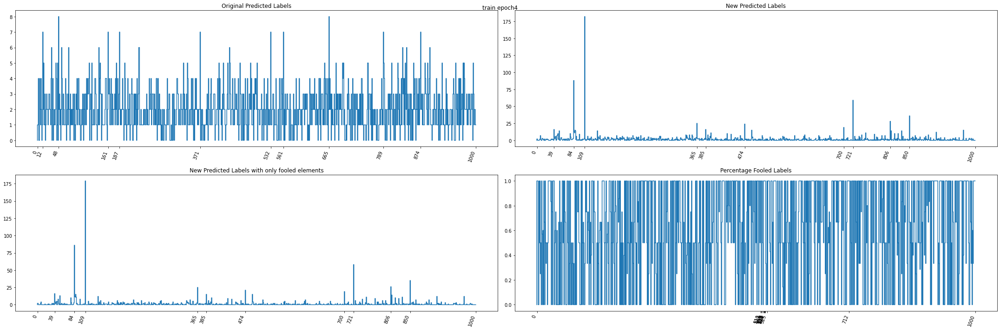

Test Fooling ratio 4: 100%|██████████| 100/100 [02:16<00:00,  1.36s/it]


test fooling ratio: tensor(0.6023)


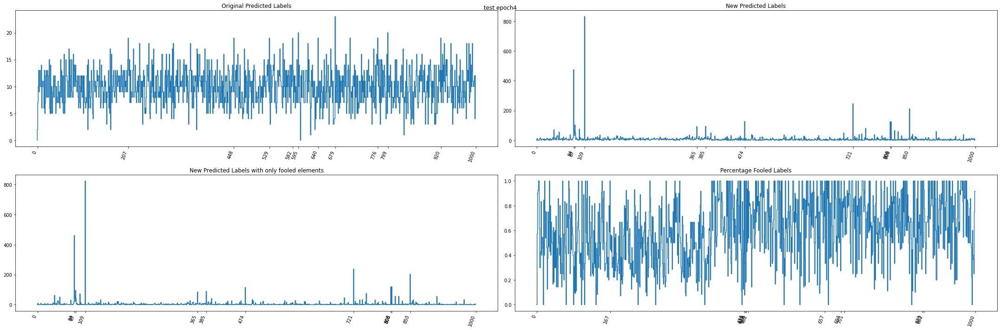

training fooling ratio: tensor(0.6900)
- data size: 4000
Iteration 0


Fooling ratio 0: 100%|██████████| 40/40 [00:51<00:00,  1.29s/it]


train fooling ratio: tensor(0.6582)


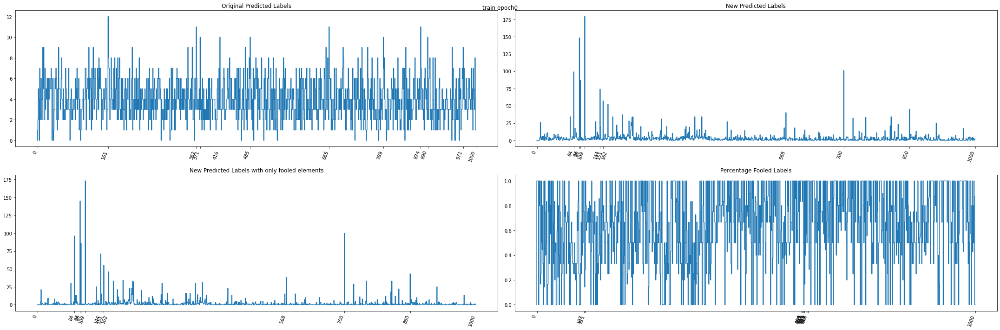

Test Fooling ratio 0: 100%|██████████| 100/100 [02:13<00:00,  1.34s/it]


test fooling ratio: tensor(0.6415)


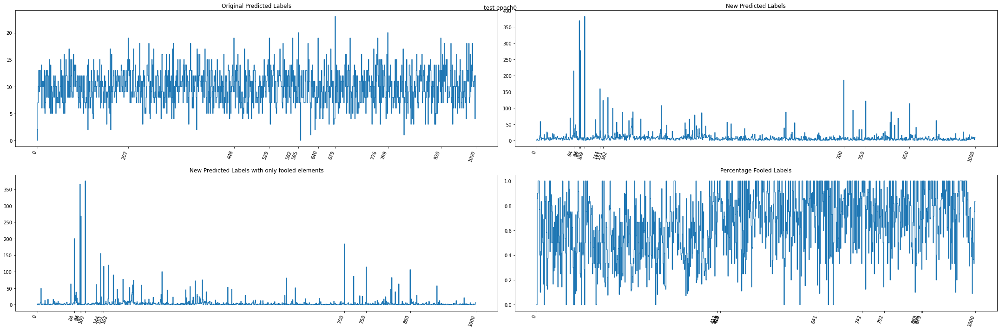

Iteration 1


Fooling ratio 1: 100%|██████████| 40/40 [00:52<00:00,  1.32s/it]


train fooling ratio: tensor(0.7333)


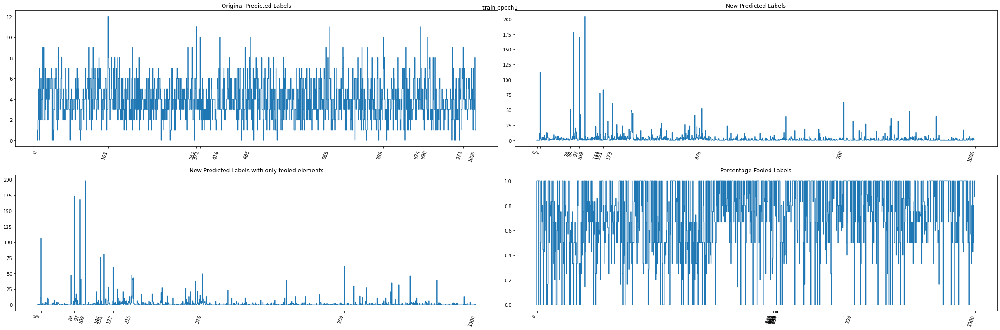

Test Fooling ratio 1: 100%|██████████| 100/100 [02:19<00:00,  1.39s/it]


test fooling ratio: tensor(0.6980)


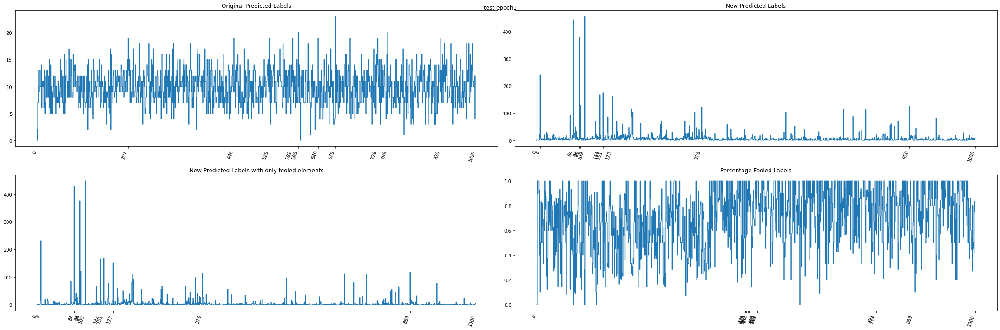

Iteration 2


Fooling ratio 2: 100%|██████████| 40/40 [00:54<00:00,  1.36s/it]


train fooling ratio: tensor(0.7713)


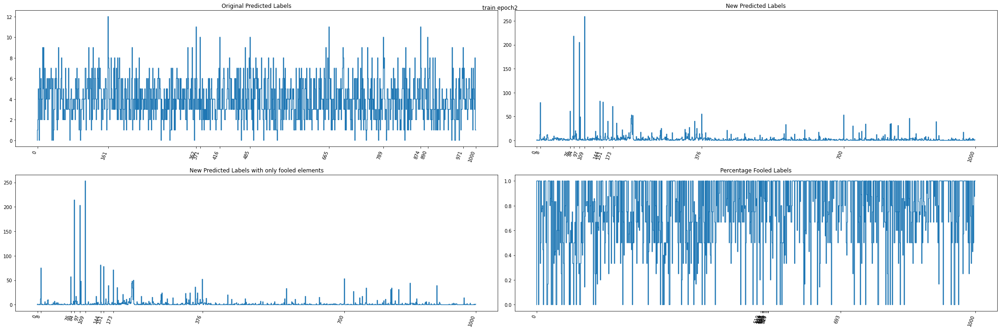

Test Fooling ratio 2: 100%|██████████| 100/100 [02:23<00:00,  1.43s/it]


test fooling ratio: tensor(0.7228)


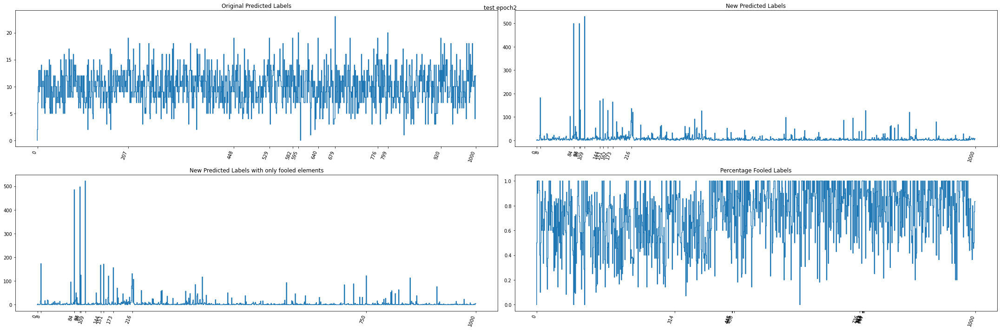

Iteration 3


Fooling ratio 3: 100%|██████████| 40/40 [00:55<00:00,  1.38s/it]


train fooling ratio: tensor(0.7770)


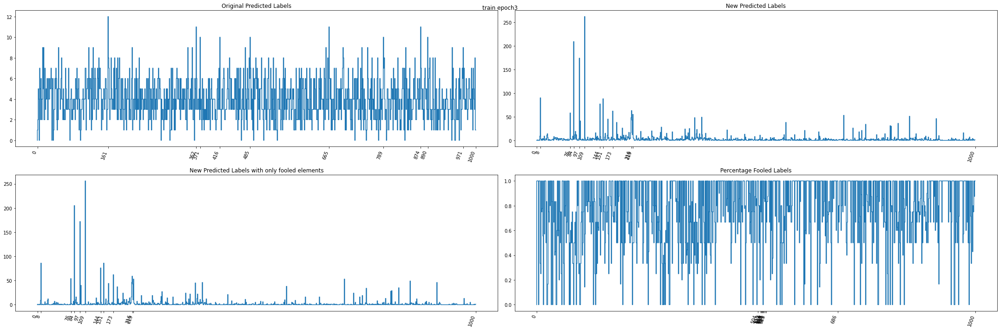

Test Fooling ratio 3: 100%|██████████| 100/100 [02:13<00:00,  1.33s/it]


test fooling ratio: tensor(0.7273)


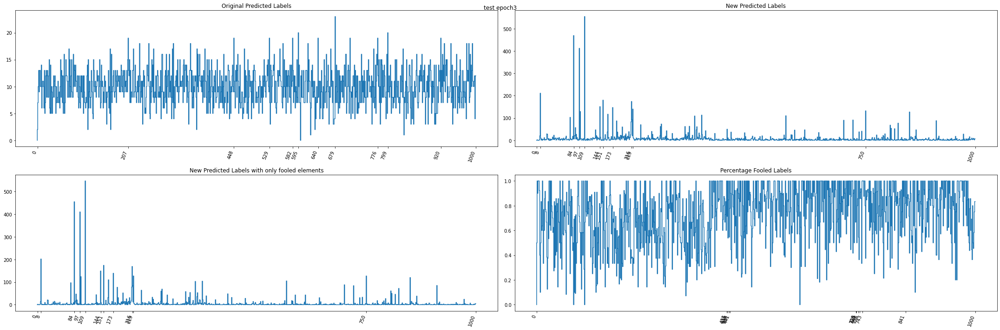

Iteration 4


Fooling ratio 4: 100%|██████████| 40/40 [00:52<00:00,  1.31s/it]


train fooling ratio: tensor(0.7895)


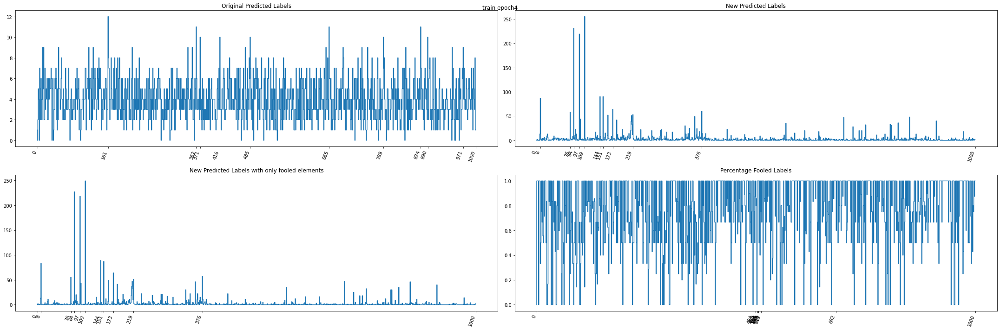

Test Fooling ratio 4: 100%|██████████| 100/100 [02:16<00:00,  1.37s/it]


test fooling ratio: tensor(0.7380)


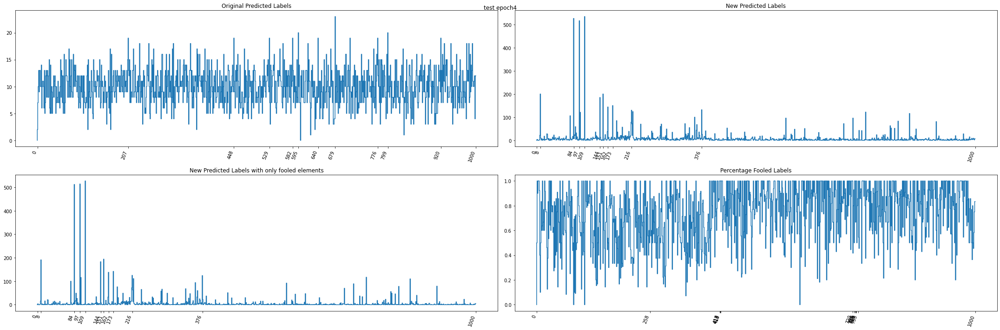

training fooling ratio: tensor(0.7895)
- data size: 10000
Iteration 0


Fooling ratio 0: 100%|██████████| 100/100 [02:09<00:00,  1.29s/it]


train fooling ratio: tensor(0.7805)


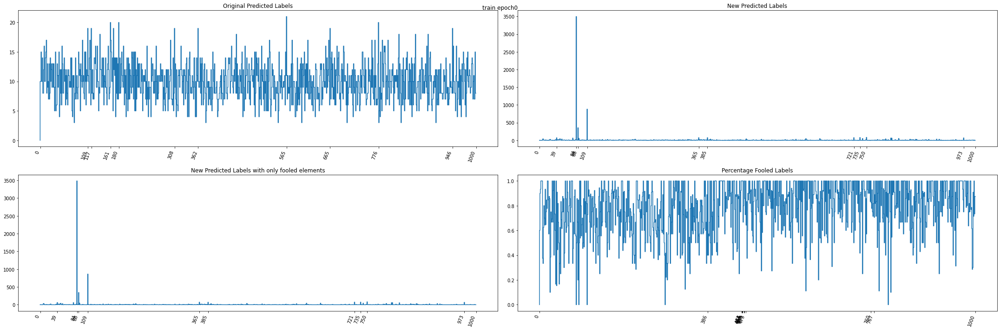

Test Fooling ratio 0: 100%|██████████| 100/100 [02:15<00:00,  1.35s/it]


test fooling ratio: tensor(0.7695)


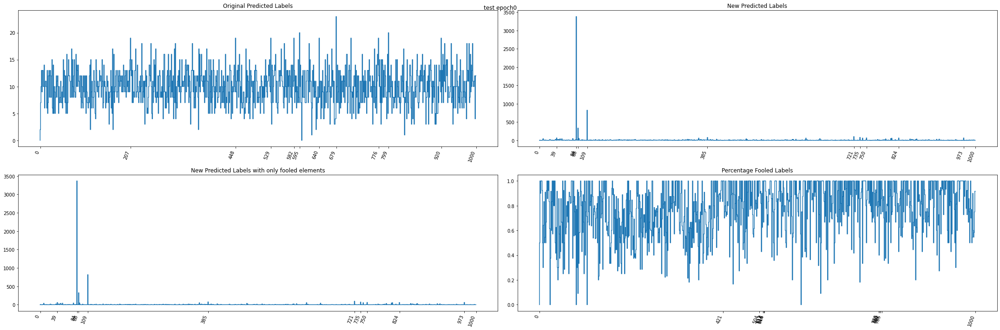

Iteration 1


Fooling ratio 1: 100%|██████████| 100/100 [02:11<00:00,  1.31s/it]


train fooling ratio: tensor(0.8358)


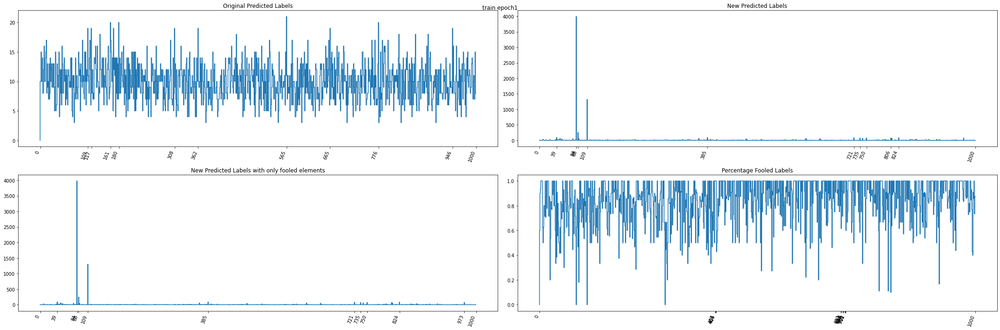

Test Fooling ratio 1: 100%|██████████| 100/100 [02:15<00:00,  1.36s/it]


test fooling ratio: tensor(0.8187)


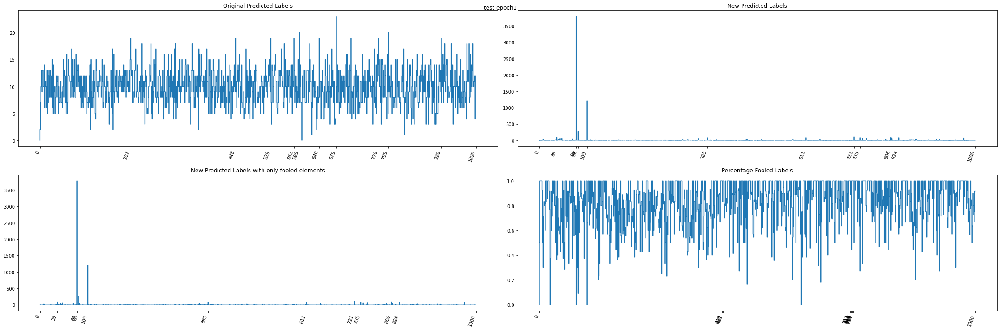

Iteration 2


Fooling ratio 2: 100%|██████████| 100/100 [02:11<00:00,  1.31s/it]


train fooling ratio: tensor(0.8465)


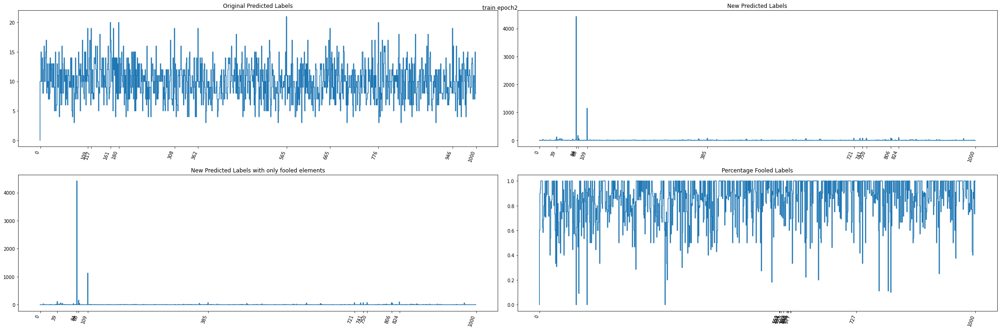

Test Fooling ratio 2: 100%|██████████| 100/100 [02:13<00:00,  1.34s/it]


test fooling ratio: tensor(0.8324)


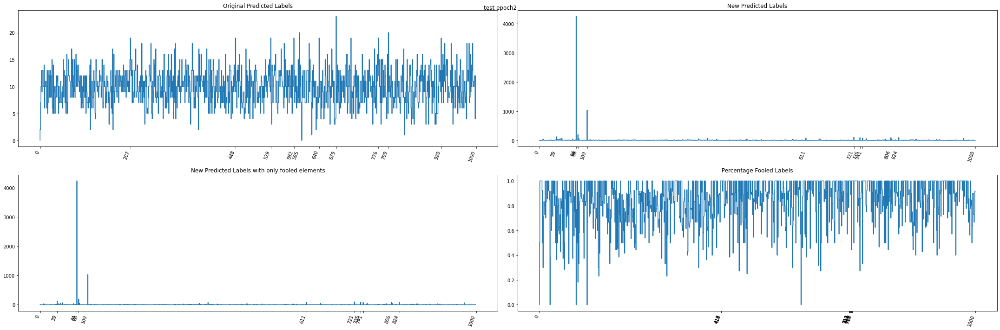

Iteration 3


Fooling ratio 3: 100%|██████████| 100/100 [02:09<00:00,  1.29s/it]


train fooling ratio: tensor(0.8525)


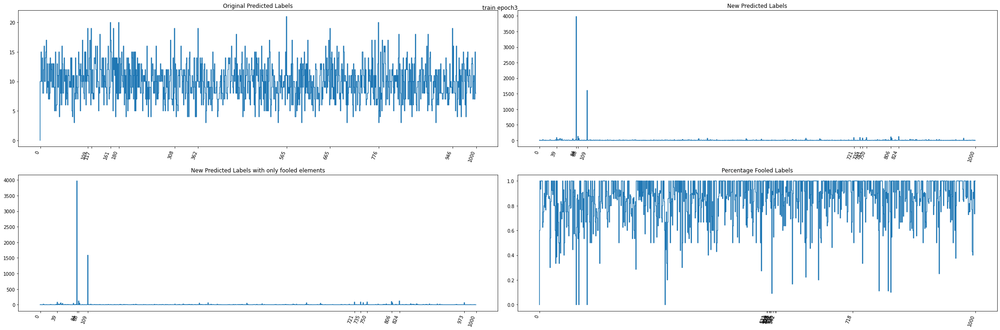

Test Fooling ratio 3: 100%|██████████| 100/100 [02:13<00:00,  1.34s/it]


test fooling ratio: tensor(0.8360)


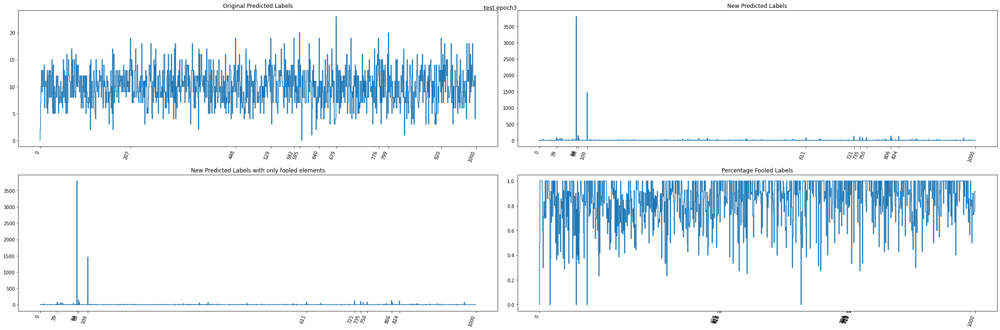

Iteration 4


Fooling ratio 4: 100%|██████████| 100/100 [02:09<00:00,  1.29s/it]


train fooling ratio: tensor(0.8790)


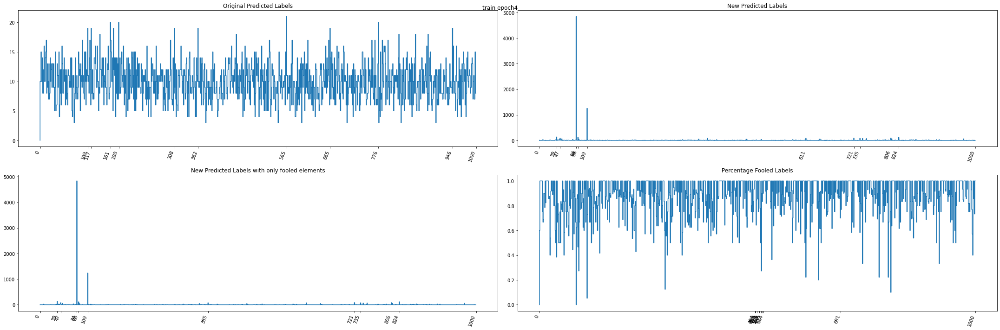

Test Fooling ratio 4: 100%|██████████| 100/100 [02:14<00:00,  1.34s/it]


test fooling ratio: tensor(0.8553)


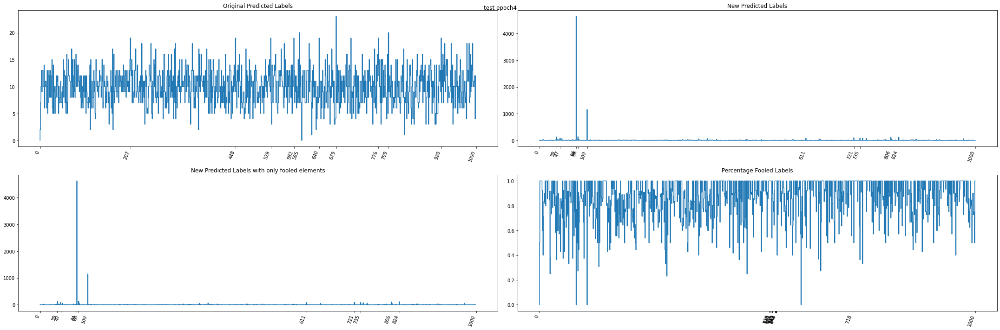

training fooling ratio: tensor(0.8790)


In [ ]:

sizes = [100, 500,1000, 2000, 4000, 10000]
xi =  10/255
delta = 0.1
device = ('cuda' if torch.cuda.is_available() else 'cpu')
for data_size in sizes:
  print("- data size:",data_size)
  log_dir = os.path.join(save_path,"logs/"+datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + "_delta" + str(delta) + "_xi" + str(xi) + "_datasize" + str(data_size) + "_IMAGENET")
  writer = SummaryWriter(log_dir)
  torch.manual_seed(1)
  random.seed(1)
  np.random.seed(1)
  model, dataloader_train, dataloader_test, _ = set_up_IMAGENET(train_size = data_size, test_size = 10000, demonstration_size = 10, batch_size = 100)
  result = generate(dataloader_train,dataloader_test, model, writer, device, delta = delta, max_iter_uni=5, xi=xi, p=np.inf, num_classes=10, overshoot=0.02, max_iter_df=10, image_size = [3,224,224], total_class = 1000, plot_only_last = False)
  torch.save(result,os.path.join(save_path, "result_"+str(data_size)+"_IMAGENET"))
  print("training fooling ratio:", result[1])


#### Perturbation Visualization

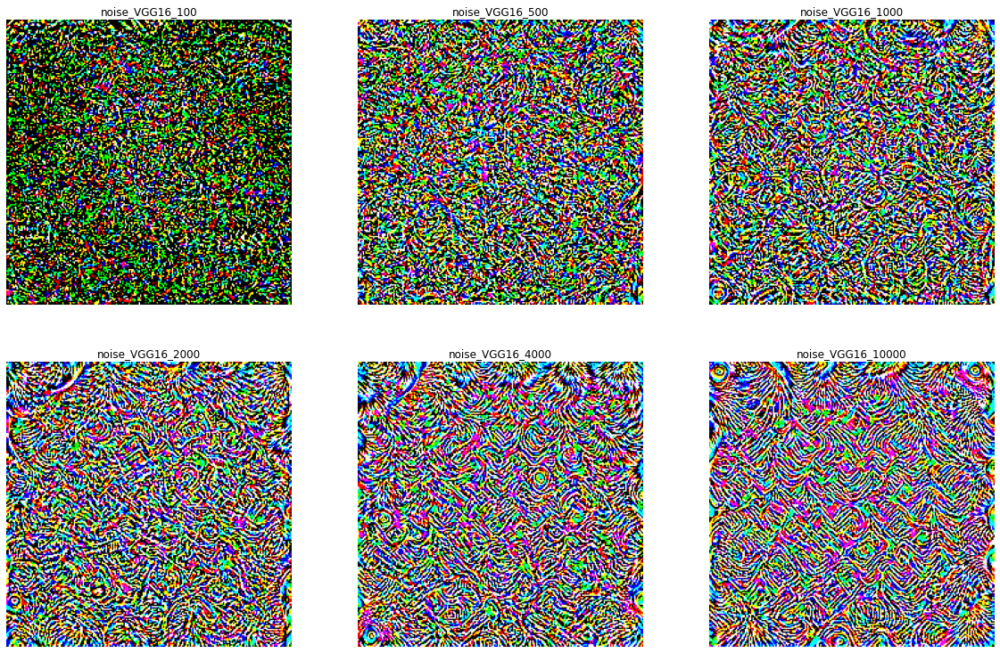

In [ ]:
sizes = [100, 500, 1000, 2000, 4000, 10000]

trans = transforms.ToPILImage()
plt.figure(figsize=(20,20))
for i, data_size in enumerate(sizes):
  result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_IMAGENET"))
  plt.subplot(len(sizes)//3 + 1, 3, i + 1)
  plt.imshow(trans(result[0]))
  plt.title('noise_VGG16_'+ str(data_size))
  plt.axis('off')
plt.show()


#### Result Visualization

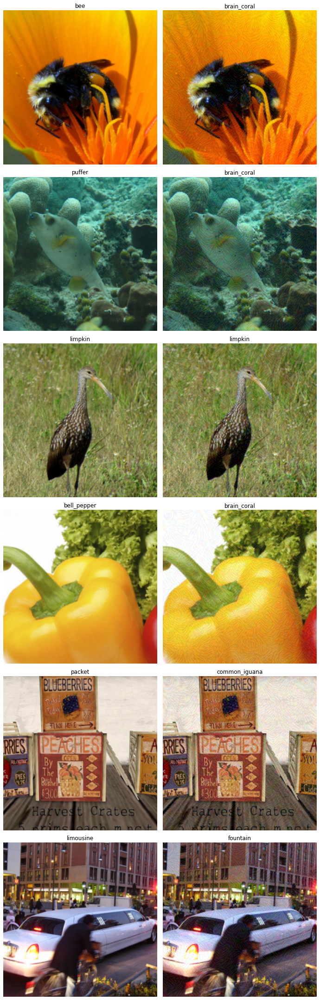

In [ ]:
data_size = 10000

torch.manual_seed(4)
random.seed(4)
np.random.seed(4)
with open('image_net/imagenet_class_index.json') as json_file:
    classes = json.load(json_file)
    classes = {int(k):v[1] for k,v in classes.items()}
model, _, _, demonstration_set = set_up_IMAGENET(train_size = 2, test_size = 2, demonstration_size = 6, batch_size = 1)
result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_IMAGENET"))
v = result[0]

plt.figure(figsize=(10,30))
for i, (img, _) in enumerate(demonstration_set):
  
  transformed_img = torch.clip(img + v,0,1)

  label = int(torch.argmax(model(img.unsqueeze(0)),dim = 1)[0])
  new_label = int(torch.argmax(model(transformed_img.unsqueeze(0)),dim = 1)[0])

  img = img.transpose(0,1).transpose(1,2)
  transformed_img = transformed_img.transpose(0,1).transpose(1,2)

  plt.subplot(6, 2, i*2 + 1)
  plt.imshow(img)
  plt.title(classes[label])
  plt.axis('off')

  plt.subplot(6 ,2 , i*2 + 2)
  plt.imshow(transformed_img)
  plt.title(classes[new_label])
  plt.axis('off')
plt.tight_layout()

plt.show()

#### Final Fooling Rates

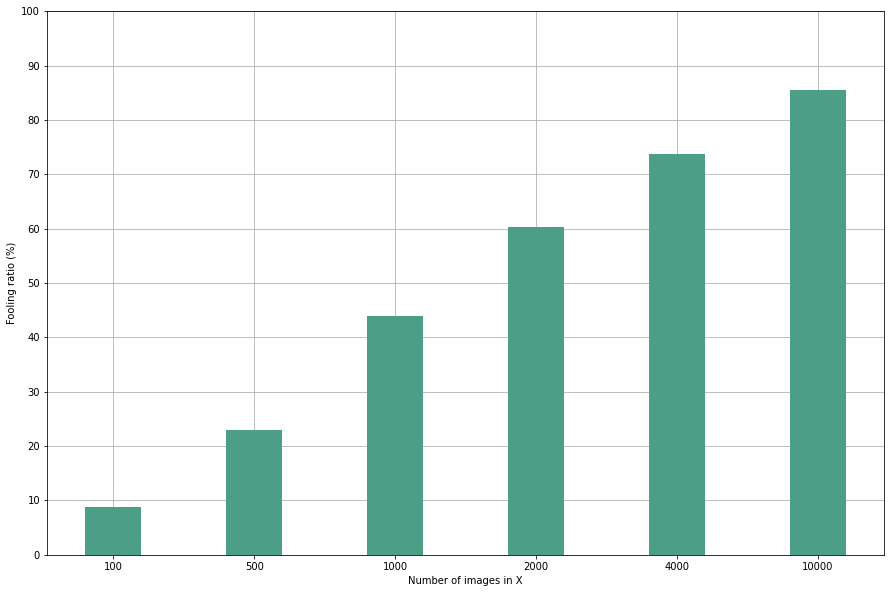

In [ ]:
sizes = [100, 500, 1000, 2000, 4000, 10000]

fooling_rates = torch.zeros(len(sizes))
for i, data_size in enumerate(sizes):
  result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_IMAGENET"))
  fooling_rates[i] = result[2]


plt.figure(figsize=(15,10))
plt.grid(zorder=0)
plt.yticks(np.arange(0, 110, 10))
plt.bar([str(x) for x in sizes],fooling_rates*100,0.4,zorder=3,color='#4c9f86')
plt.ylim(0,100)
plt.xlabel('Number of images in X')
plt.ylabel('Fooling ratio (%)')
plt.show()


#### Fooling Distribution

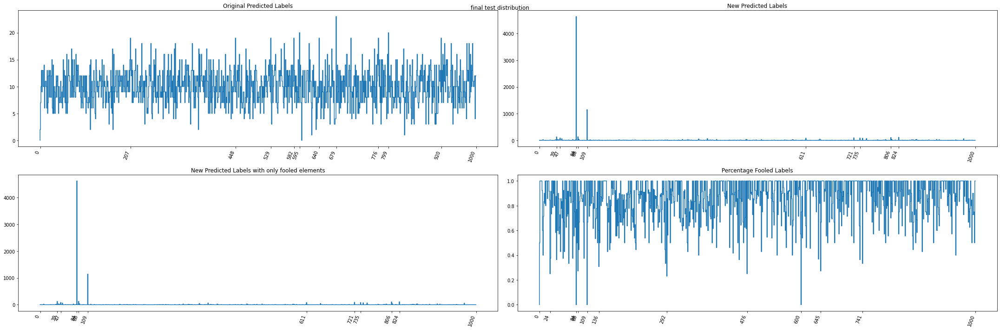

In [ ]:
data_size = 10000
result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_IMAGENET"))
plot(result[4],"final test distribution",1000)

#### Fooling Rate Evolution


In [ ]:
log_path = os.path.join(save_path,"logs/IMAGENET")
%load_ext tensorboard
%tensorboard --logdir $log_path

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 670), started 1:28:53 ago. (Use '!kill 670' to kill it.)

<IPython.core.display.Javascript object>

#### Graph

In [ ]:
data_size = 10000
nb_class = 1000

torch.manual_seed(1)
random.seed(1)
np.random.seed(1)

with open('image_net/imagenet_class_index.json') as json_file:
    classes = json.load(json_file)
    classes = {int(k):v[1] for k,v in classes.items()}
model, _, dataloader_test, _ = set_up_IMAGENET(train_size = 1, test_size = 10000, demonstration_size = 6, batch_size = 1)
result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_IMAGENET"))
v = result[0]

Matrice = torch.zeros((nb_class,nb_class))
device = ('cuda' if torch.cuda.is_available() else 'cpu')

model = model.to(device)
for k, (image, _) in enumerate(dataloader_test):
    image = image.to(device)
    _, pred = torch.max(model(image),1)
    _, adv_pred = torch.max(model(image+v.unsqueeze(0).to(device)), 1)
    Matrice[adv_pred.item(),pred.item()] += 1
Matrice = Matrice.fill_diagonal_(0)

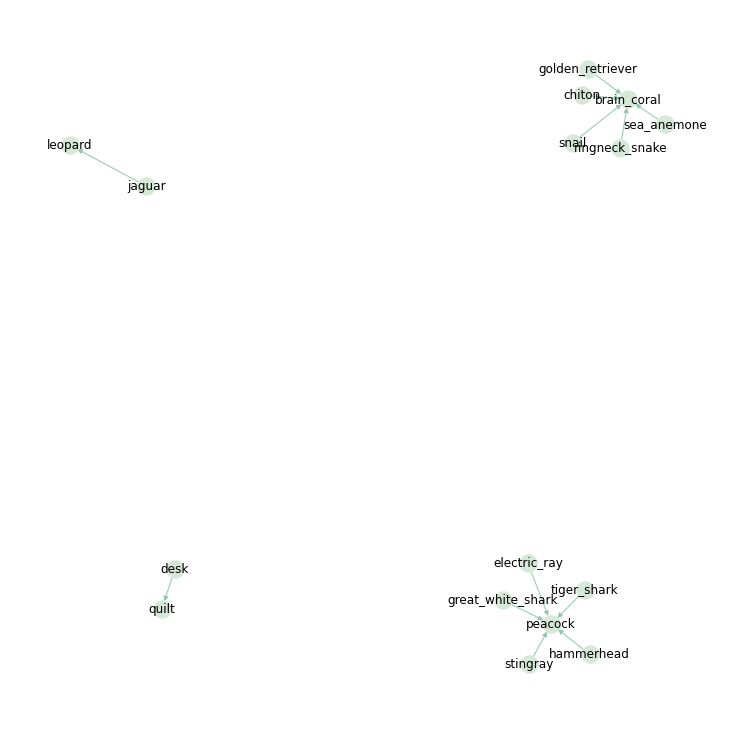

In [ ]:
seuil_aimant = 3
seuil_connexion = 5
nb_class = 1000
max_connexion = 5

maxs = torch.arange(nb_class)[Matrice.sum(axis=1) > seuil_aimant]
list_index_maxs = [torch.arange(nb_class)[l] for l in Matrice[maxs] > seuil_connexion]

plt.figure(figsize=(10,10))
g = nx.DiGraph()
for i, max in enumerate(maxs):
  for j, k in  enumerate(list_index_maxs[i]):
      if j<max_connexion:
        g.add_edge(classes[k.item()], classes[max.item()])

nx.draw(g, node_color='#d6e8d7', edge_color='#90c9a9',with_labels=True)
plt.draw()

#### Certainty in Classification and Fooling

In [ ]:
data_size = 10000
nb_class = 1000

torch.manual_seed(1)
random.seed(1)
np.random.seed(1)

with open('image_net/imagenet_class_index.json') as json_file:
    classes = json.load(json_file)
    classes = {int(k):v[1] for k,v in classes.items()}
model, _, dataloader_test, _ = set_up_IMAGENET(train_size = 1, test_size = 10000, demonstration_size = 6, batch_size = 1)
result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_IMAGENET"))
v = result[0]

device = ('cuda' if torch.cuda.is_available() else 'cpu')

nb_fooled = 0
nb_not_fooled = 0
p_fooled = 0
p_not_fooled = 0
max_p_fooled = 0
min_p_fooled = 1
max_p_not_fooled = 0
min_p_not_fooled = 1

model = model.to(device)
for k, (image, _) in enumerate(dataloader_test):
    image = image.to(device)
    p, pred = torch.max(nn.functional.softmax(model(image), 1),1)
    _, adv_pred = torch.max(model(image+v.unsqueeze(0).to(device)), 1)


    if pred.item() != adv_pred.item():
      if p.item() > max_p_fooled:
        max_p_fooled = p.item()
      if p.item() < min_p_fooled:
        min_p_fooled = p.item()
      p_fooled += p.item()
      
      nb_fooled += 1
    else:
      if p.item() > max_p_not_fooled:
        max_p_not_fooled = p.item()
      if p.item() < min_p_not_fooled:
        min_p_not_fooled = p.item()

      p_not_fooled += p.item()
      nb_not_fooled += 1
print("Mean Certainty when Fooled:",p_fooled/nb_fooled,"with max",max_p_fooled,"and min",min_p_fooled)
print("Mean Certainty when Not Fooled:",p_not_fooled/nb_not_fooled,"with max",max_p_not_fooled,"and min",min_p_not_fooled)



Mean Certainty when Fooled: 0.7167274937221813 with max 1.0 and min 0.03691751882433891
Mean Certainty when Not Fooled: 0.8727906877953757 with max 1.0 and min 0.07514072954654694


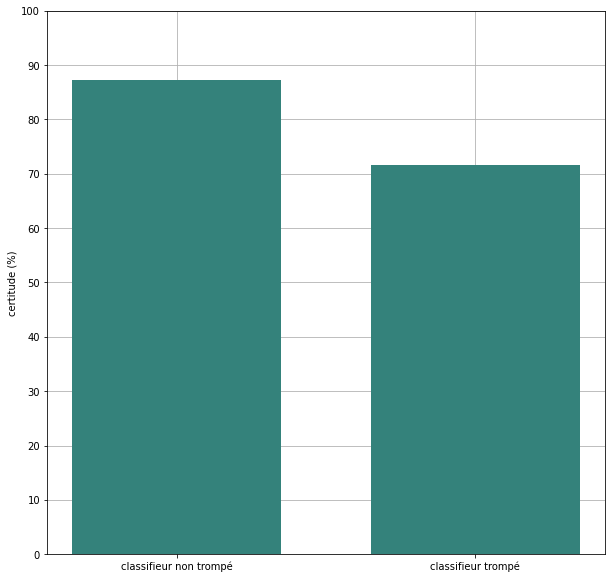

In [ ]:

plt.figure(figsize=(10,10))
plt.grid(zorder=0)
plt.yticks(np.arange(0, 110, 10))
plt.bar(["classifieur non trompé","classifieur trompé"],np.array([0.8727906877953757 ,0.7167274937221813 ])*100,0.7,zorder=3,color='#34827b')
plt.ylim(0,100)
plt.ylabel('certitude (%)')
plt.show()

#### Cross-Model Universality

In [ ]:
data_size = 10000
nb_class = 1000

model_to_test = [models.alexnet, models.googlenet, models.vgg19, models.resnet152]
model_to_test_name = ["alexnet", "googlenet", "vgg19", "resnet152"]


result = torch.load(os.path.join(save_path, "result_"+str(data_size)+"_IMAGENET"))
v = result[0]

device = ('cuda' if torch.cuda.is_available() else 'cpu')

for model_i in range(len(model_to_test)):
    torch.manual_seed(1)
    random.seed(1)
    np.random.seed(1)
    model, _, dataloader_test, _ = set_up_IMAGENET(train_size = 1, test_size = 10000, demonstration_size = 6, batch_size = 10, model_class = model_to_test[model_i])
    model = model.to(device)
    fooling_rate = 0
    for k, (image, _) in enumerate(dataloader_test):
        image = image.to(device)
        _, pred = torch.max(model(image),1)
        _, adv_pred = torch.max(model(image+v.unsqueeze(0).to(device)), 1)
        fooling_rate += torch.sum(pred!=adv_pred).detach()
    print(model_to_test_name[model_i], " fooling rate",fooling_rate/10000)
    

Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth


  0%|          | 0.00/233M [00:00<?, ?B/s]

alexnet  fooling rate tensor(0.3859, device='cuda:0')


Downloading: "https://download.pytorch.org/models/googlenet-1378be20.pth" to /root/.cache/torch/hub/checkpoints/googlenet-1378be20.pth


  0%|          | 0.00/49.7M [00:00<?, ?B/s]

googlenet  fooling rate tensor(0.3998, device='cuda:0')


Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

vgg19  fooling rate tensor(0.7360, device='cuda:0')


Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth


  0%|          | 0.00/230M [00:00<?, ?B/s]

resnet152  fooling rate tensor(0.3208, device='cuda:0')


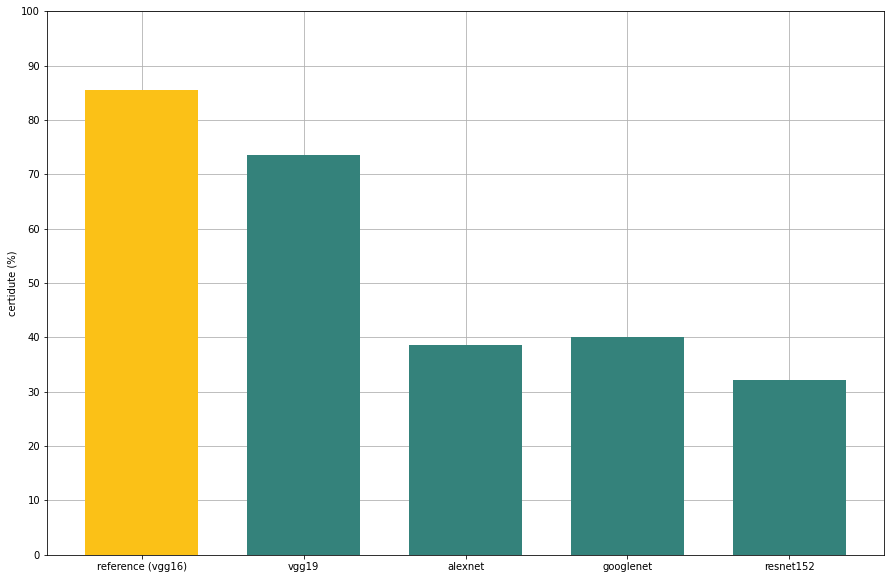

In [ ]:
plt.figure(figsize=(15,10))
plt.grid(zorder=0)
plt.yticks(np.arange(0, 110, 10))
plt.bar(["reference (vgg16)","vgg19", "alexnet","googlenet","resnet152"],np.array([0.8552, 0.7360, 0.3859, 0.3998, 0.3208 ])*100,0.7,zorder=3, color=['#fbc117', '#34827b', '#34827b', '#34827b', '#34827b'])
plt.ylim(0,100)
plt.ylabel('certidute (%)')
plt.show()

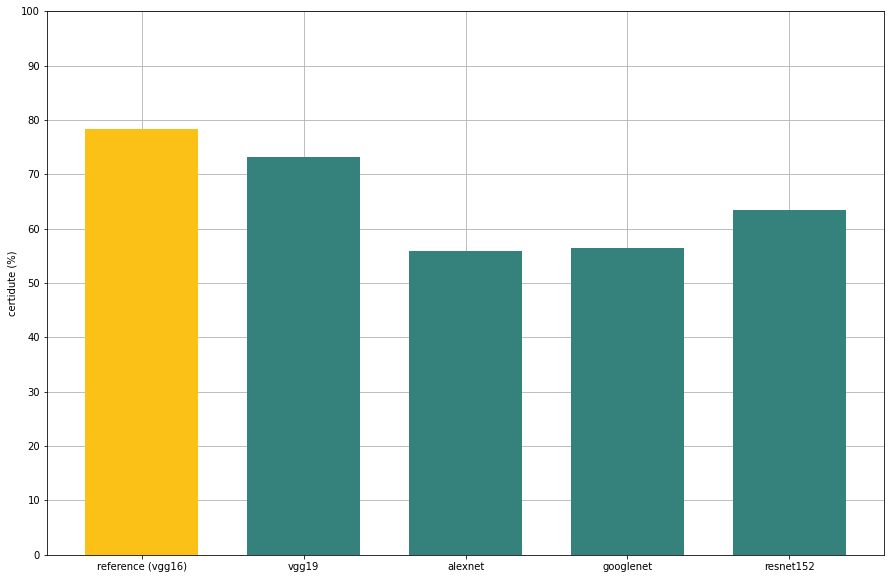

In [ ]:
plt.figure(figsize=(15,10))
plt.grid(zorder=0)
plt.yticks(np.arange(0, 110, 10))
plt.bar(["reference (vgg16)","vgg19", "alexnet","googlenet","resnet152"],np.array([0.783, 0.731, 0.558, 0.565, 0.634 ])*100,0.7,zorder=3, color=['#fbc117', '#34827b', '#34827b', '#34827b', '#34827b'])
plt.ylim(0,100)
plt.ylabel('certidute (%)')
plt.show()